This notebook is for testing whether a single limb-darkened disk solution would work on the LBTI data. Plan is:
- subtract all point sources in each image
- stack all the images
- do a single disk fit
- use that to figure out the lat-lon of the Emakong feature for each frame
- see if the lat-lon spread is large or small

In [96]:
import numpy as np
import matplotlib.pyplot as plt
import pickle
import paths
import copy
from astropy.io import fits
import astropy.units as u
from datetime import datetime, timedelta
from photutils.psf import (BasicPSFPhotometry, IterativelySubtractedPSFPhotometry, DAOGroup, FittableImageModel)
from photutils.detection import StarFinder
from astropy.convolution import convolve_models
from shift_stack_moons import chisq_stack
from astropy.modeling.fitting import (TRFLSQFitter, LMLSQFitter, DogBoxLSQFitter, SimplexLSQFitter, SLSQPLSQFitter)
from astropy.modeling.functional_models import Disk2D
from astroquery.jplhorizons import Horizons
from pylanetary.navigation import Nav
from scipy import signal
from pylanetary.utils import rebin

## load all the data

<class 'photutils.psf.models.EPSFModel'>
Name: EPSFModel (FittableImageModel)
N_inputs: 2
N_outputs: 1
Fittable parameters: ('flux', 'x_0', 'y_0')
SIMPLE True
BITPIX -64
NAXIS 3
NAXIS1 151
NAXIS2 151
NAXIS3 22
EXTEND True
COMMENT  FITS (Flexible Image Transport System) format is defined in 'Astronomy
 and Astrophysics', volume 376, page 359; bibcode: 2001A&A...376..359H
------------------------
Conditions
------------------------
------------------------
LBT AO
------------------------
------------------------
LBT Observatory
------------------------
------------------------
Motors
------------------------
------------------------
NIC Sensors
------------------------
------------------------
Phase
------------------------
------------------------
lmircam
------------------------
COMMENT  FITS (Flexible Image Transport System) format is defined in 'Astronomy
 and Astrophysics', volume 376, page 359; bibcode: 2001A&A...376..359H
------------------------
Conditions
-----------------------

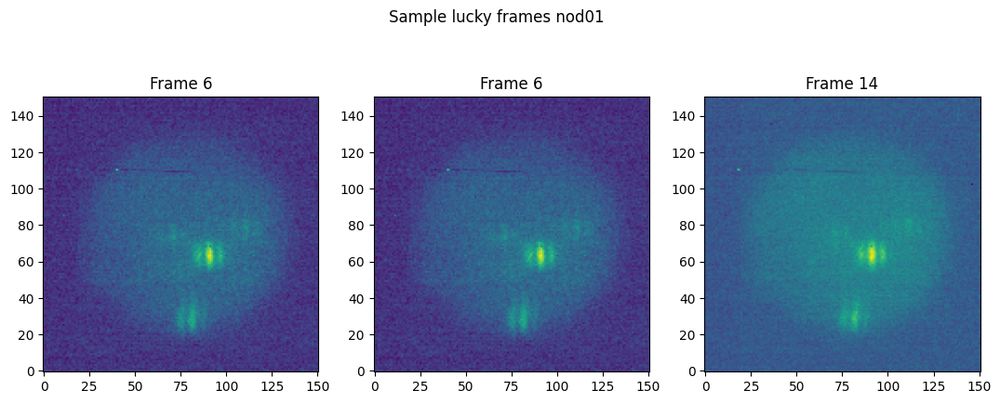

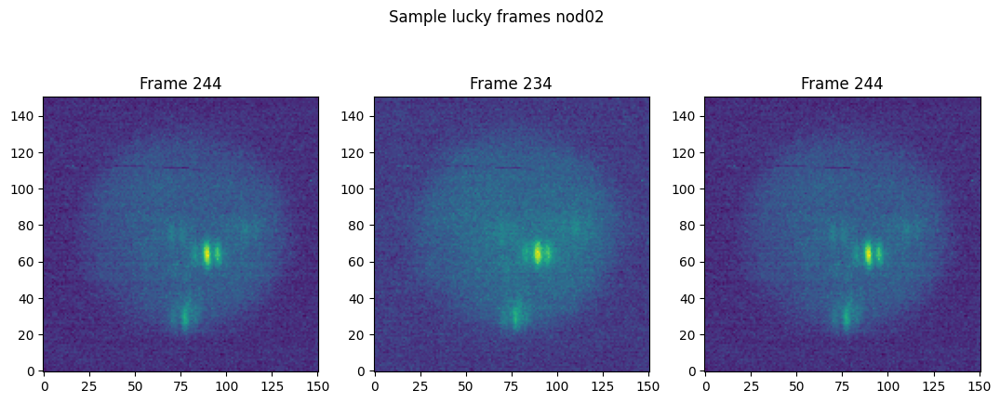

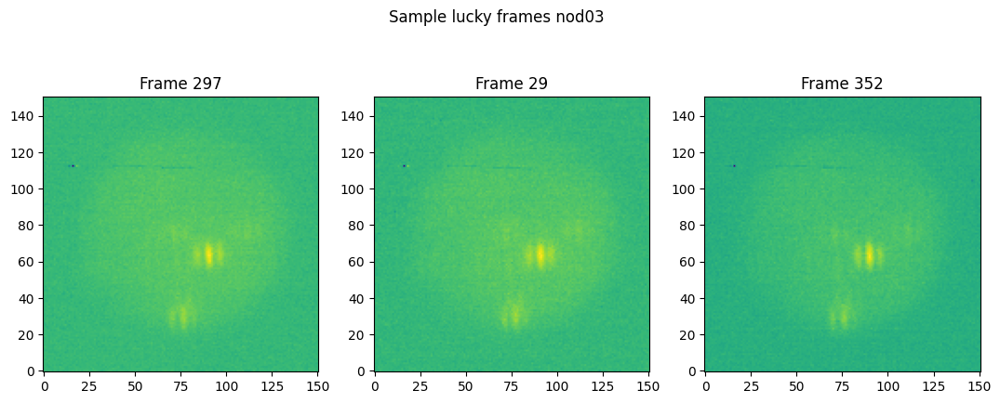

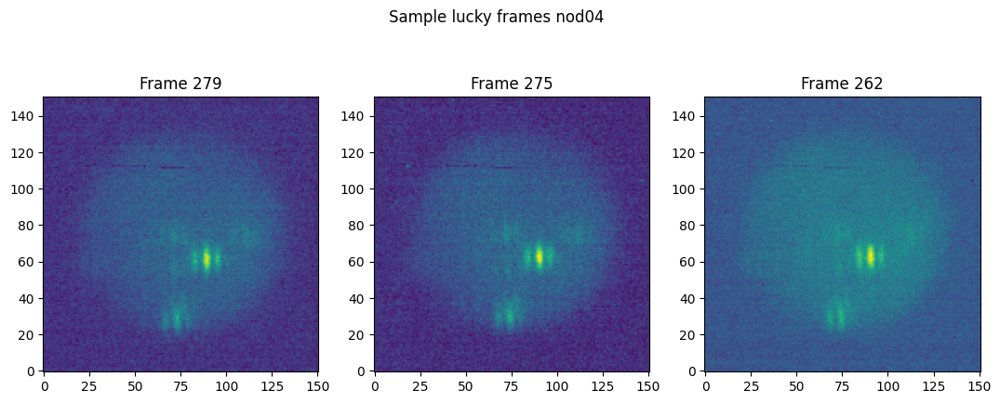

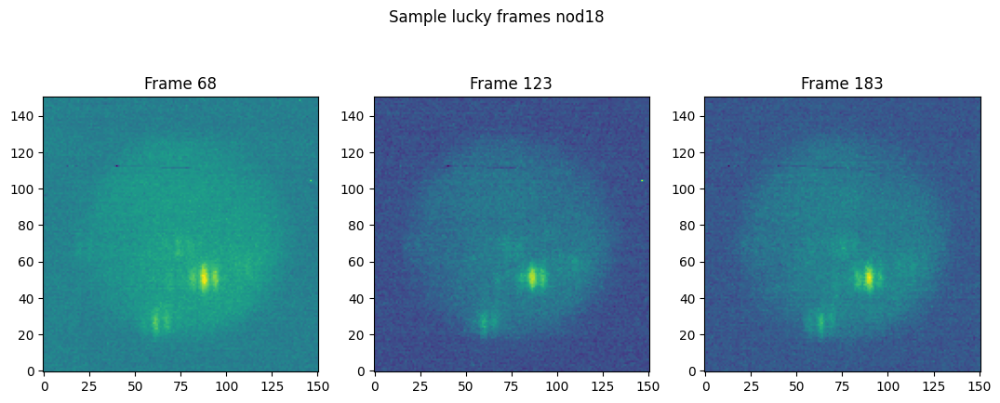

(22, 151, 151) (38, 151, 151)
2022-11-07 05:27:23


In [127]:
# PSF fittable model object from make-psf.ipynb
with open(paths.data / 'lbti' / 'psf_fittable_model.pkl', 'rb') as f:
    epsf = pickle.load(f)
print(type(epsf))

# load the data cube
io_hdul = fits.open(paths.data / 'lbti' / 'lucky_nav.fits')
io_data = io_hdul[0].data
io_header = io_hdul[0].header
#print(io_header)
for key in io_header:
    print(key, io_header[key])

# load the raw frames
frameids = ['01', '02', '03', '04', '18']

frames = []
lucky_frames = []
lucky_times = []
lucky_angles = []
for fid in frameids:
    stem = f'nod{fid}'

    # fits file of data frames
    hdul = fits.open(paths.data / 'lbti' / f'{stem}disk.fits')
    framesi = hdul[0].data
    hdr = hdul[0].header
    frames.append(framesi)

    # text file of lucky frames
    lucky_ids = np.loadtxt(paths.data / 'lbti' / f'{stem}log.txt', delimiter = ',').T[0].astype(int) - 1
    l_frames = framesi[lucky_ids]
    lucky_frames.append(l_frames)

    # plot some sample lucky frames
    fig, axes = plt.subplots(1,3, figsize = (13, 5))
    for ax in axes:
        i = np.random.choice(lucky_ids.size, replace = False)
        ax.imshow(l_frames[i], origin='lower')
        ax.set_title(f'Frame {lucky_ids[i]}')
    fig.suptitle(f'Sample lucky frames {stem}')
    plt.show()

    # text file of frame times
    frame_hours = []
    with open(paths.data / 'lbti' / f'{stem}utc.txt', 'r') as f:
        for l in f:
            seconds_utc = float(l[45:53])*3600
            time_utc = timedelta(seconds = seconds_utc)
            frame_hours.append(time_utc)
    obsdate = datetime.strptime(hdr['DATE-OBS'], '%Y-%m-%d')
    frame_times = np.array([obsdate + delta for delta in frame_hours])
    lucky_times.append(frame_times[lucky_ids])

    # text file of parallactic angles
    parallaxes = []
    with open(paths.data / 'lbti' / f'{stem}para.txt', 'r') as f:
        for l in f:
            parallaxes.append(float(l[45:53]))
    rotation_angles = np.array(parallaxes) #ccw
    lucky_angles.append(rotation_angles[lucky_ids])
    

frames = np.concatenate(frames)
#for i in range(20):
#    plt.imshow(frames[i], origin = 'lower')
#    plt.show()
lucky_frames = np.concatenate(lucky_frames)
lucky_times = np.concatenate(lucky_times)
lucky_angles = np.concatenate(lucky_angles)
np.save(paths.data / 'lbti' / 'lucky_angles.npy', lucky_angles)
np.save(paths.data / 'lbti' / 'lucky_times.npy', lucky_times)

# hack to make this all operate on the raw frames
print(io_data.shape, lucky_frames.shape)
io_data = lucky_frames

obstime = datetime.strptime(io_header['DATE-OBS']+io_header['TIME-OBS'][:-3], '%Y-%m-%d%H:%M:%S')
print(obstime)

# Find and subtract point sources

first subtract a disk that is close to correct to improve accuracy of what is and is not point source

(151, 151) (151, 151)


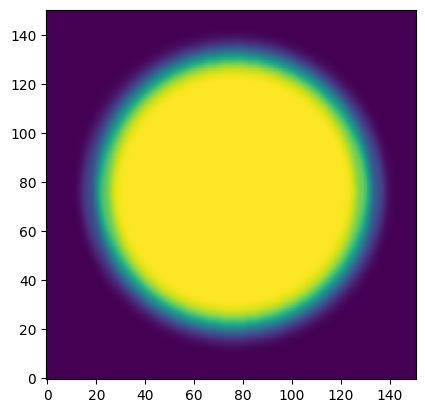

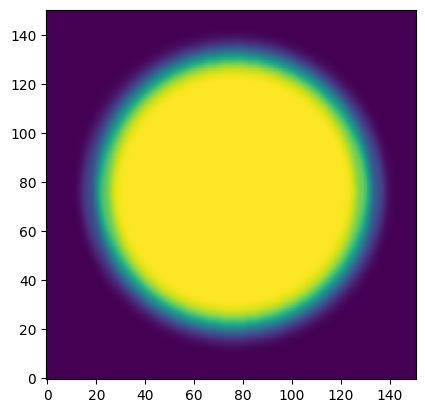

In [98]:
# determine radius of Io in pixels
io_r_km = 1821
pixscale_arcsec = 0.01071 #arcsec, lbti
data = io_data[0]

# call Horizons for the appropriate datetime
end_time = obstime + timedelta(minutes=1)
epochs = {'start':obstime.strftime('%Y-%m-%d %H:%M:%S'), 
          'stop':end_time.strftime('%Y-%m-%d %H:%M:%S'), 
          'step':'1m'}
# convert pixscale from arcsec to km
obj = Horizons(id='501', location='G83', epochs=epochs) #Io, Mt Graham
ephem = obj.ephemerides()
d_AU = ephem['delta'][0]*u.au
dist = d_AU.to(u.km).value
pixscale_km = dist*np.tan(np.deg2rad(pixscale_arcsec/3600.))

io_r_px = io_r_km / pixscale_km

# make a FittableModel object from the disk
disk_model = Disk2D(amplitude=15, x_0=0, y_0=0, R_0=io_r_px, fixed={'R_0':True})
disk_conv = convolve_models(disk_model, epsf)
#print(disk_conv)

# try turning this model into a FittableImageModel
sz = data.shape[0]/2
xx, yy = np.meshgrid(np.arange(-sz,sz), np.arange(-sz, sz))
print(xx.shape, data.shape)
disk_image = disk_conv(xx, yy)
plt.imshow(disk_image, origin='lower')
plt.show()

# new x,y grid here to hopefully agree with output from star finder
xx, yy = np.meshgrid(np.arange(data.shape[0]), np.arange(data.shape[1]))
disk_model = FittableImageModel(disk_image, normalize=False, origin = (0,0))
disk_model.flux = 15
disk_model.flux.min = 0.0
plt.imshow(disk_model(xx, yy), origin='lower')

Model: CompoundModel
Inputs: ('x', 'y')
Outputs: ('z',)
Model set size: 1
Expression: [0] + [1] + [2] + [3] + [4]
Components: 
    [0]: <FittableImageModel(flux=15., x_0=0., y_0=0.)>

    [1]: <EPSFModel(flux=9634.5829879, x_0=76.25447673, y_0=31.04989591)>

    [2]: <EPSFModel(flux=16768.27095581, x_0=90.82044905, y_0=61.3093915)>

    [3]: <EPSFModel(flux=11553.5946939, x_0=71.53658526, y_0=74.48856938)>

    [4]: <EPSFModel(flux=11268.38599566, x_0=111.51144188, y_0=74.63003802)>
Parameters:
    flux_0 x_0_0 y_0_0 ...       flux_4             x_0_4              y_0_4      
    ------ ----- ----- ... ------------------ ------------------ -----------------
      15.0   0.0   0.0 ... 11268.385995662955 111.51144187922303 74.63003801552924


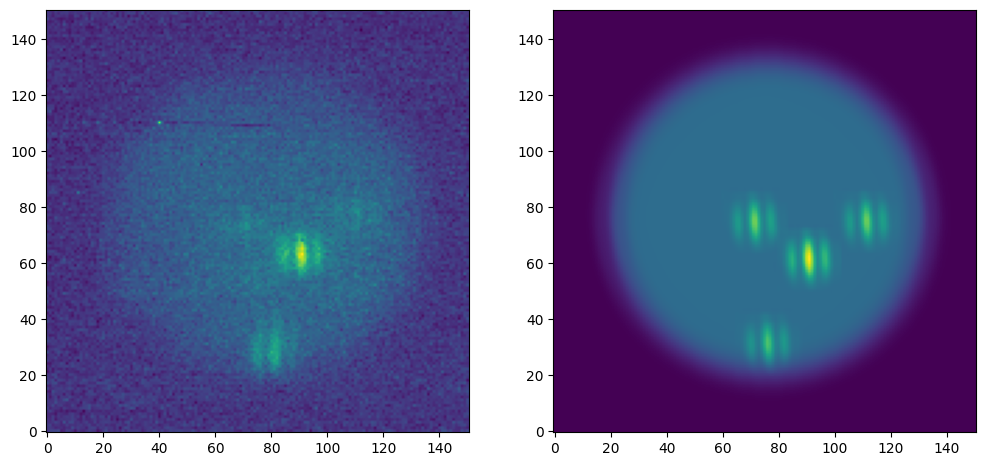

In [99]:
# find all the point sources by basic align and take mean
aligned_data = chisq_stack(io_data, showplot = True, edge_detect=False)
data_mean = np.mean(aligned_data, axis=0)
thresh = 0.9*np.std(data_mean)
star_finder = StarFinder(thresh, epsf.data) #threshold, kernel
sources = star_finder(data_mean)
#print(sources)

combined_model = disk_model
for i, src in enumerate(sources):
    star = copy.deepcopy(epsf)
    star.x_0 = src['xcentroid']
    star.y_0 = src['ycentroid']
    star.flux = src['flux']
    star.flux.min = 0.0
    combined_model += star
print(combined_model)

fig, (ax0, ax1) = plt.subplots(1,2, figsize = (12,6))
ax0.imshow(data, origin = 'lower')
ax1.imshow(combined_model(xx, yy), origin = 'lower')
plt.show()

## fit combined model to data

In [100]:
fitter = LMLSQFitter(calc_uncertainties=False)
y, x = np.mgrid[:data.shape[0], :data.shape[1]]
#output_model = fitter(combined_model, x, y, data, maxiter=2000)

starting frame 0


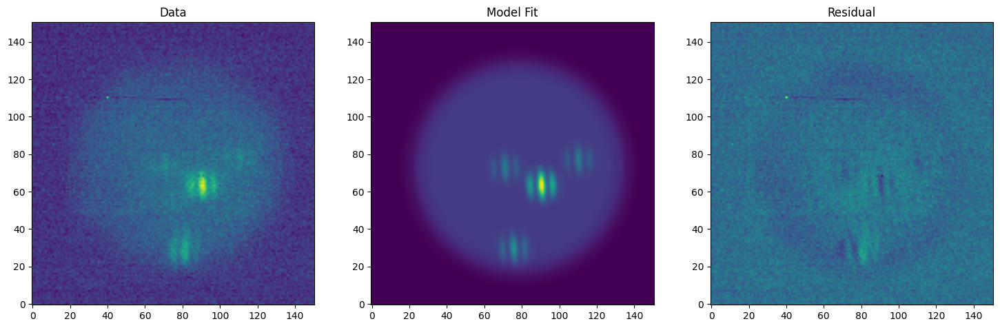

starting frame 1
starting frame 2
starting frame 3
starting frame 4


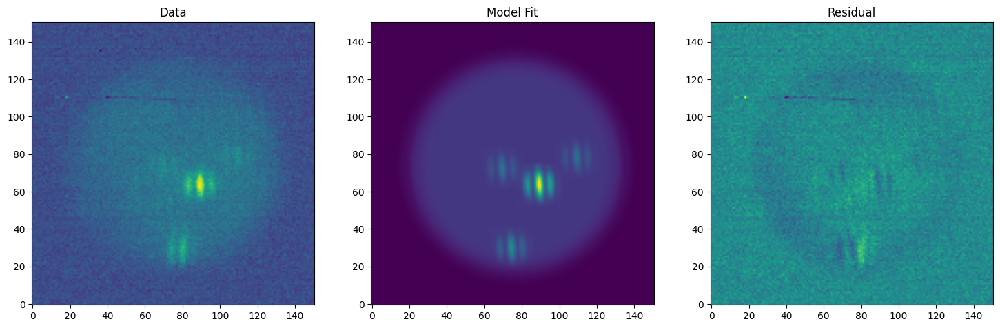

starting frame 5
starting frame 6
starting frame 7
starting frame 8


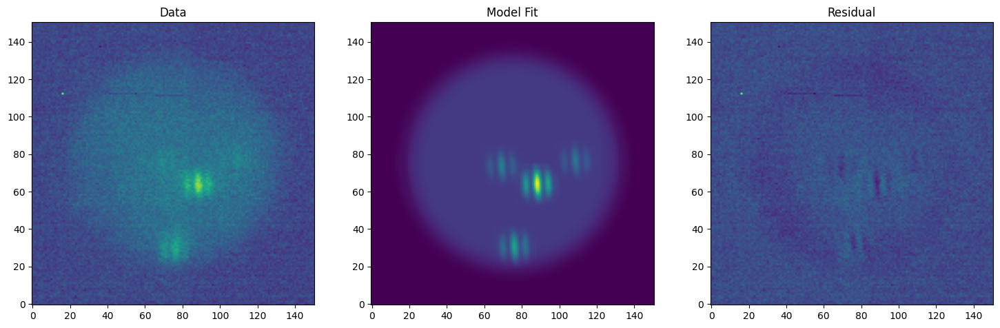

starting frame 9
starting frame 10
starting frame 11
starting frame 12


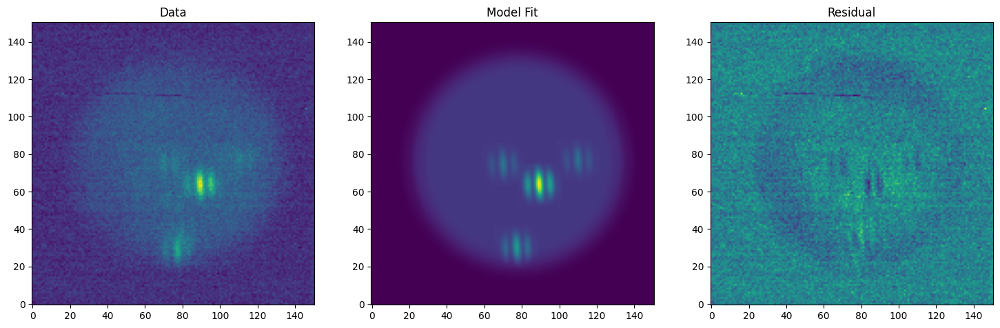

starting frame 13
starting frame 14
starting frame 15
starting frame 16


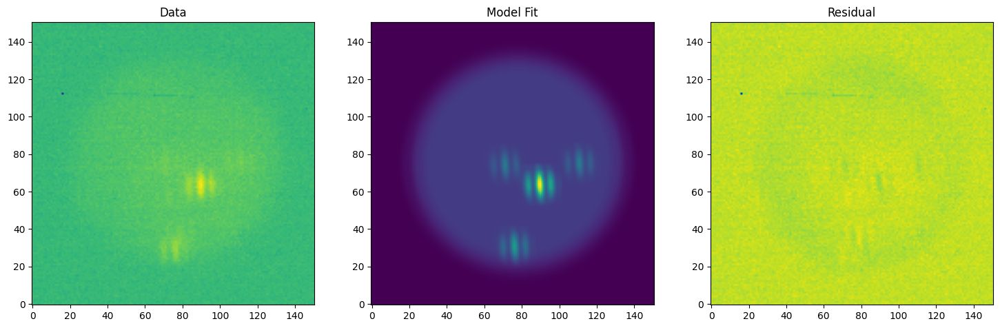

starting frame 17
starting frame 18
starting frame 19
starting frame 20


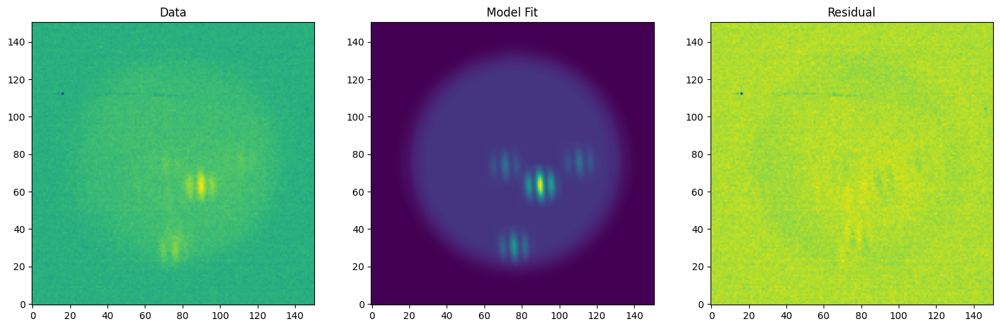

starting frame 21
starting frame 22
starting frame 23
starting frame 24


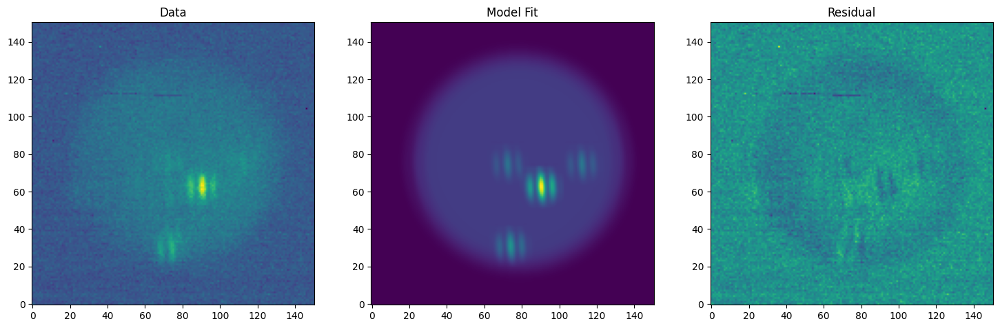

starting frame 25
starting frame 26
starting frame 27
starting frame 28


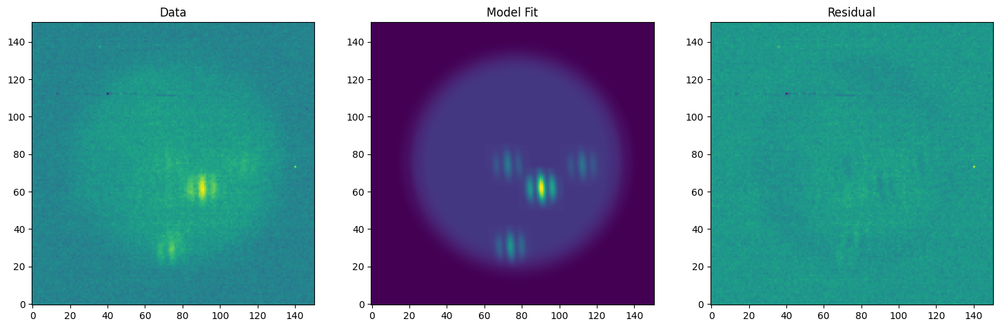

starting frame 29
starting frame 30
starting frame 31
starting frame 32


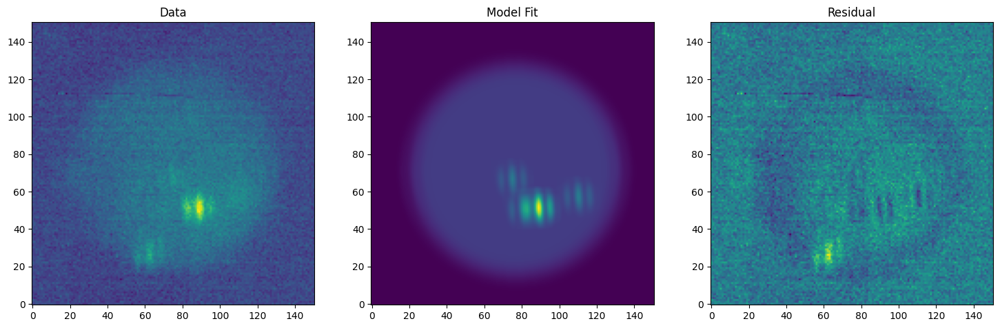

starting frame 33
starting frame 34
starting frame 35
starting frame 36


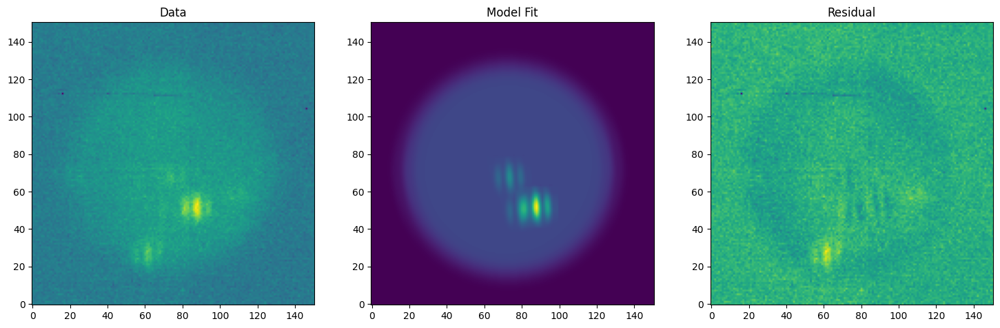

starting frame 37


In [101]:
## repeat for all the frames
output_models = []
for i in range(io_data.shape[0]):
    print(f'starting frame {i}')
    
    # find volcanoes
    combined_model = copy.deepcopy(disk_model)
    for j, src in enumerate(sources):
        star = copy.deepcopy(epsf)
        star.x_0 = src['xcentroid']
        star.y_0 = src['ycentroid']
        star.flux = src['flux']
        star.flux.min = 0.0
        combined_model += star
    
    output_model = fitter(combined_model, x, y, io_data[i], maxiter=2000)
    output_models.append(output_model)
    
    # make representative plots for a few of them
    if i%4 == 0:
        fig, (ax0, ax1, ax2) = plt.subplots(1,3, figsize=(18, 6))
        ax0.imshow(io_data[i], origin = 'lower')
        ax0.set_title('Data')
        ax1.imshow(output_model(xx, yy), origin = 'lower')
        ax1.set_title('Model Fit')
        ax2.imshow(io_data[i] - output_model(xx, yy), origin='lower')
        ax2.set_title('Residual')
        plt.show()

## subtract point sources in model from original image to find mean disk

[<CompoundModel(flux_0=0.91575989, x_0_0=2.57743663, y_0_0=-3.47039492, flux_1=1046.69986059, x_0_1=75.78968197, y_0_1=29.33753209, flux_2=2759.90319995, x_0_2=90.59640665, y_0_2=63.16269347, flux_3=766.69559415, x_0_3=71.08739765, y_0_3=72.33416581, flux_4=771.05143489, x_0_4=110.35487128, y_0_4=76.59182856)>, <CompoundModel(flux_0=0.811559, x_0_0=0.57972209, y_0_0=-3.70274668, flux_1=1074.39150795, x_0_1=75.25718966, y_0_1=29.77195566, flux_2=2788.31031318, x_0_2=89.65040427, y_0_2=62.71965081, flux_3=841.76855215, x_0_3=70.15372487, y_0_3=71.68115255, flux_4=668.35750489, x_0_4=109.42335786, y_0_4=76.1430924)>, <CompoundModel(flux_0=1.08627027, x_0_0=4.09635907, y_0_0=-2.19009707, flux_1=995.92740732, x_0_1=76.81147779, y_0_1=30.00114937, flux_2=2907.68804792, x_0_2=91.25227476, y_0_2=63.59717641, flux_3=691.5254213, x_0_3=71.52133162, y_0_3=72.39421065, flux_4=787.98046681, x_0_4=111.0257682, y_0_4=78.2830018)>, <CompoundModel(flux_0=0.87074361, x_0_0=1.05952445, y_0_0=-2.2280832, 

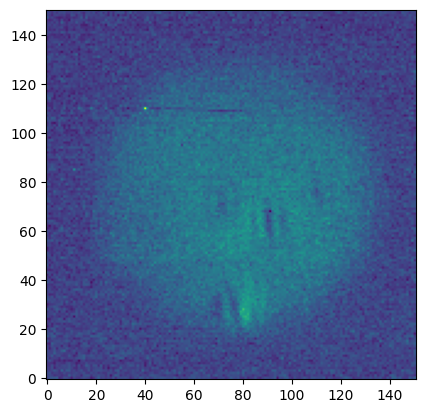

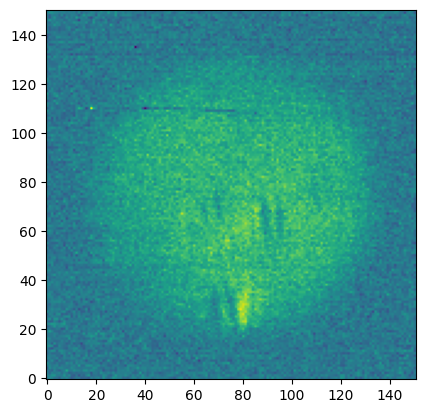

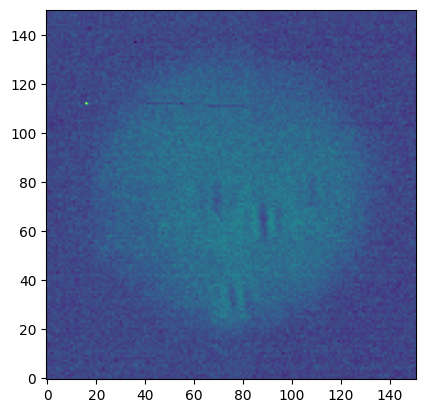

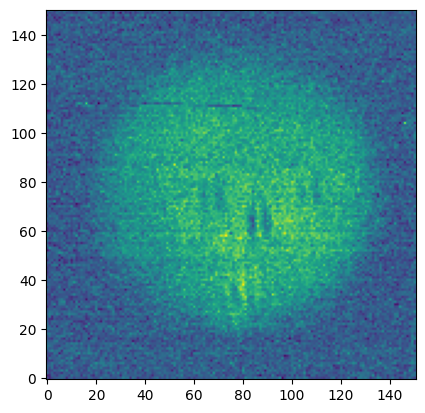

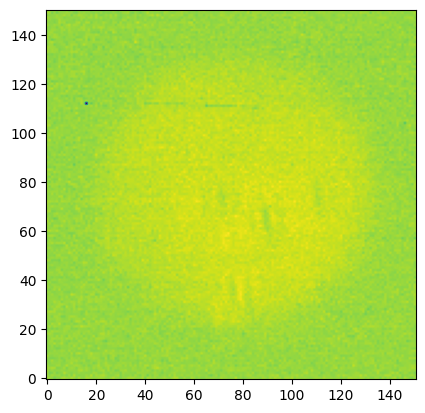

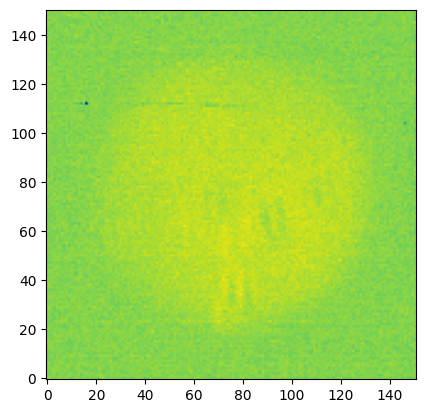

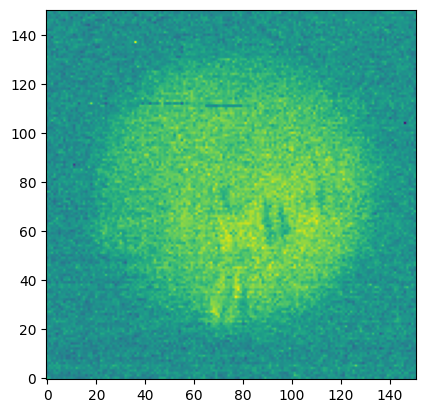

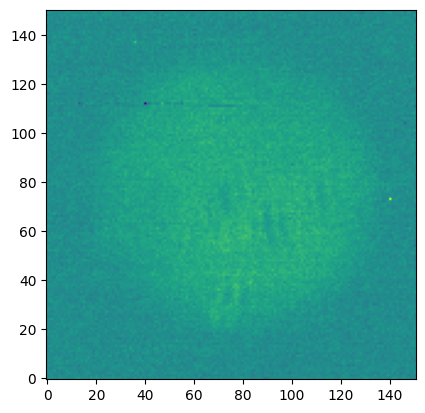

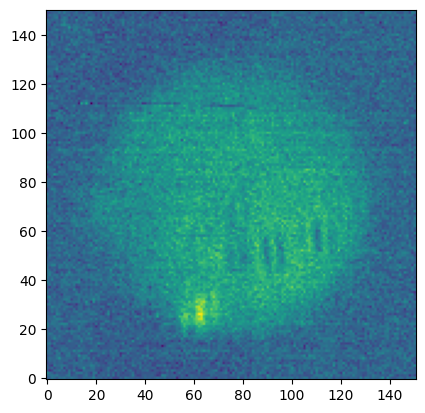

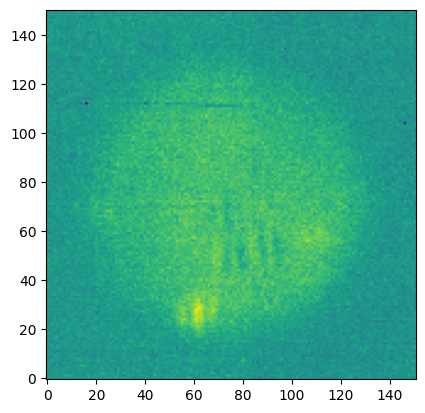

In [102]:
print(output_models)
combined_disk = np.zeros(io_data.shape)
source_subtracted_disks = []
for i, flux_model in enumerate(output_models):
    
    frame = io_data[i]
    point_sources = flux_model - flux_model[0]#flux_model[1] + flux_model[2] + flux_model[3] + flux_model[4] + flux_model[5] #for some reason slicing is failing
    model = point_sources(xx, yy)
    diff = frame - model
    source_subtracted_disks.append(diff)
    combined_disk[i] = diff
    
    if i % 4 == 0:
        plt.imshow(diff, origin = 'lower')
        plt.show()
    

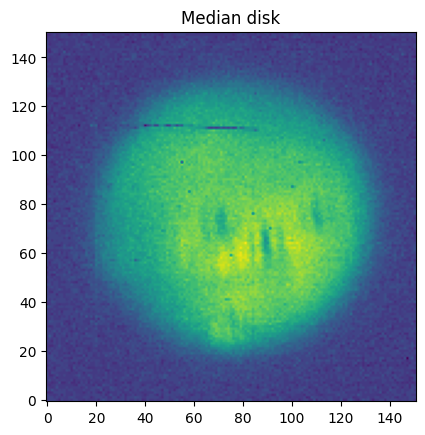

In [103]:
combined_disk = np.median(combined_disk, axis = 0)
plt.imshow(combined_disk, origin = 'lower')
plt.title('Median disk')
plt.show()

## single solution for disk

limb-darkened disk model

2022-11-07 04:18:14.040000
(151, 151) (151, 151) (25, 25)


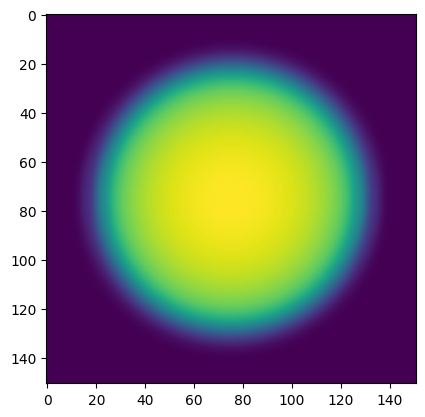

In [104]:
from pylanetary.utils import Body
from pylanetary.utils import rebin, convolve_with_beam
from scipy.ndimage import zoom
pixscale_arcsec = 0.01071 #arcsec, lbti
a = 0.5 # exponential limb-darkening law exponent
fwhm = 0.1 # approximate FWHM of the point-spread function in arcsec
print(lucky_times[0])
io = Body('Io', epoch=lucky_times[0], location='G83')
single_disk_nav = Nav(combined_disk, io, pixscale_arcsec)
single_ldmodel = single_disk_nav.ldmodel(1.0, a, law='exp')

print(single_ldmodel.shape, combined_disk.shape, epsf.data.shape)
#single_ldmodel = rebin(single_ldmodel, 1/3)
single_ldmodel = convolve_with_beam(single_ldmodel, epsf.data)


lddisk_model = FittableImageModel(single_ldmodel, normalize=False, origin = (0,0))
lddisk_model.flux = 15
lddisk_model.flux.min = 0.0

#plt.imshow(lddisk_model(xx,yy), origin = 'lower')
plt.imshow(single_ldmodel)
plt.show()

Model: FittableImageModel
Inputs: ('x', 'y')
Outputs: ('z',)
Model set size: 1
Parameters:
           flux               x_0                y_0        
    ------------------ ----------------- -------------------
    16.554682883908953 2.704970615987243 -1.3413586242769082


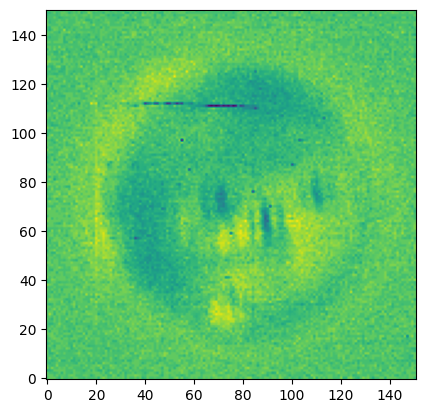

In [105]:
#print(disk_model)

disk_out = fitter(lddisk_model, x, y, combined_disk, maxiter=2000)
print(disk_out)

model_disk_image = disk_out(xx, yy)
plt.imshow(combined_disk - model_disk_image, origin = 'lower')
plt.show()

## Find Emakong location assuming this location

8.114911847961729 -4.024075872830725
starting frame 0


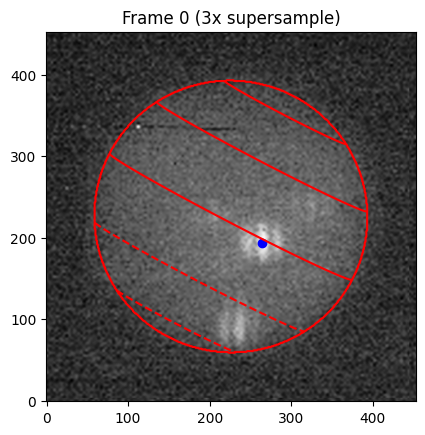

starting frame 1
starting frame 2


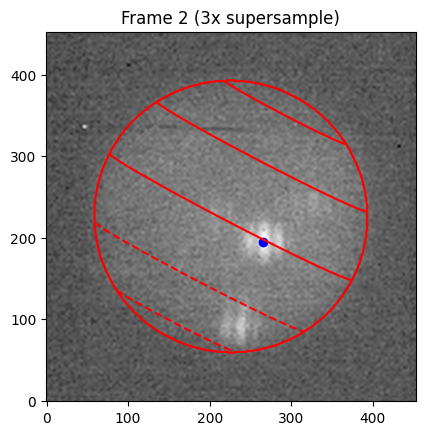

starting frame 3
starting frame 4


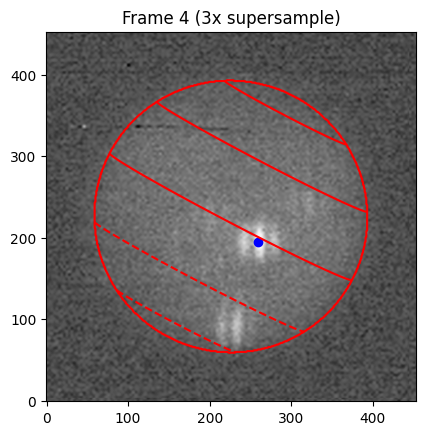

starting frame 5
starting frame 6


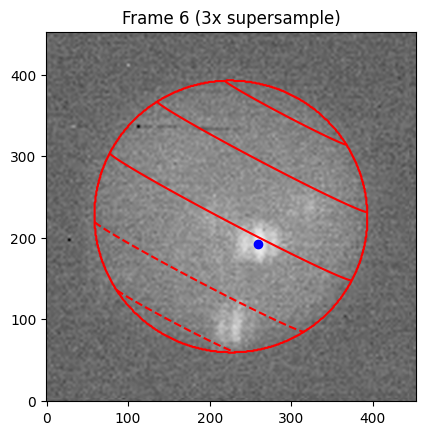

starting frame 7
starting frame 8


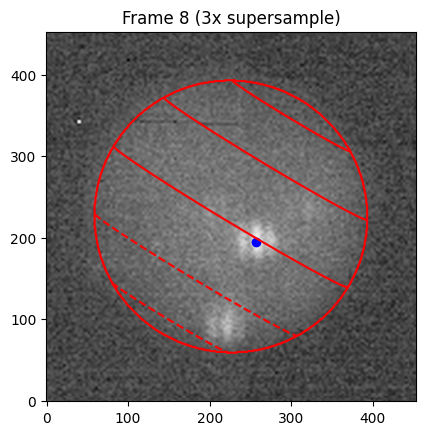

starting frame 9
starting frame 10


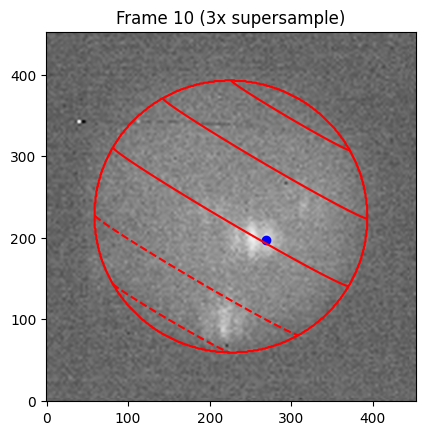

starting frame 11
starting frame 12


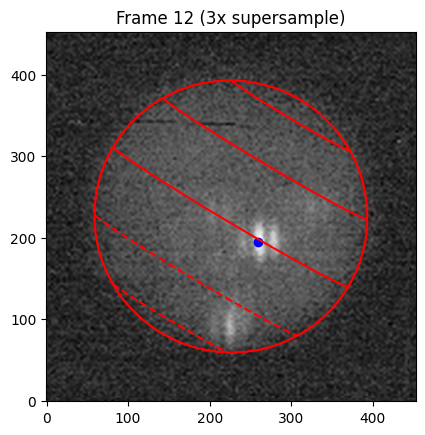

starting frame 13
starting frame 14


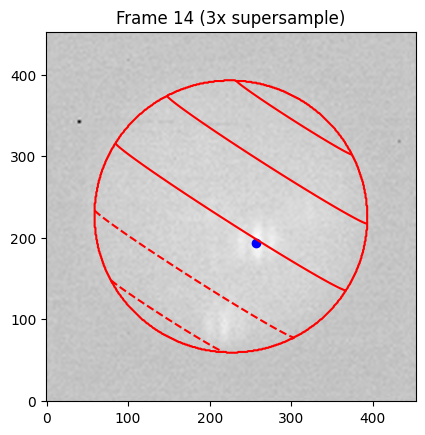

starting frame 15
starting frame 16


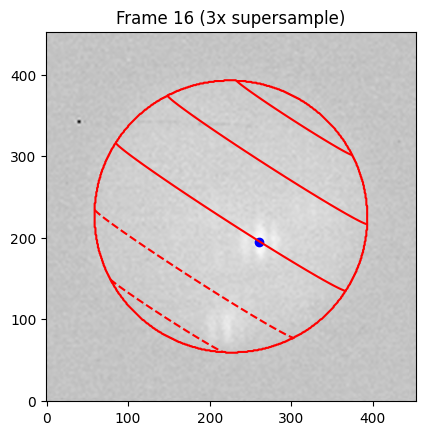

starting frame 17
starting frame 18


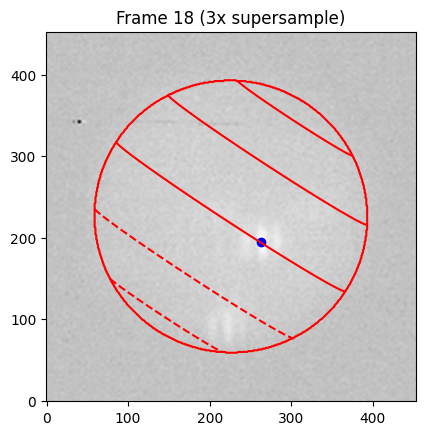

starting frame 19
starting frame 20


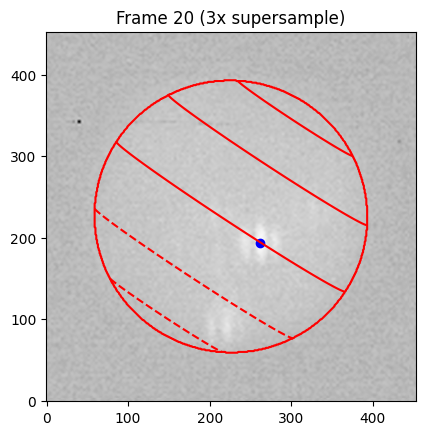

starting frame 21
starting frame 22


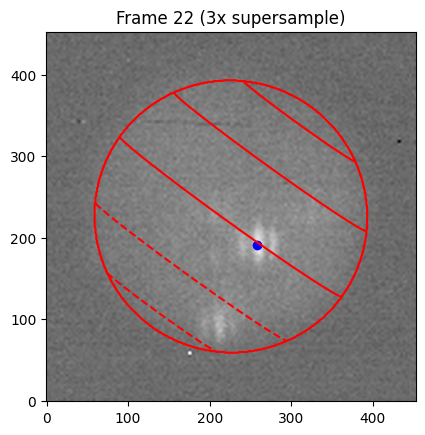

starting frame 23
starting frame 24


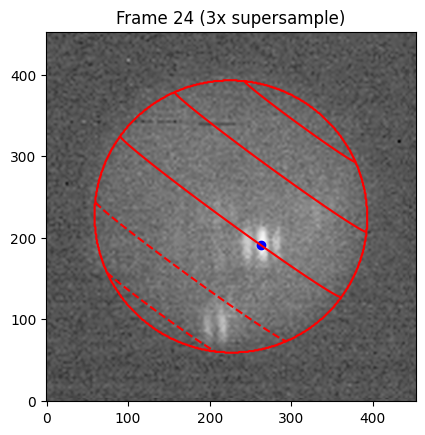

starting frame 25
starting frame 26


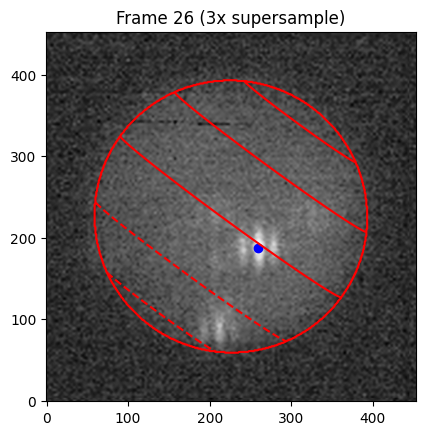

starting frame 27
starting frame 28


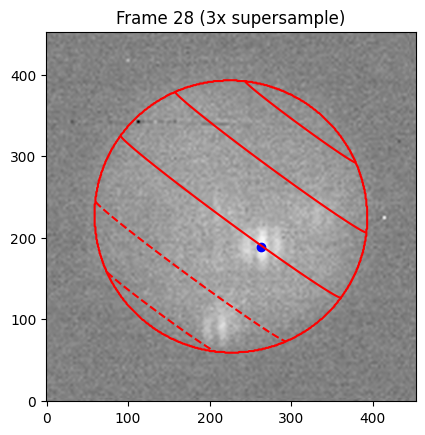

starting frame 29
starting frame 30


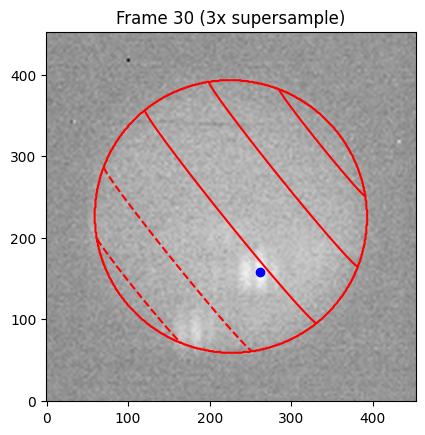

starting frame 31
starting frame 32


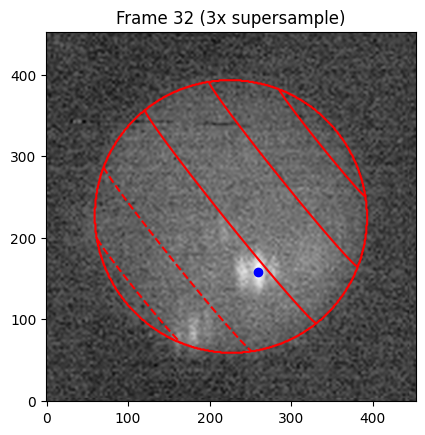

starting frame 33
starting frame 34


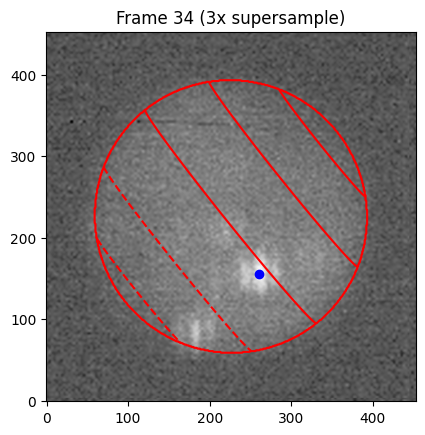

starting frame 35
starting frame 36


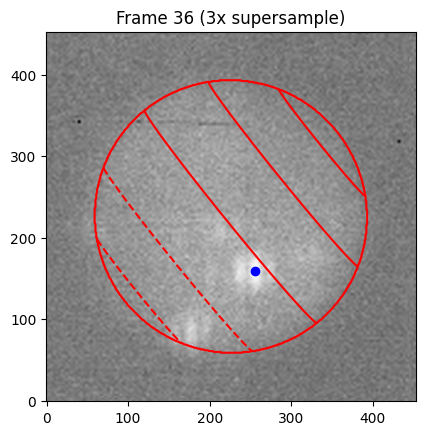

starting frame 37


In [106]:
from pylanetary.navigation import *
from scipy.ndimage import zoom
pixscale_arcsec = 0.01071 #arcsec, lbti
z = 3

x0, y0 = disk_out.x_0, disk_out.y_0
dx, dy = x0*z, y0*z
print(dx, dy)

rmsvals = []
emakong_lat = []
emakong_lon = []
for i, obstime in enumerate(lucky_times):
    
    print(f'starting frame {i}')
    frame = io_data[i]
    angle = lucky_angles[i]
    output_model = output_models[i]
    
    ## new planetnav workflow
    io = Body('Io', epoch=obstime, location='G83') #Keck
    # adjust north pole angle according to parallactic angle
    npang = io.ephem['NPole_ang']
    io.ephem['NPole_ang'] = (npang - angle)%360
    frame_z = zoom(frame, z)
    nav = Nav(frame_z, io, pixscale_arcsec/z)
    
    # shift data to the center
    nav.xy_shift_data(-dx, -dy)
    
    # find per-frame rms noise
    n = 20
    err_region = np.concatenate([frame[:n, :n].flatten(),
                           frame[-n:, :n].flatten(),
                           frame[:n, -n:].flatten(),
                           frame[-n:, -n:].flatten(),])
    rms_noise = np.std(err_region)
    rmsvals.append(rms_noise)
    
    # extract Emakong location from old model, then put it on super-res grid
    emakong_idx = np.argmax([m.flux.value for m in output_model])
    dxe = output_model[emakong_idx].x_0.value * z - dx
    dye = output_model[emakong_idx].y_0.value * z - dy
    
    # extract lat-lon of Emakong
    emakong_lat.append(nav.lat_g[int(dye), int(dxe)])
    emakong_lon.append(nav.lon_w[int(dye), int(dxe)])
    
    # sanity check plot
    if i%2 == 0:
        circ = np.ones(nav.lon_w.shape)
        circ[np.isnan(nav.lon_w)] = -999
        plt.imshow(nav.data, origin='lower', cmap='Greys_r')
        plt.scatter(dxe, dye, color='blue')
        plt.contour(circ, levels = [0], colors='red')
        plt.contour(nav.lat_g, levels = np.linspace(-90, 90, 7), colors='red')
        plt.title(f'Frame {i} ({z}x supersample)')
        plt.show()

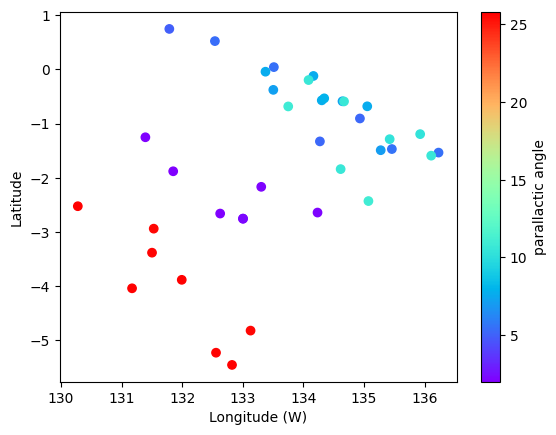

In [107]:
colors = np.copy(lucky_angles)
#colors[lucky_angles > 10] = lucky_angles[lucky_angles > 10] - 16

sc = plt.scatter(emakong_lon, emakong_lat, c=colors, cmap = 'rainbow')
plt.colorbar(sc, label='parallactic angle')
plt.xlabel('Longitude (W)')
plt.ylabel('Latitude')
plt.show()

Single combined disk location solution.
something is systematically wrong nod-by-nod. Observations:
- Pretty clear separation between nods in the NW/SE direction, but not directly correlated with time
- Elongation within a single nod in the NE/SW direction
- Within-nod elongation seems to change orientation for each of the five nods

Ideas:
- angle accounting is not correct.  But if this were true, then expect linear correlation with time.
- location of disk changes nod-by-nod but not frame-by-frame
- model the transfer function to determine if Emakong is resolved
- FT the Emakong feature, another feature on the disk, and the PSF to see if the amplitudes are the same. this might tell you if Emakong is resolved

Plans:
- Try one fit to limb-darkened disk per nod

## make one disk solution per nod

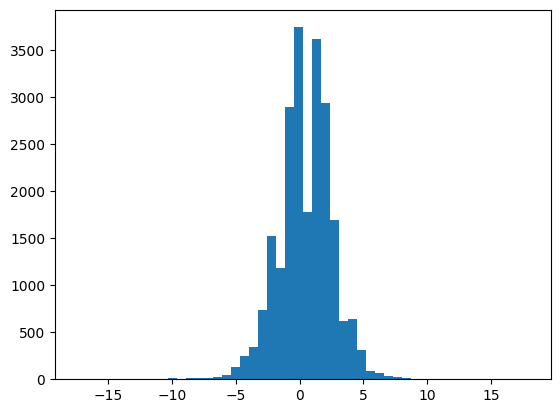

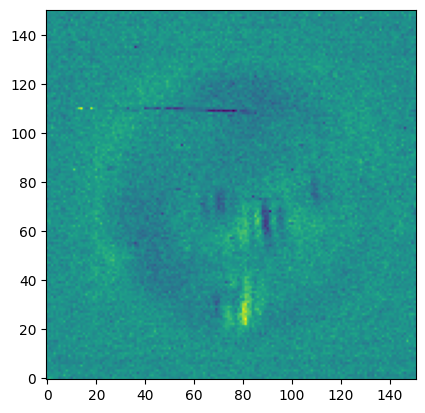

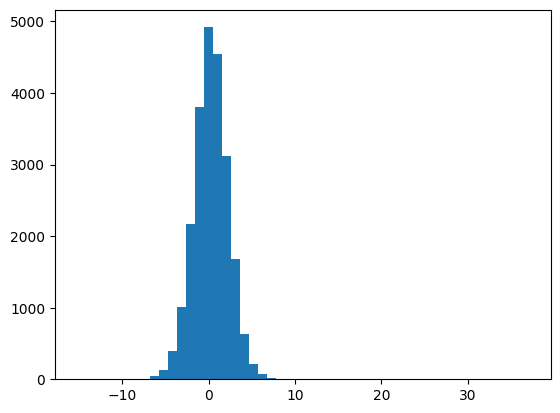

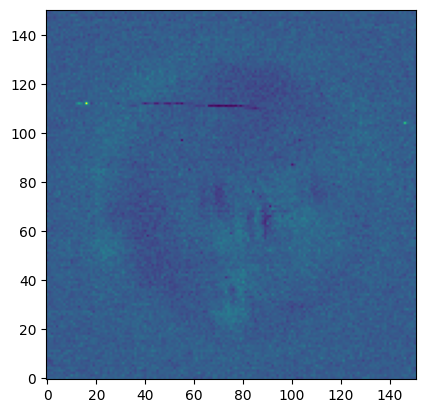

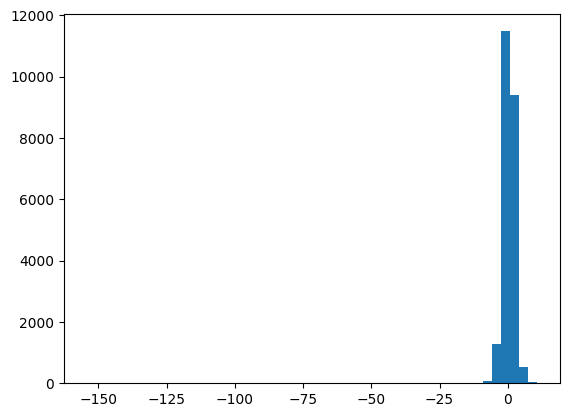

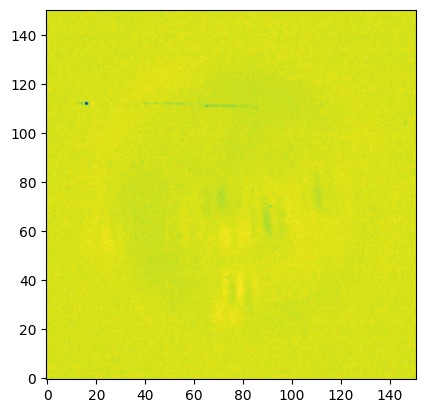

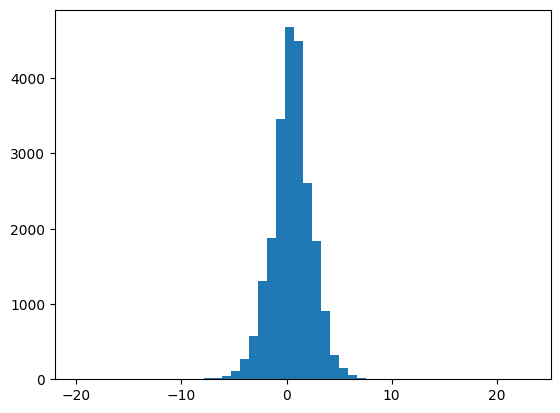

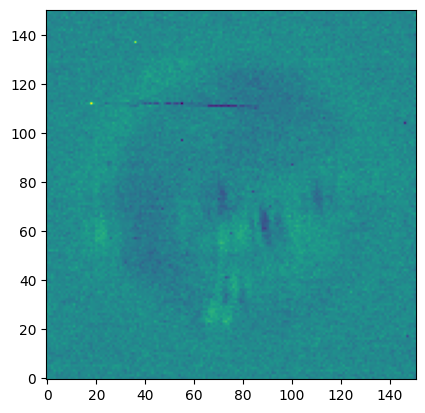

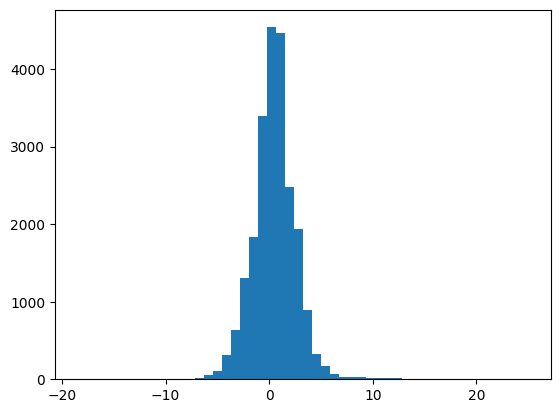

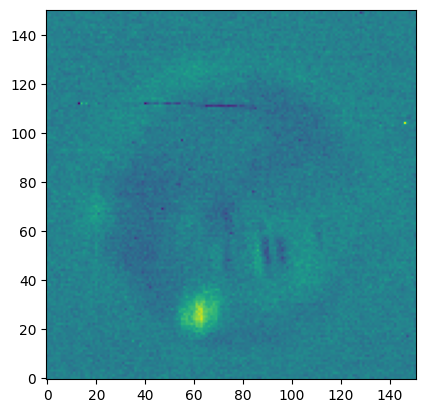

In [108]:
lucky_angle_diff = lucky_angles[1:] - lucky_angles[:-1]
nod_indices = np.argwhere(lucky_angle_diff > 1).flatten()+1
nod_indices = np.append(nod_indices, lucky_angles.size)
nod_indices = np.insert(nod_indices, 0, 0)

x0 = np.ones(lucky_angles.shape)
y0 = np.ones(lucky_angles.shape)
flux0 = np.ones(lucky_angles.shape)
for i in range(len(nod_indices) - 1):
    disk_data = np.array([disk.data for disk in source_subtracted_disks[nod_indices[i]:nod_indices[i+1]]])
    disk_med = np.median(disk_data, axis = 0)
    
    # fit
    output_model = fitter(lddisk_model, x, y, disk_med, maxiter=2000)
    
    # output x and y
    x0[nod_indices[i]:nod_indices[i+1]]*=output_model.x_0
    y0[nod_indices[i]:nod_indices[i+1]]*=output_model.y_0
    flux0[nod_indices[i]:nod_indices[i+1]]*=output_model.flux
    
    # check
    diff = disk_med - output_model(xx, yy)
    plt.hist(diff.flatten(), bins = 50)
    plt.show()
    plt.imshow(diff, origin = 'lower')
    plt.show()
     

## Find Emakong location again

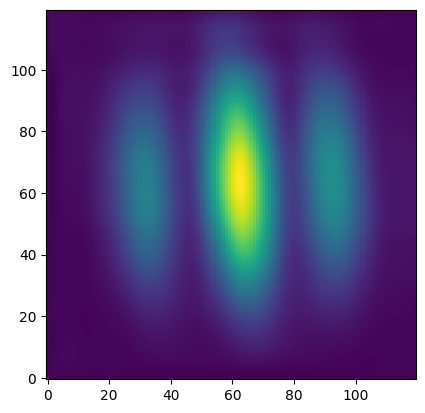

[15.9219676  15.9219676  15.9219676  15.9219676  15.9219676  15.9219676
 15.9219676  15.36828893 15.36828893 15.36828893 15.36828893 15.36828893
 15.36828893 15.36828893 16.54162501 16.54162501 16.54162501 16.54162501
 16.54162501 16.54162501 16.54162501 16.54162501 11.91442669 11.91442669
 11.91442669 11.91442669 11.91442669 11.91442669 11.91442669 11.91442669
  6.71974061  6.71974061  6.71974061  6.71974061  6.71974061  6.71974061
  6.71974061  6.71974061]


In [109]:
### TO DO: check if the PSF is getting fit right side up, or 90 degrees sideways!!
### this idea is based on the seemingly strange indexing of epsf with mgrid
### I think I can just change fitter(epsf_z, a, b, diff) to fitter(epsf_z, b, a, diff) to check this

## find Emakong location assuming this location
z = 5

dx, dy = x0*z, y0*z

# make a zoomed version of the PSF FittableImageModel
aa, bb = np.mgrid[-12:12, -12:12]
epsf_image = epsf(bb, aa)

#plt.imshow(epsf_image[:,9:16], origin = 'lower')
#plt.xlim([9,15])
#plt.show()

#epsf_image = epsf_image[:,9:16]
epsf_z = FittableImageModel(zoom(epsf_image, z), normalize=True)

aaz, bbz = np.mgrid[-12*z:12*z, -12*z:12*z]
plt.imshow(epsf_z(bbz, aaz), origin = 'lower')
plt.show()

print(dx)

starting frame 0


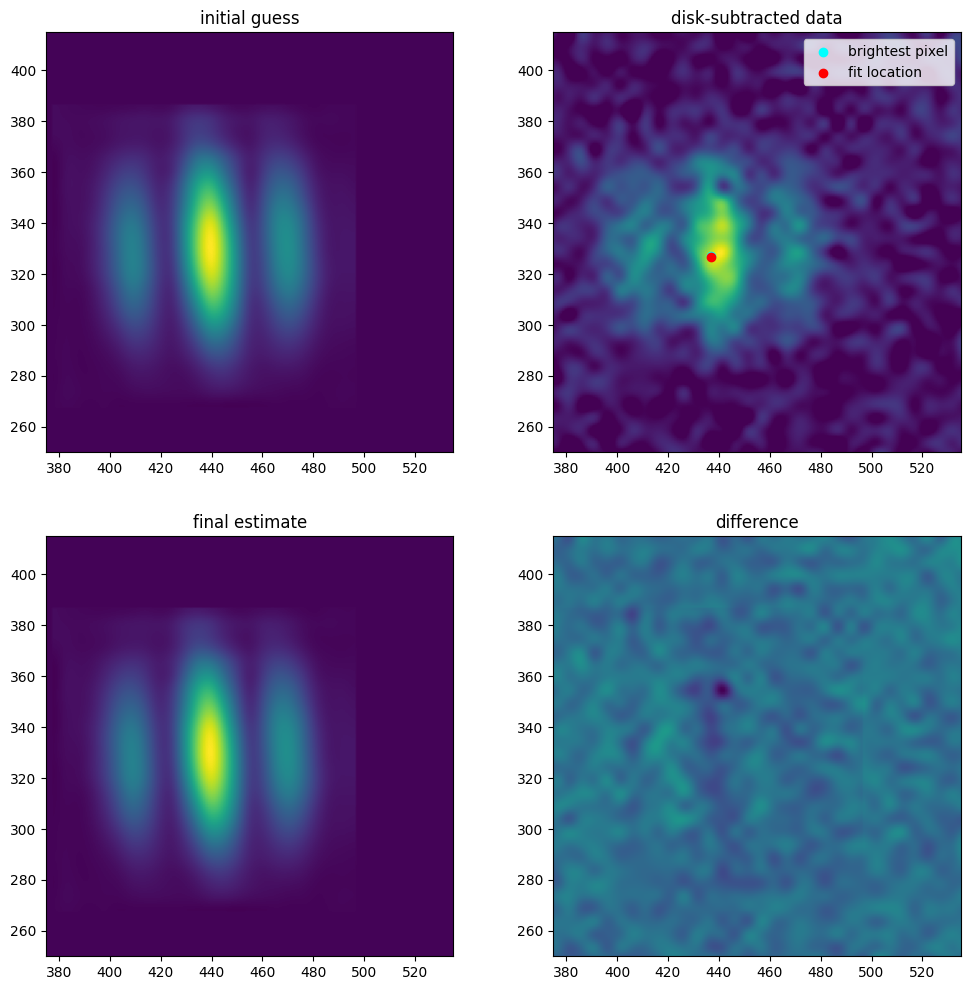

starting frame 1


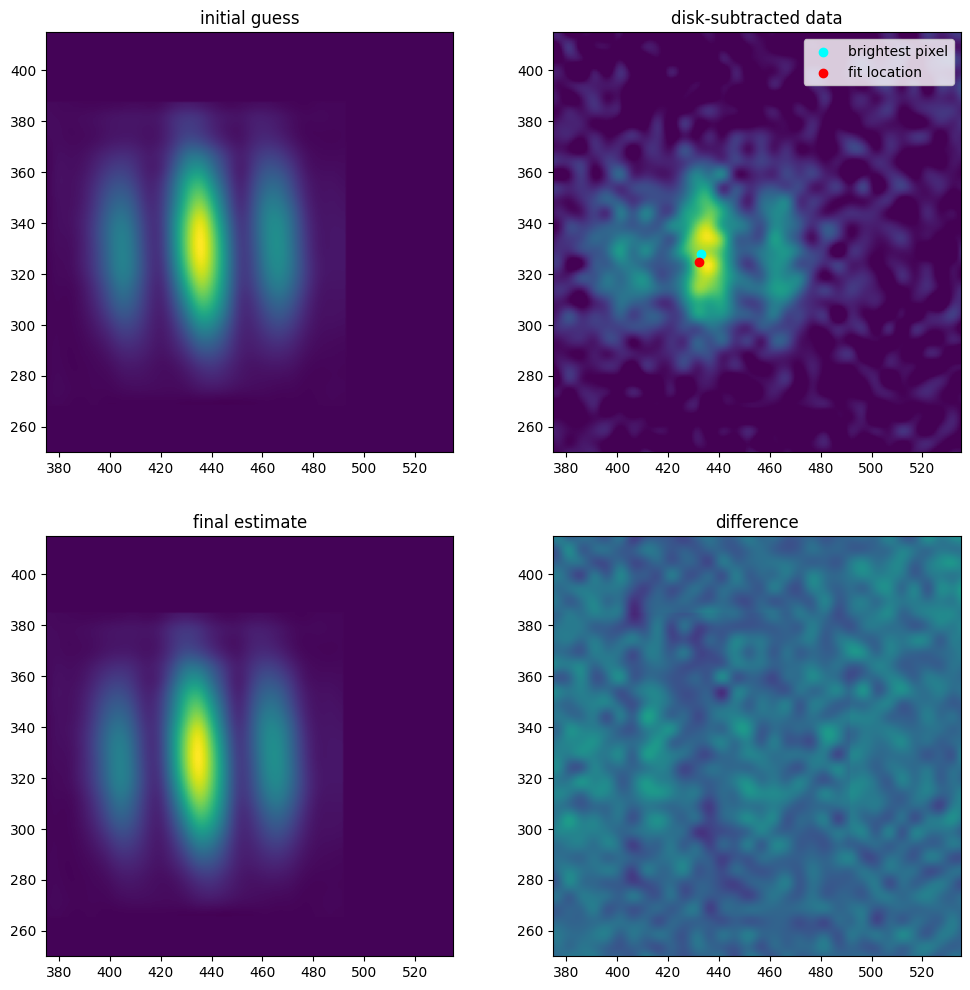

starting frame 2


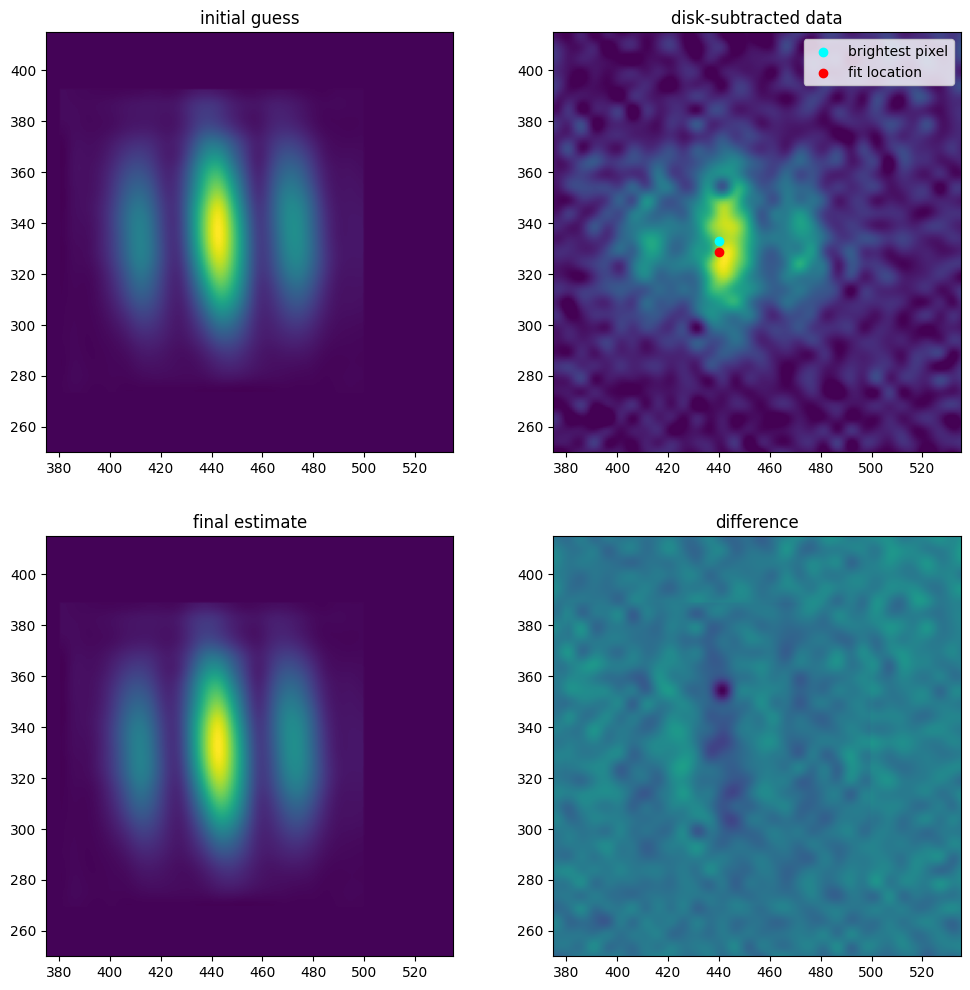

starting frame 3


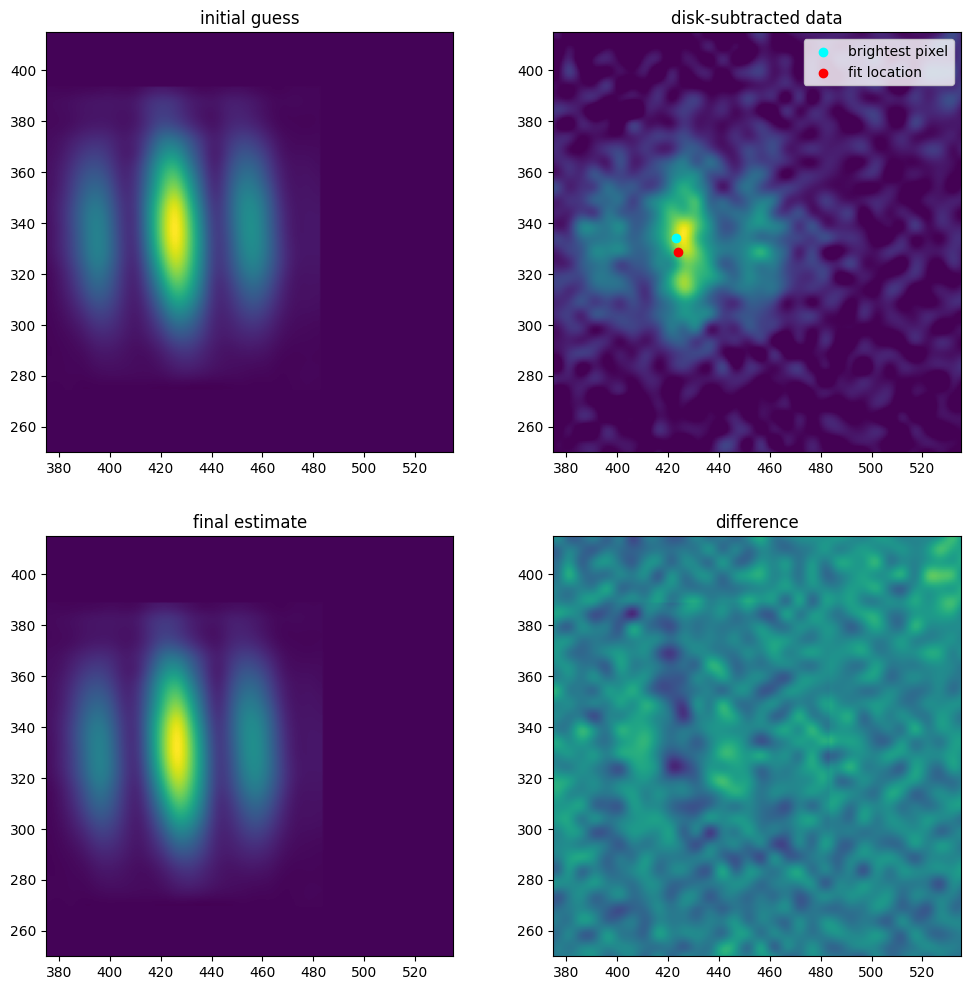

starting frame 4


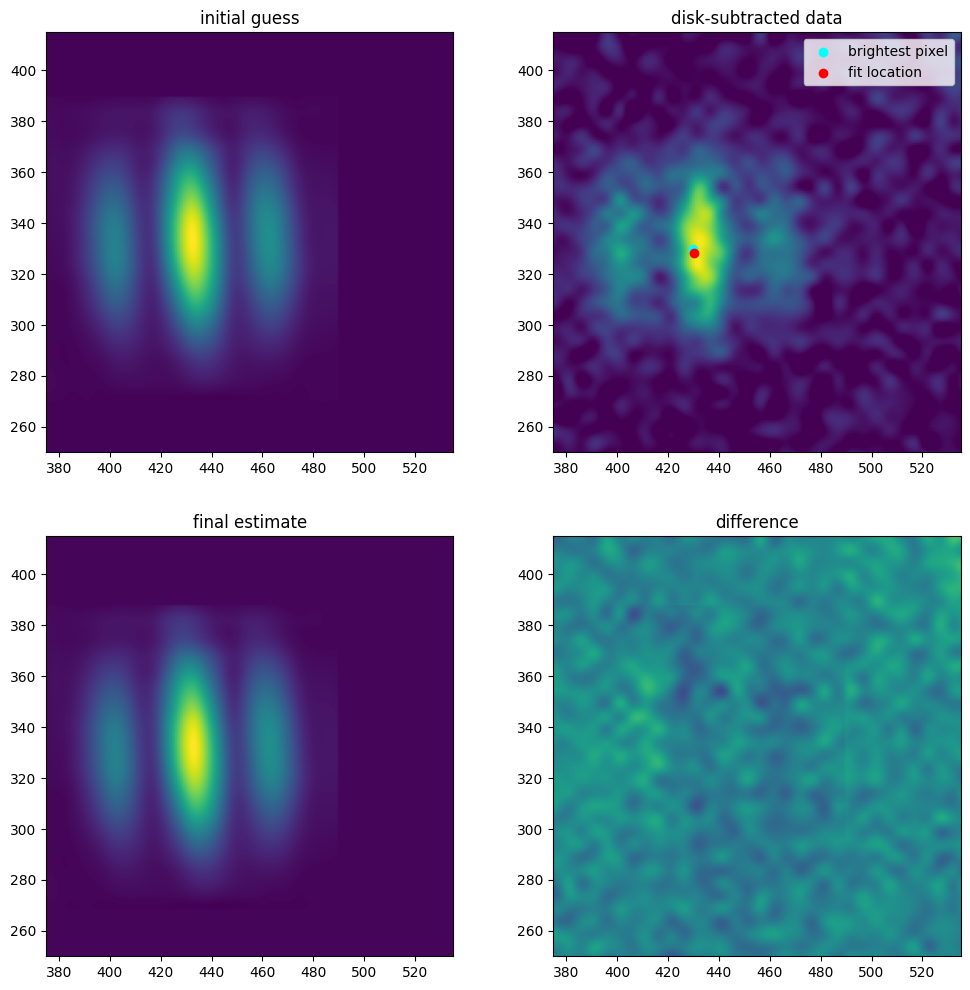

starting frame 5


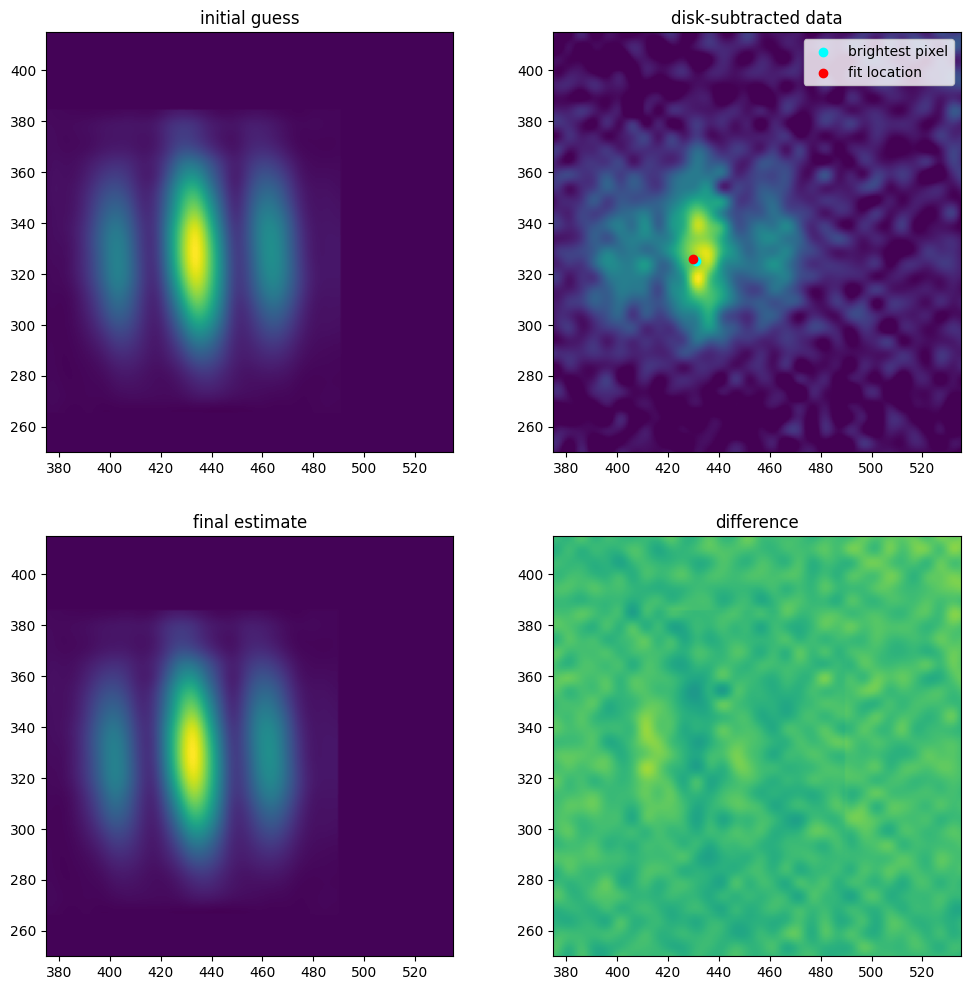

starting frame 6


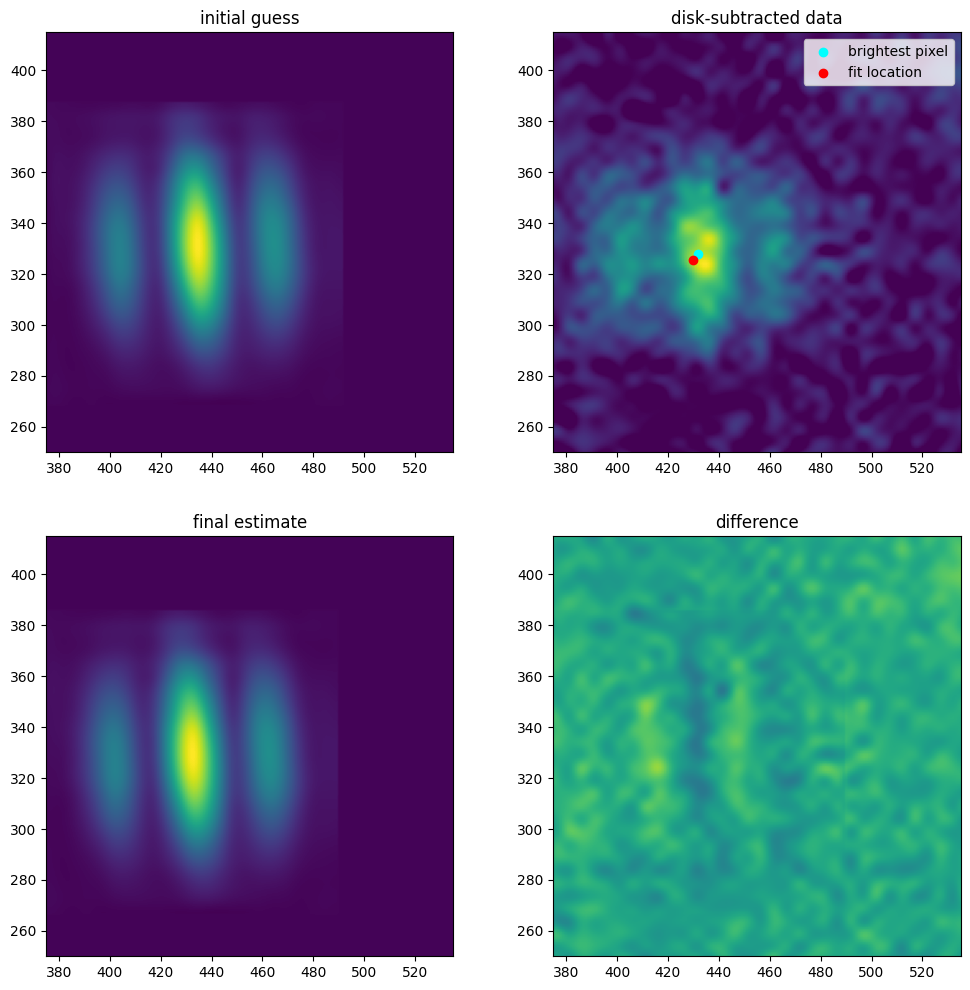

starting frame 7


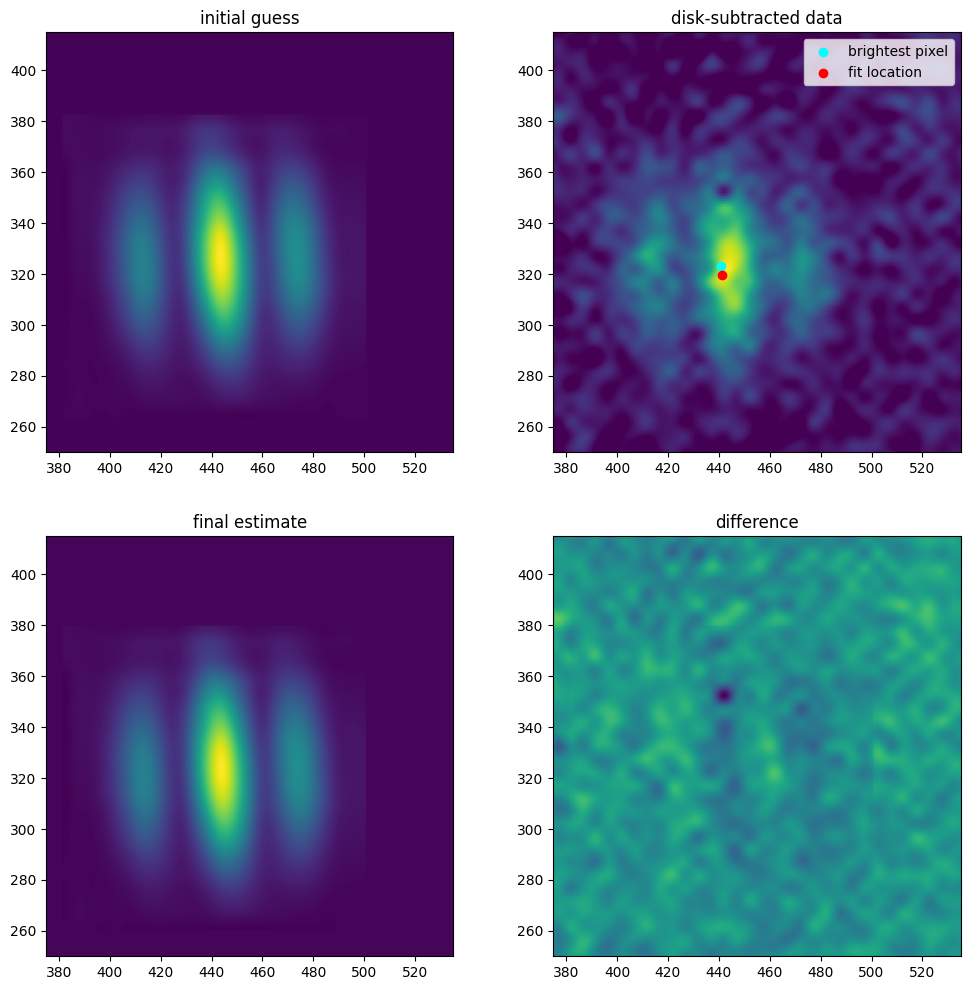

starting frame 8


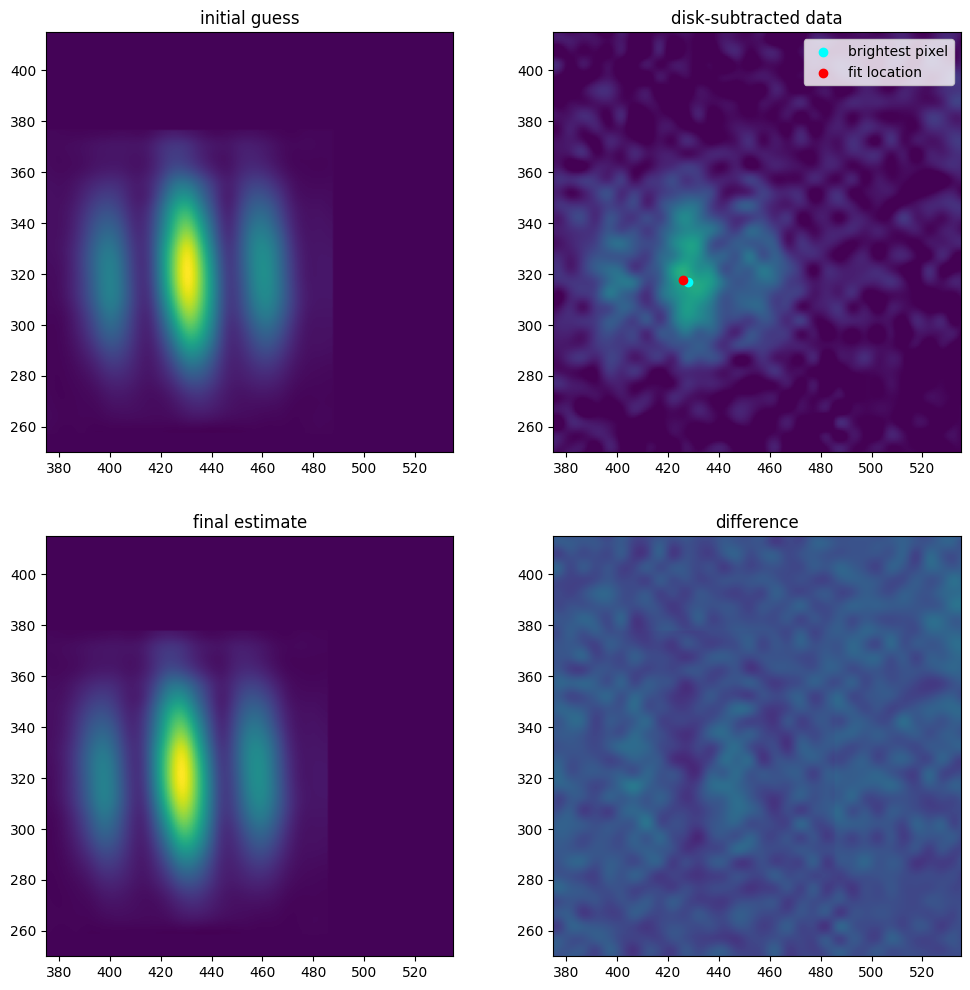

starting frame 9


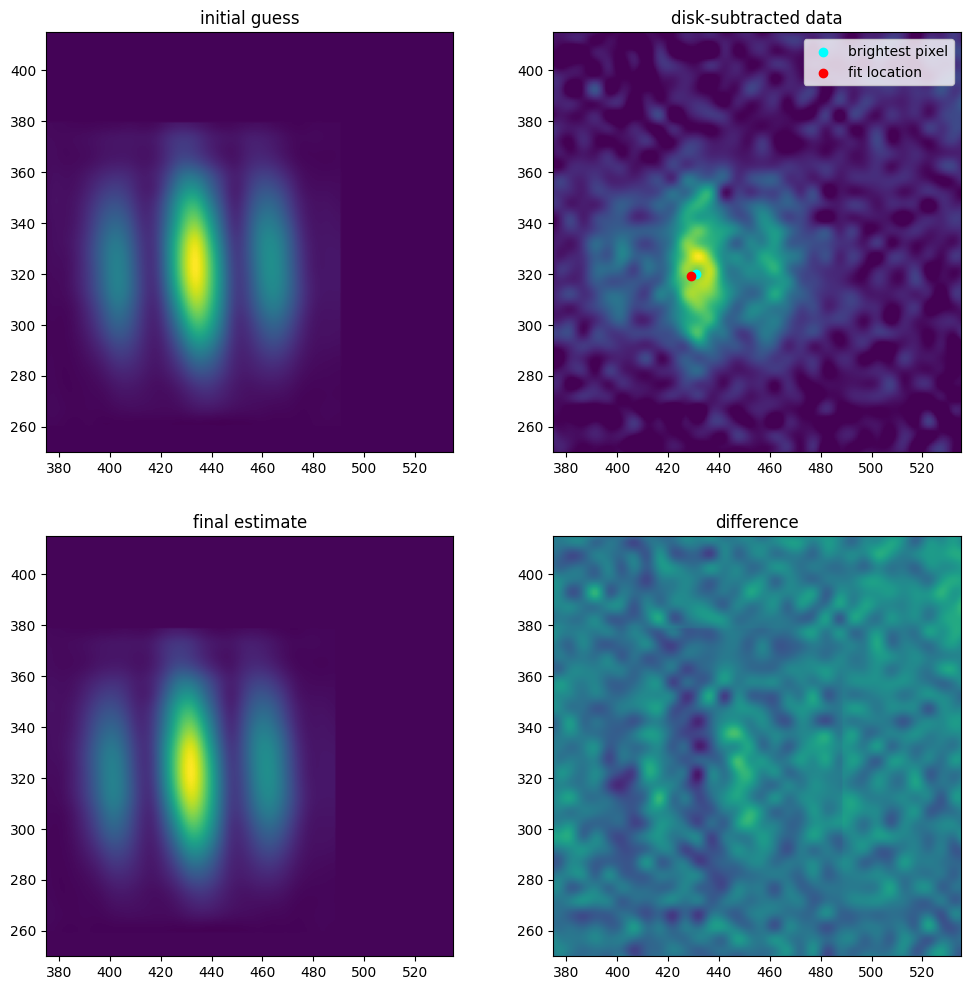

starting frame 10


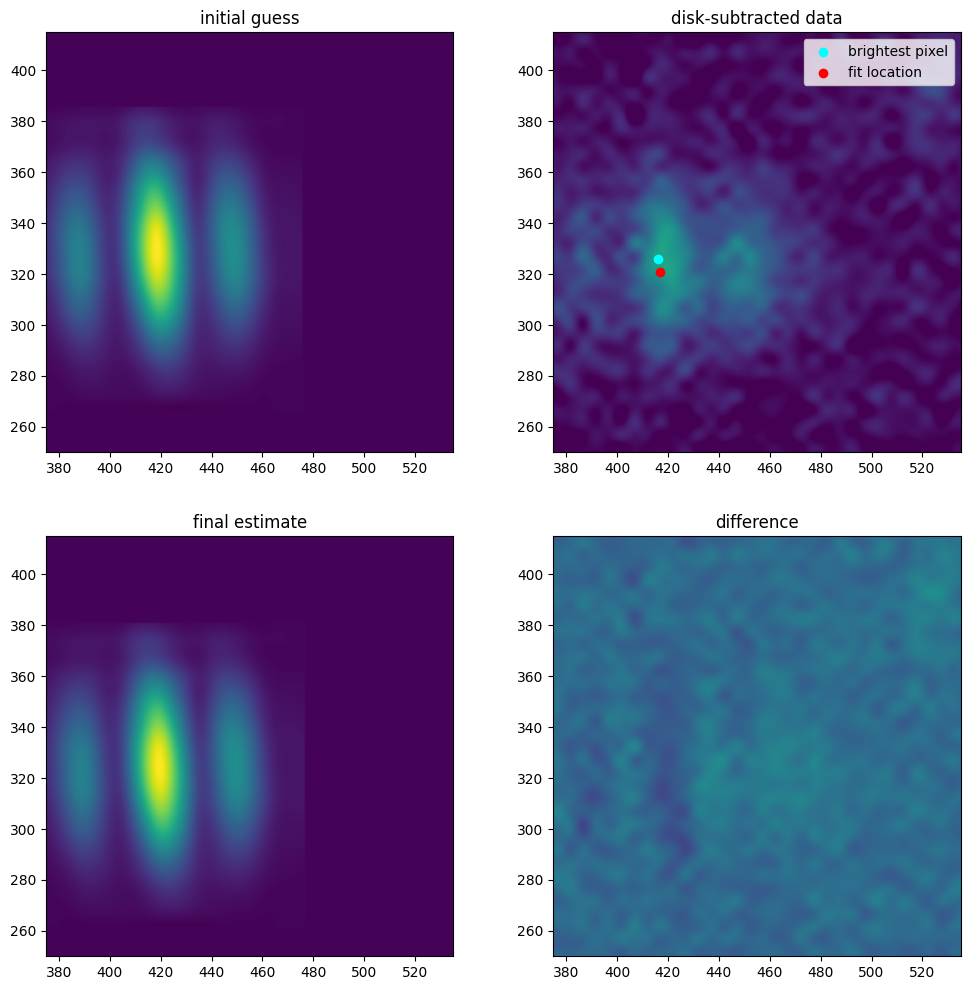

starting frame 11


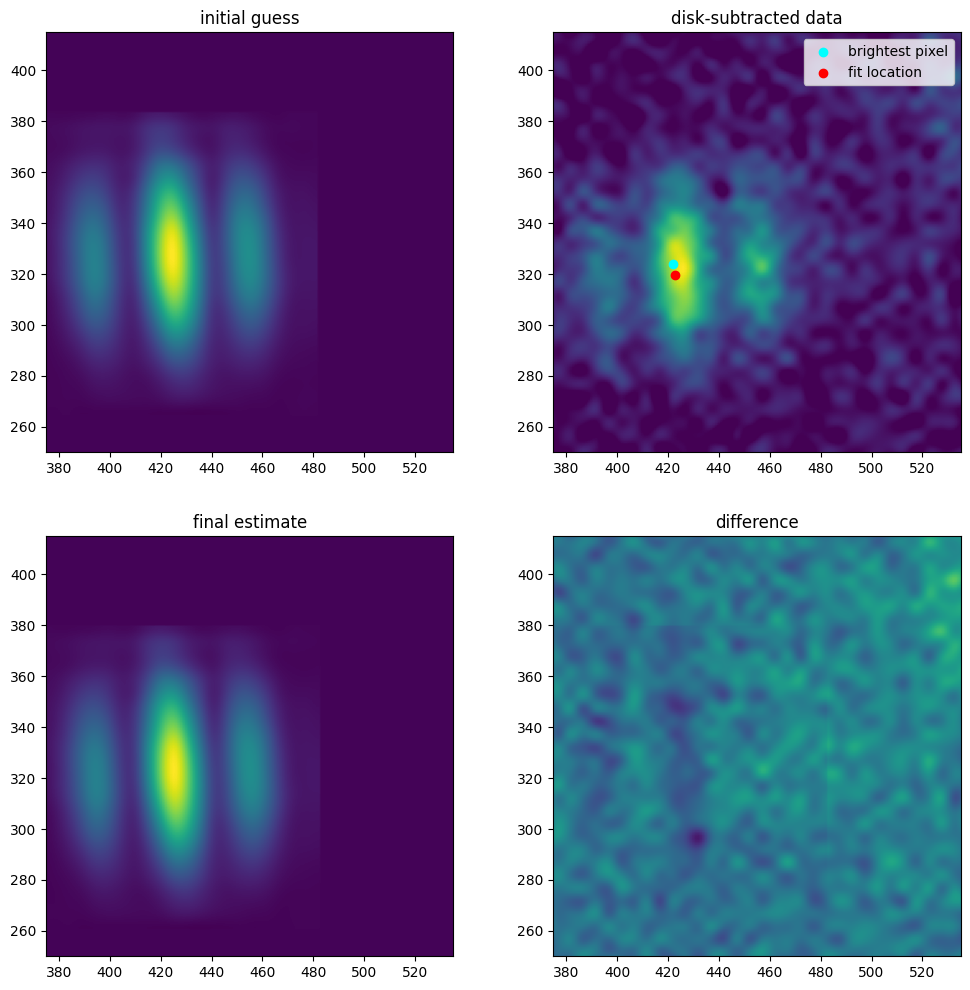

starting frame 12


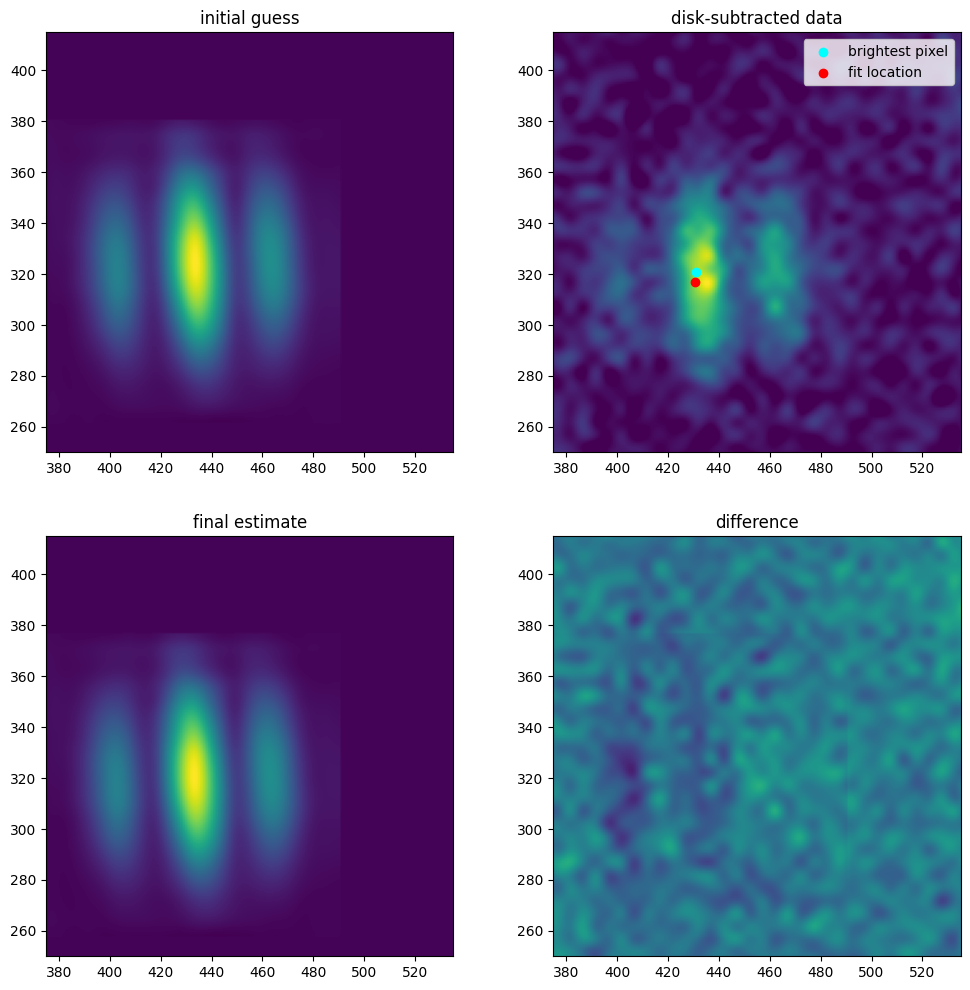

starting frame 13


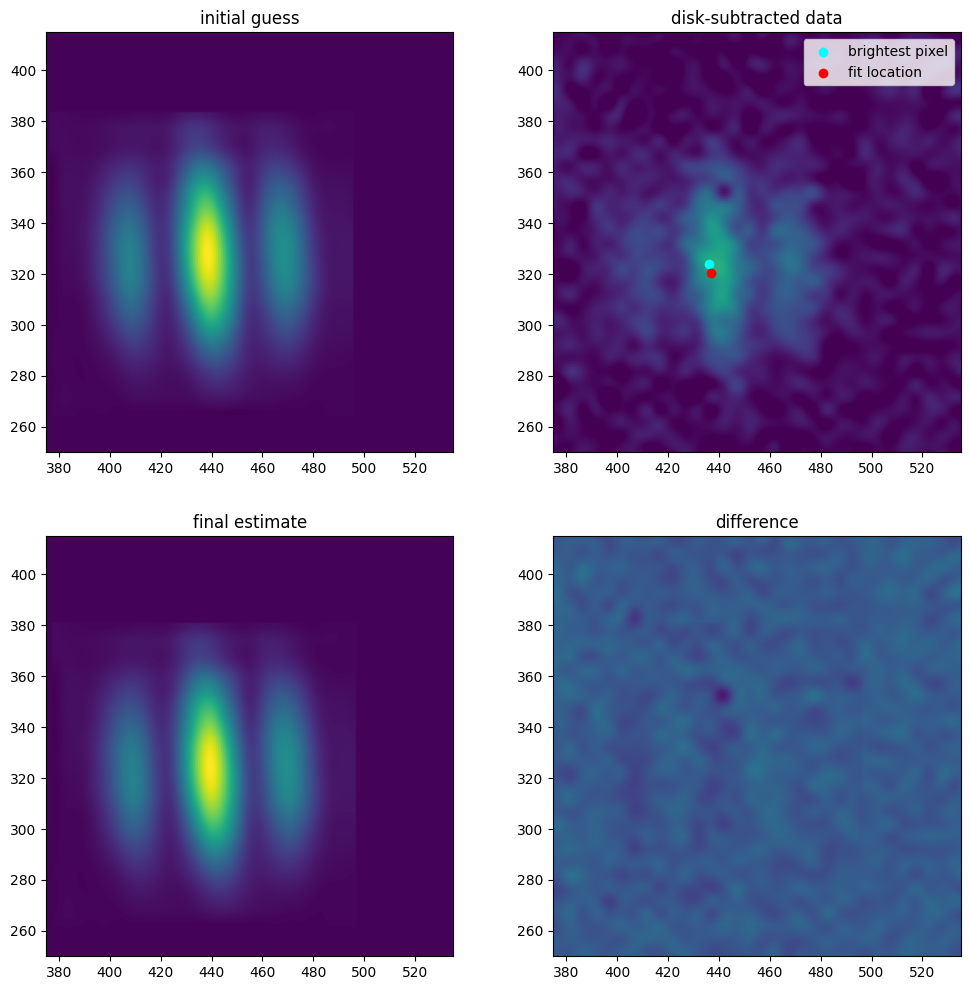

starting frame 14


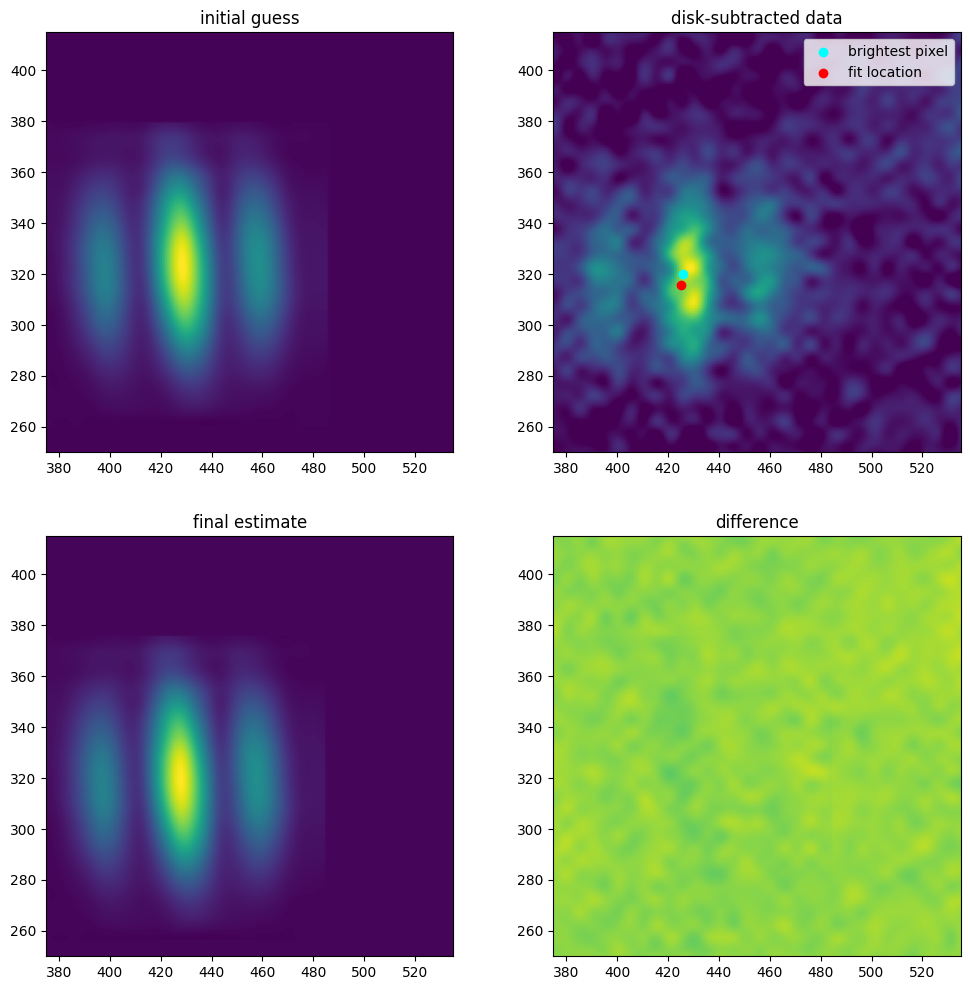

starting frame 15


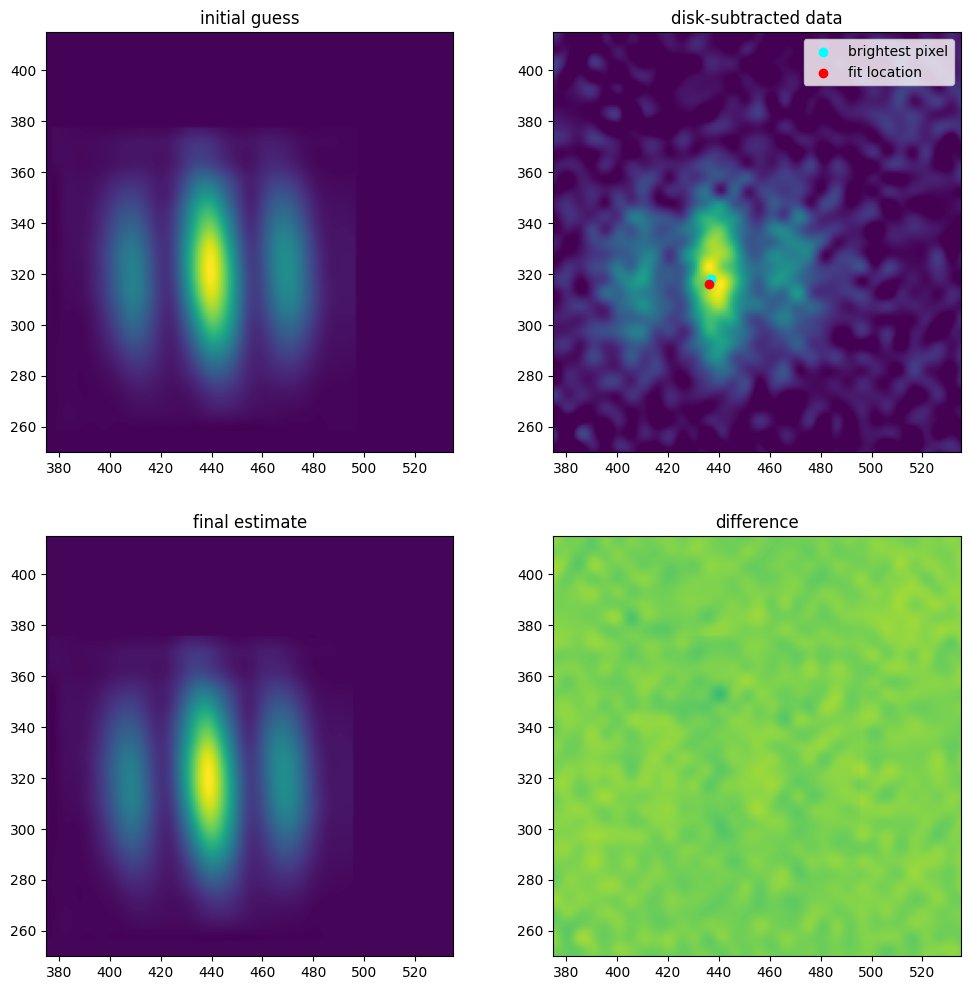

starting frame 16


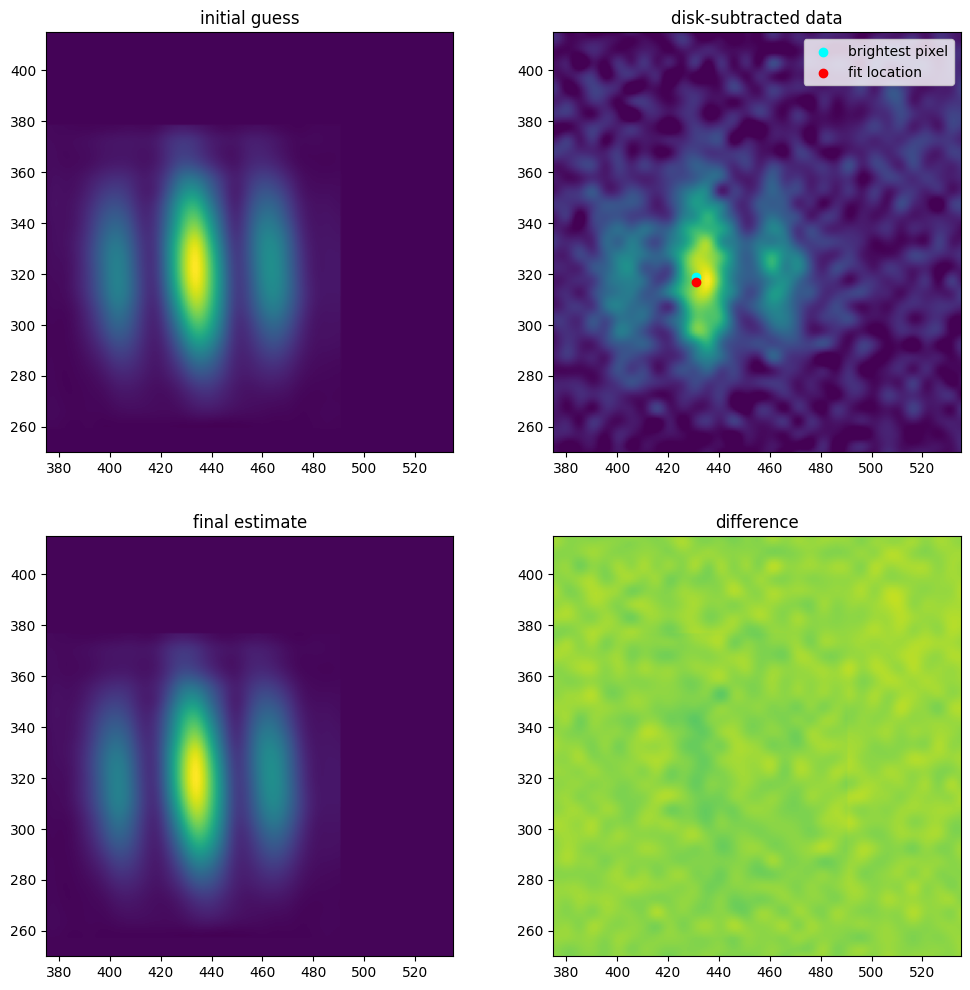

starting frame 17


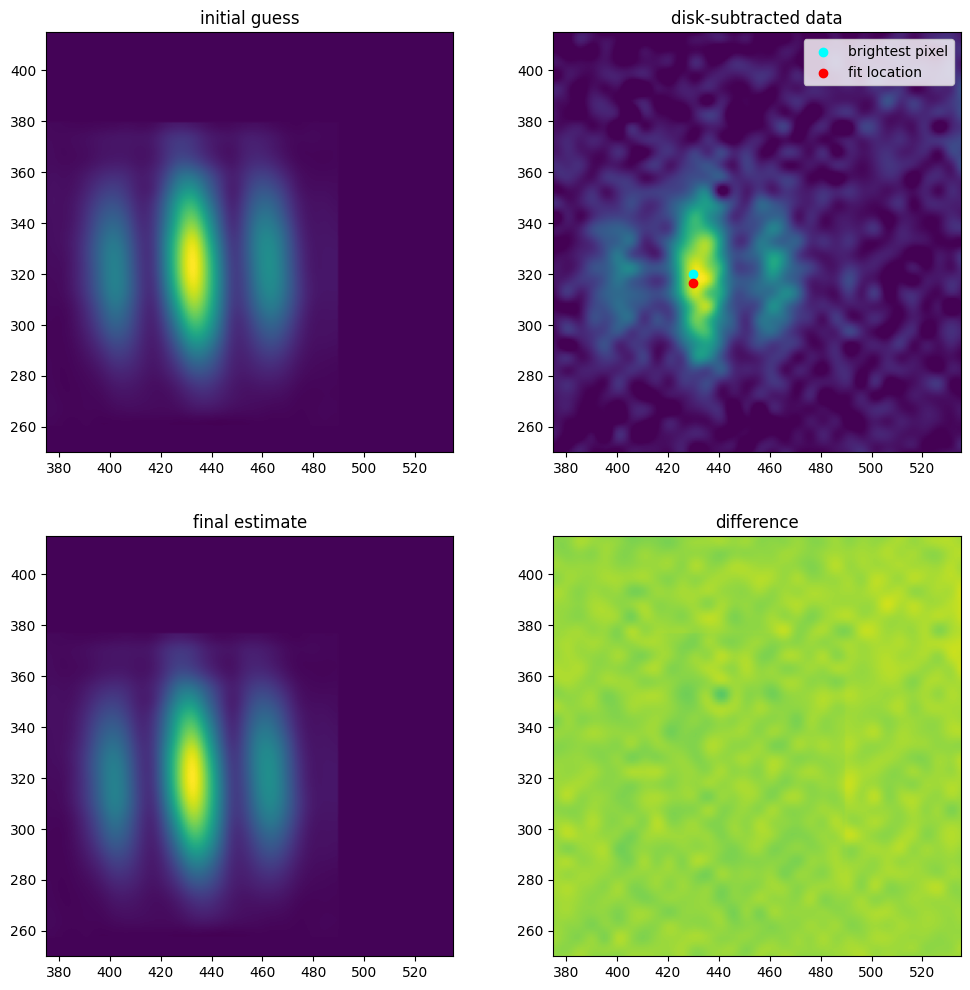

starting frame 18


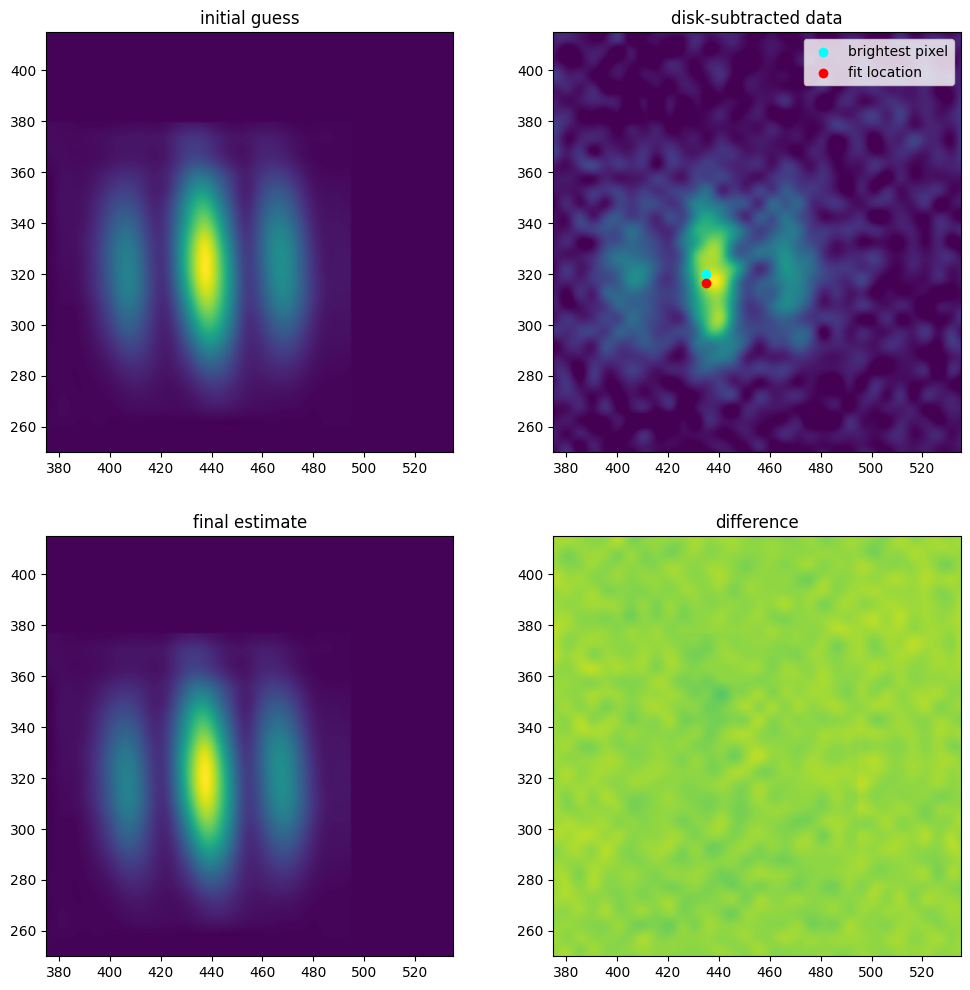

starting frame 19


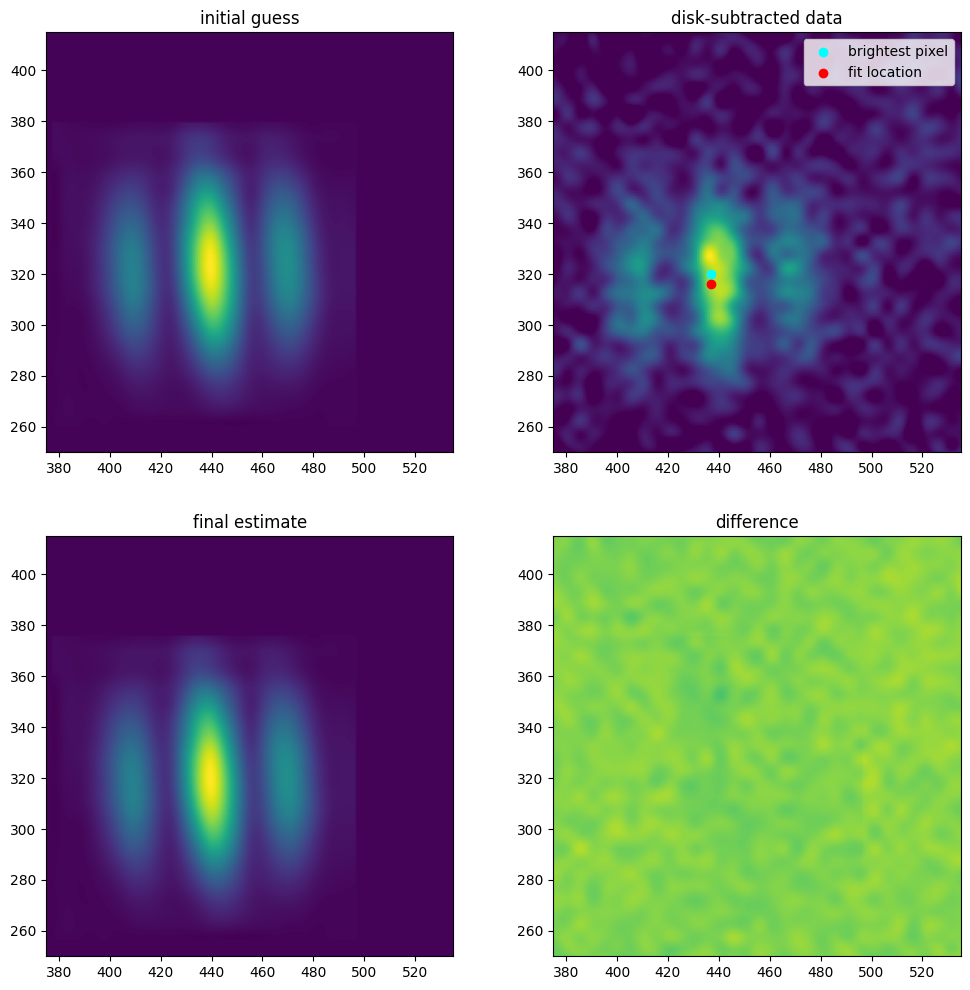

starting frame 20


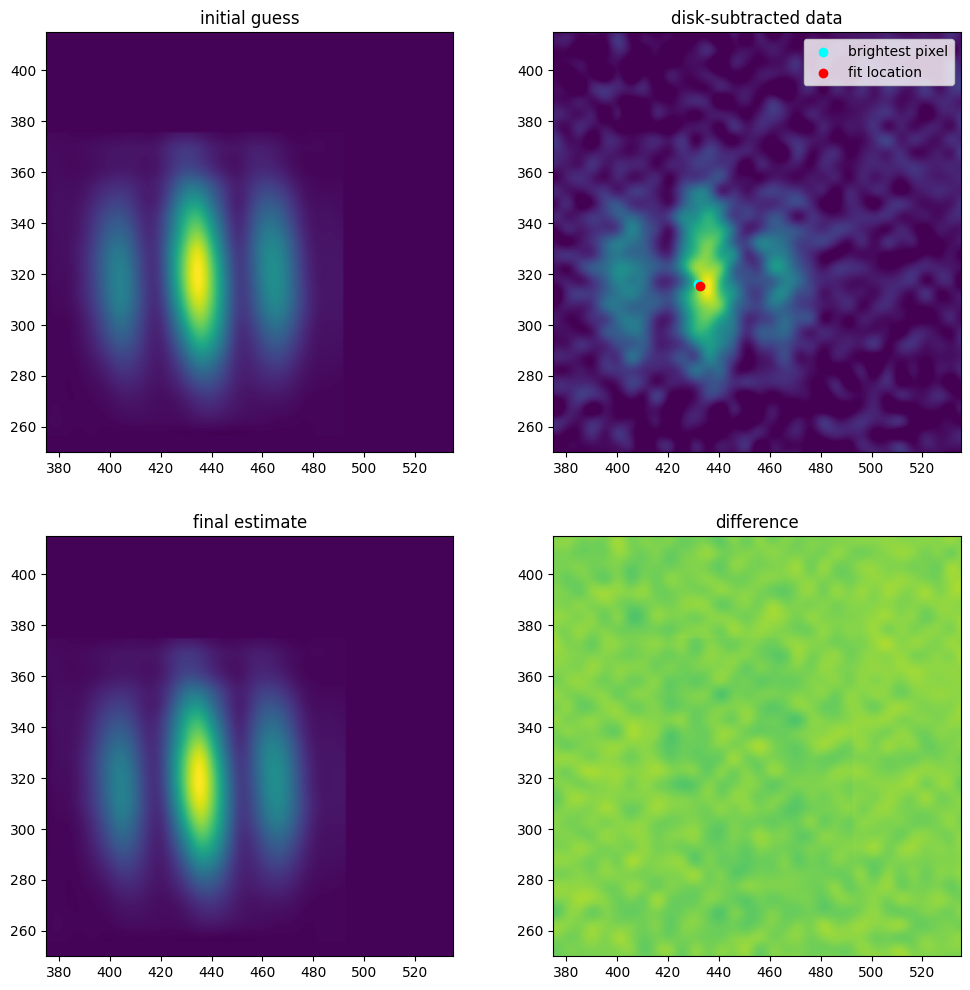

starting frame 21


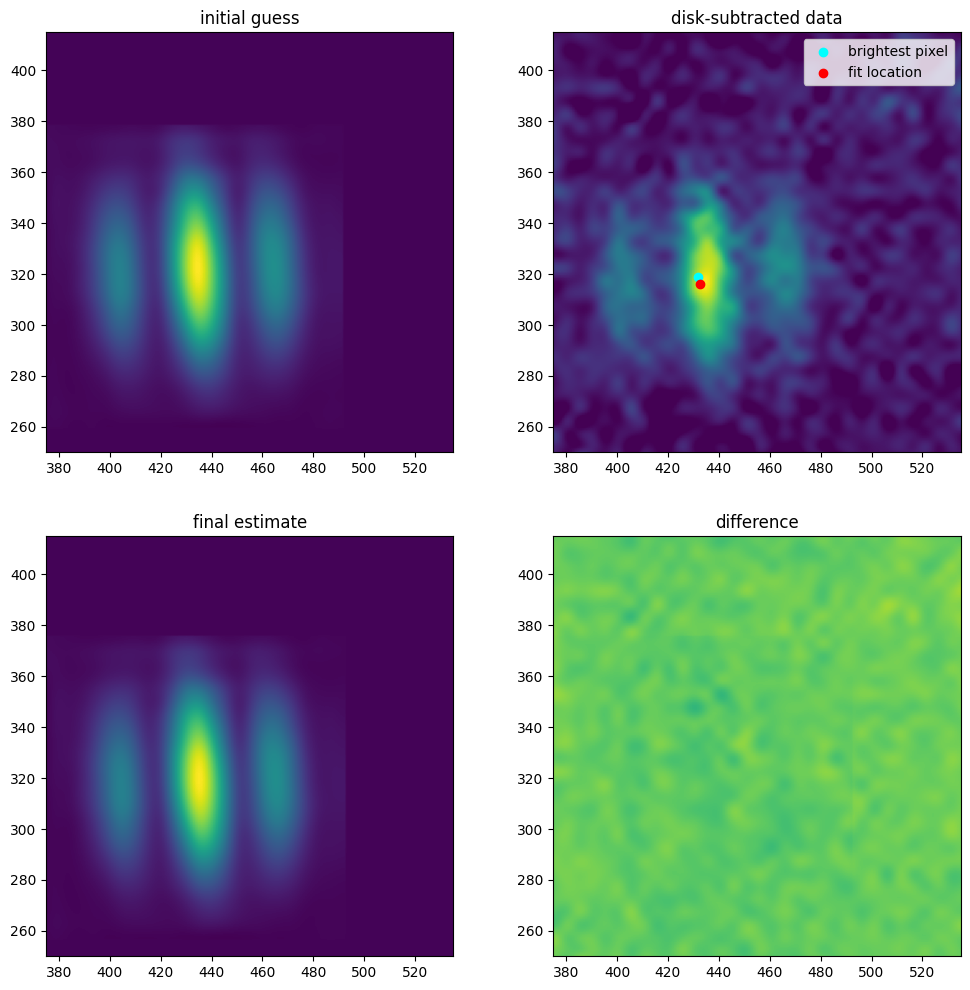

starting frame 22


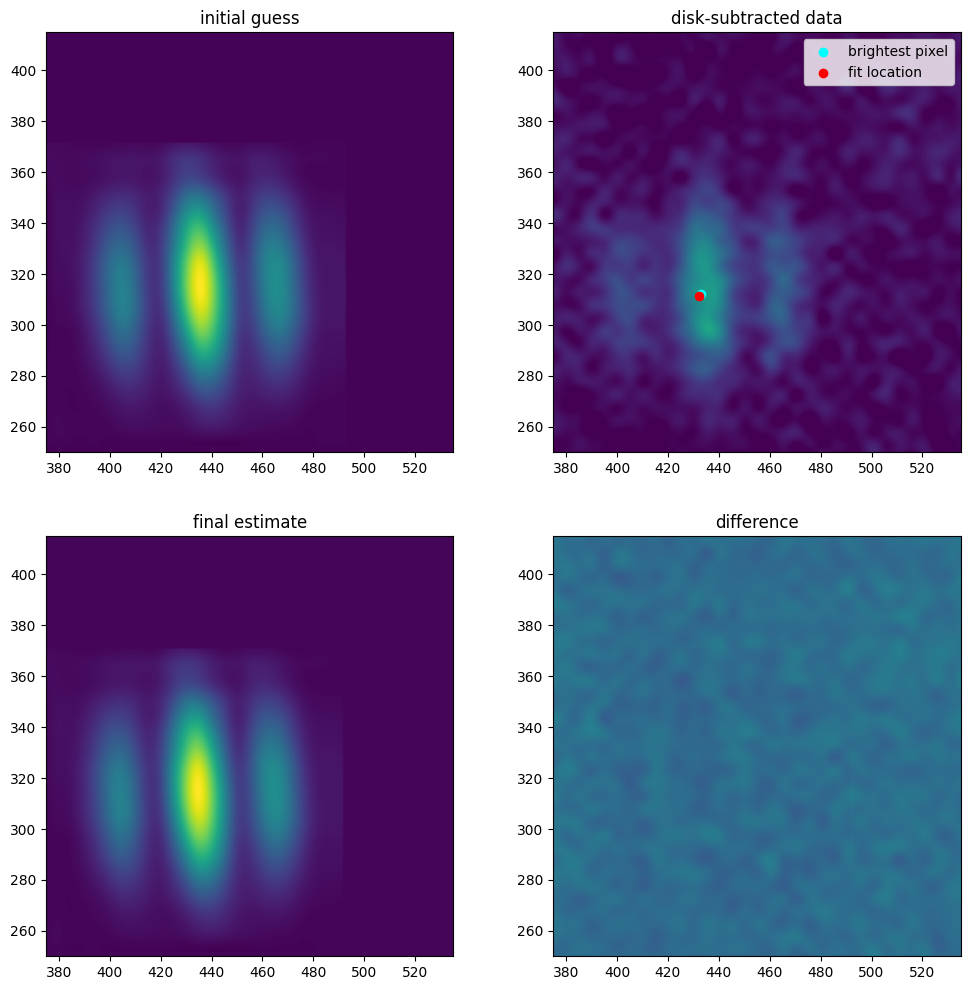

starting frame 23


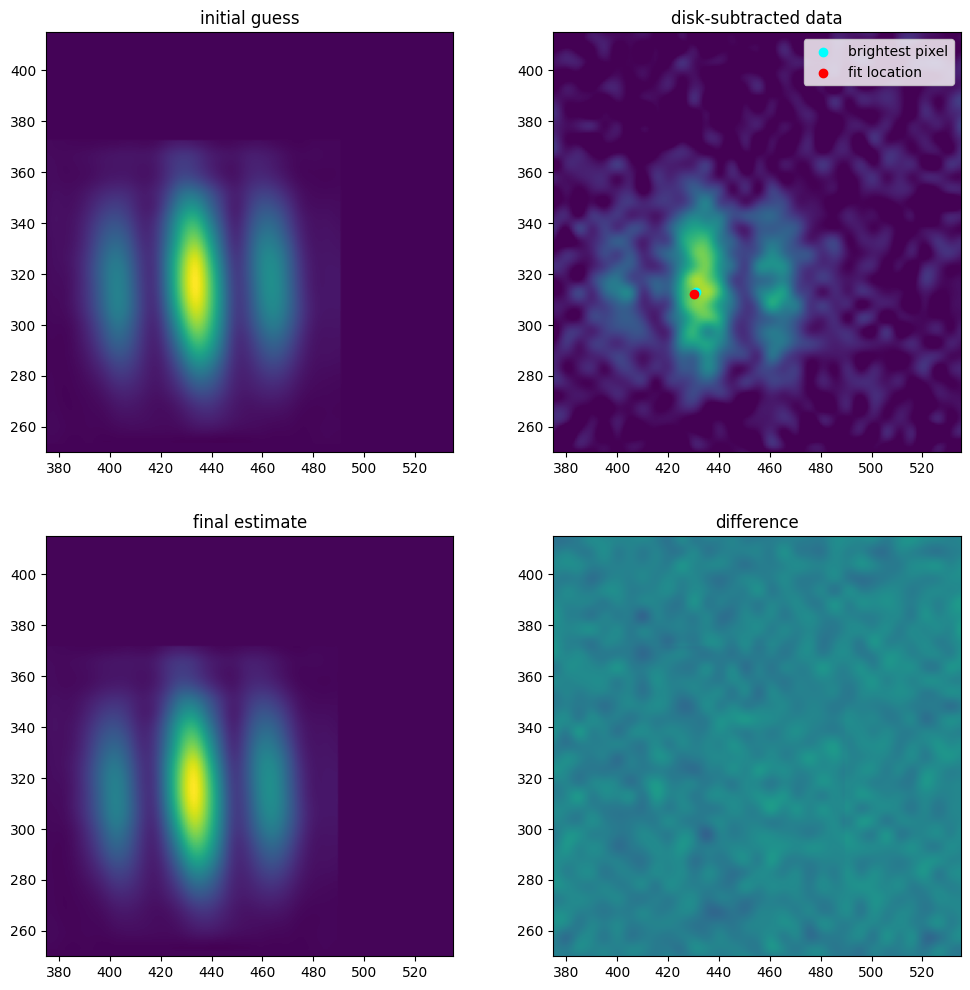

starting frame 24


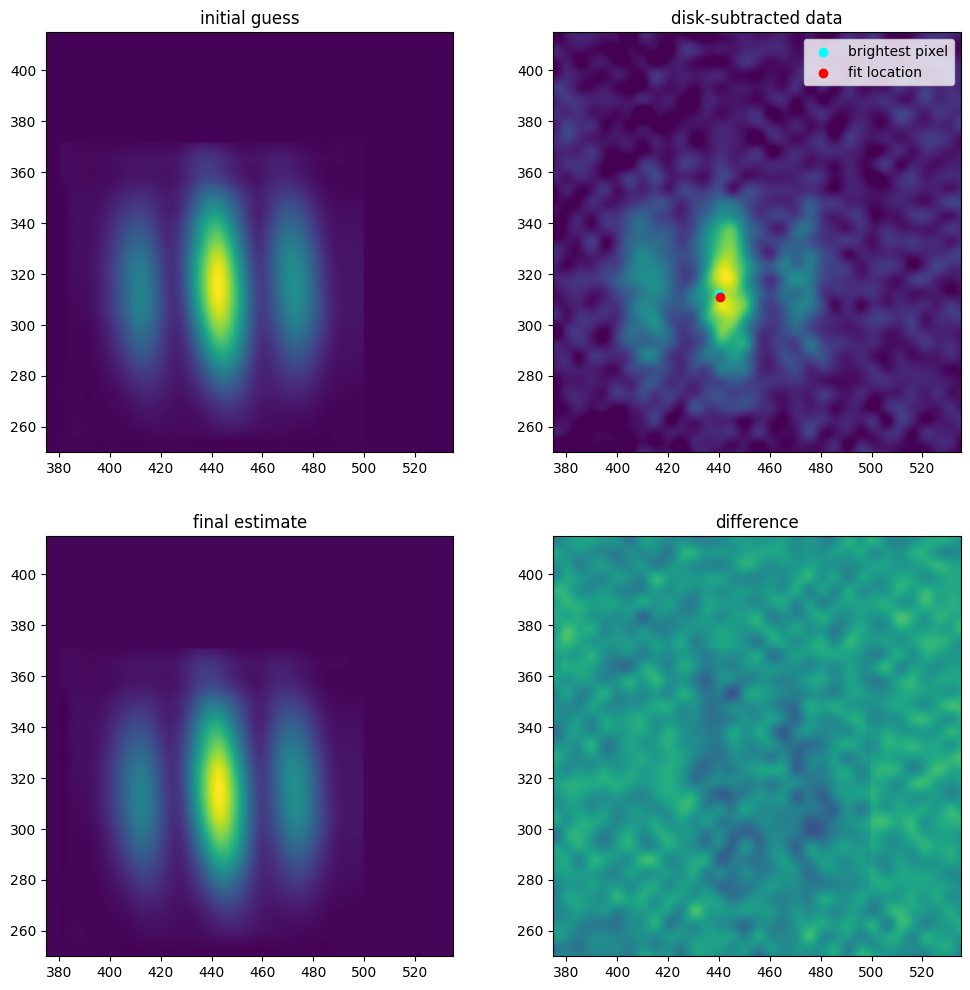

starting frame 25


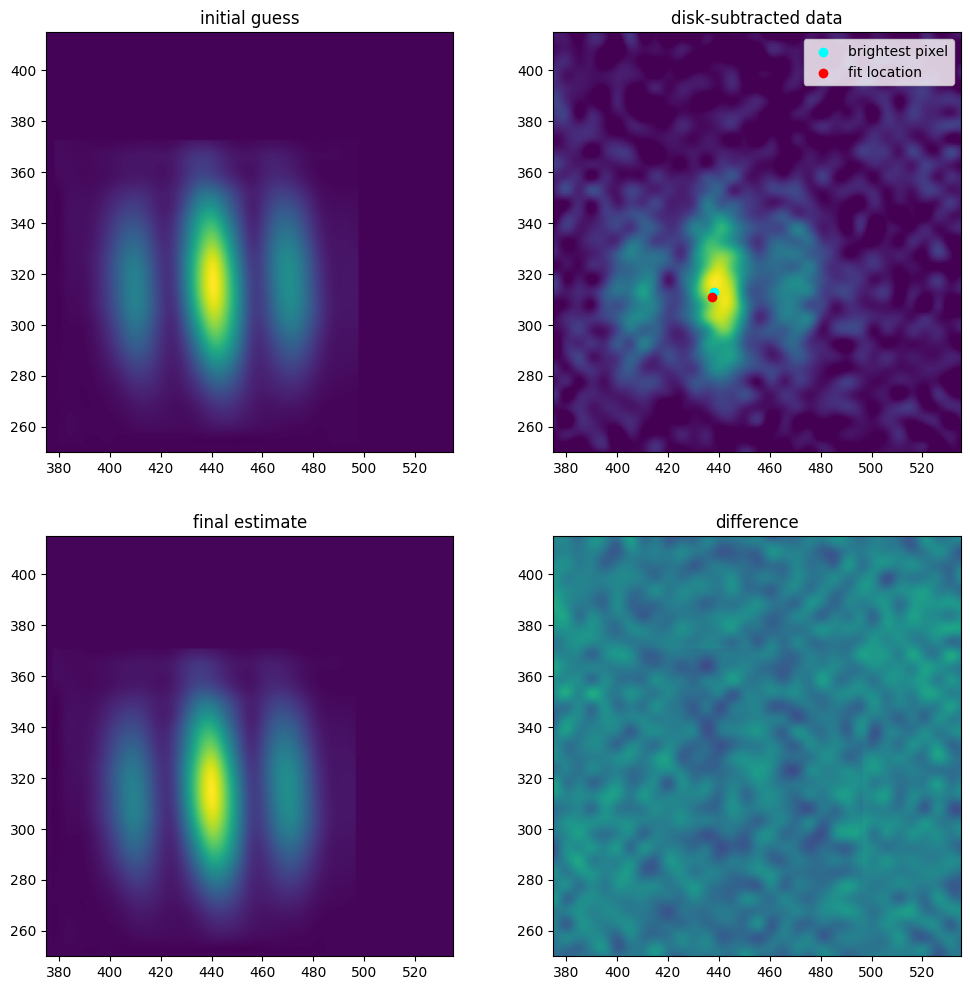

starting frame 26


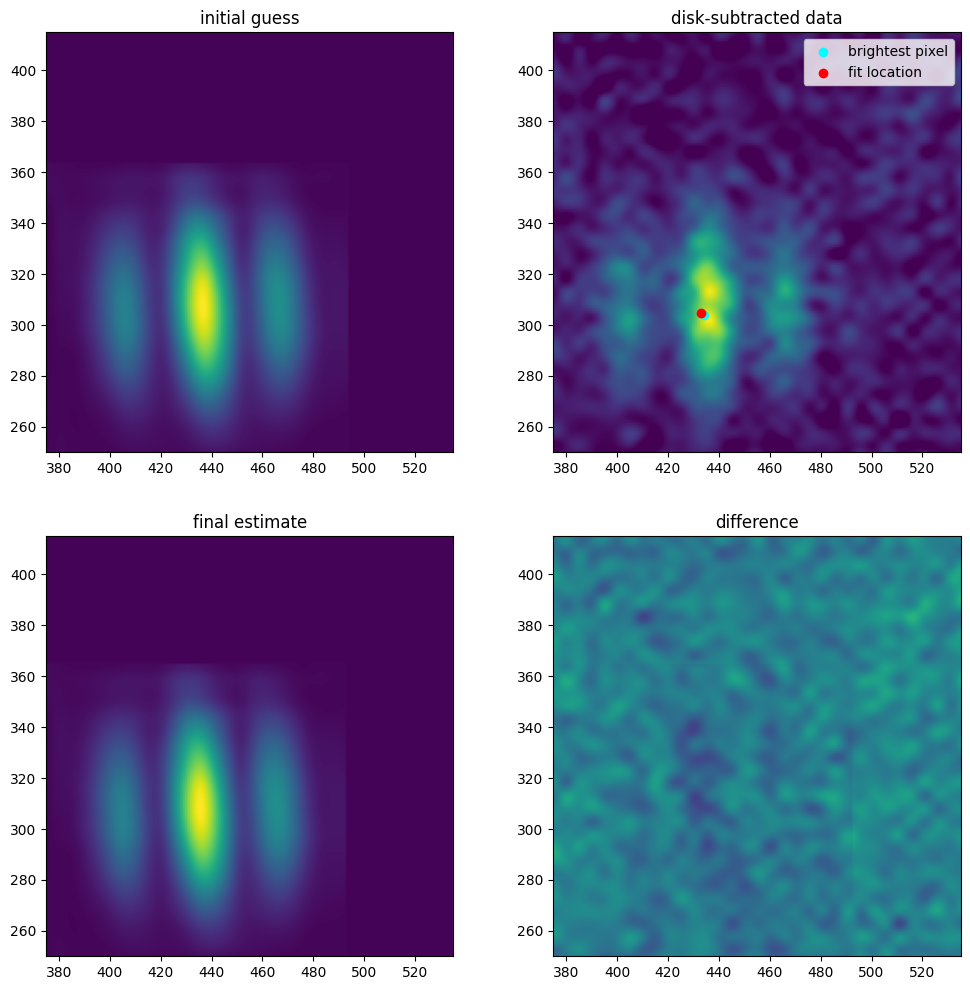

starting frame 27


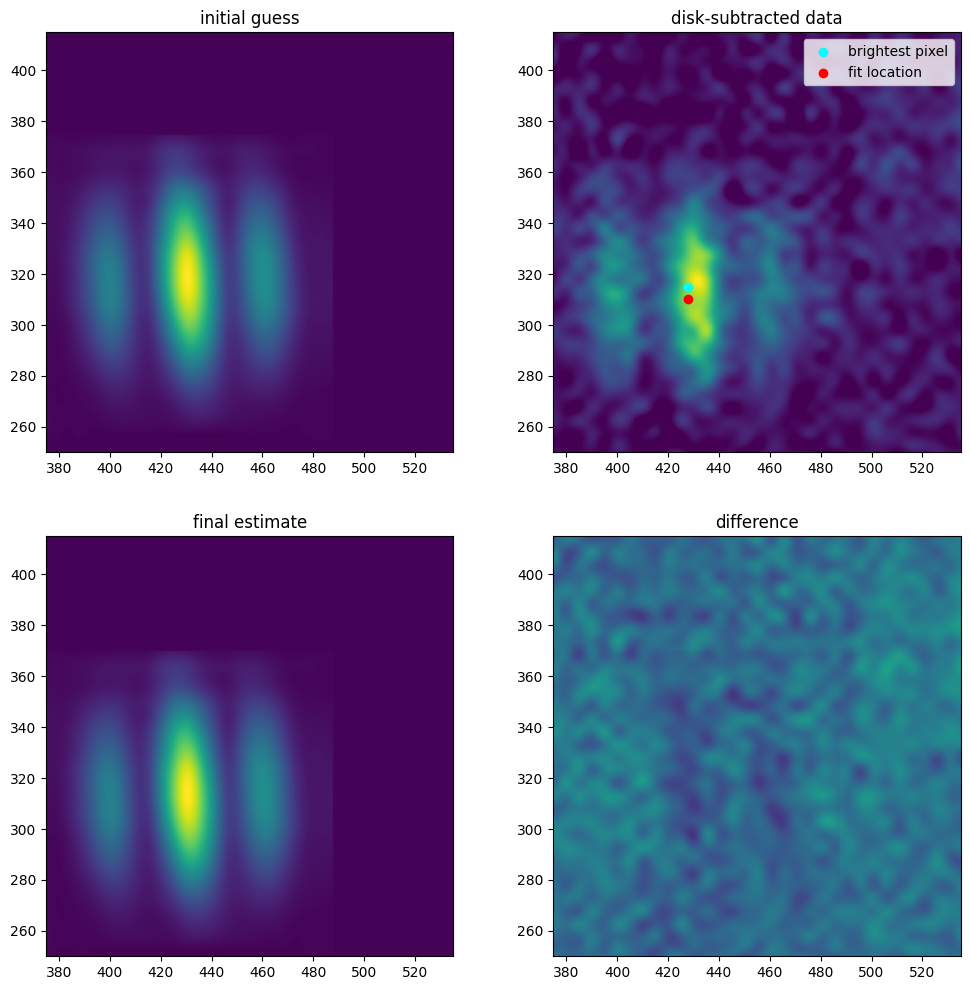

starting frame 28


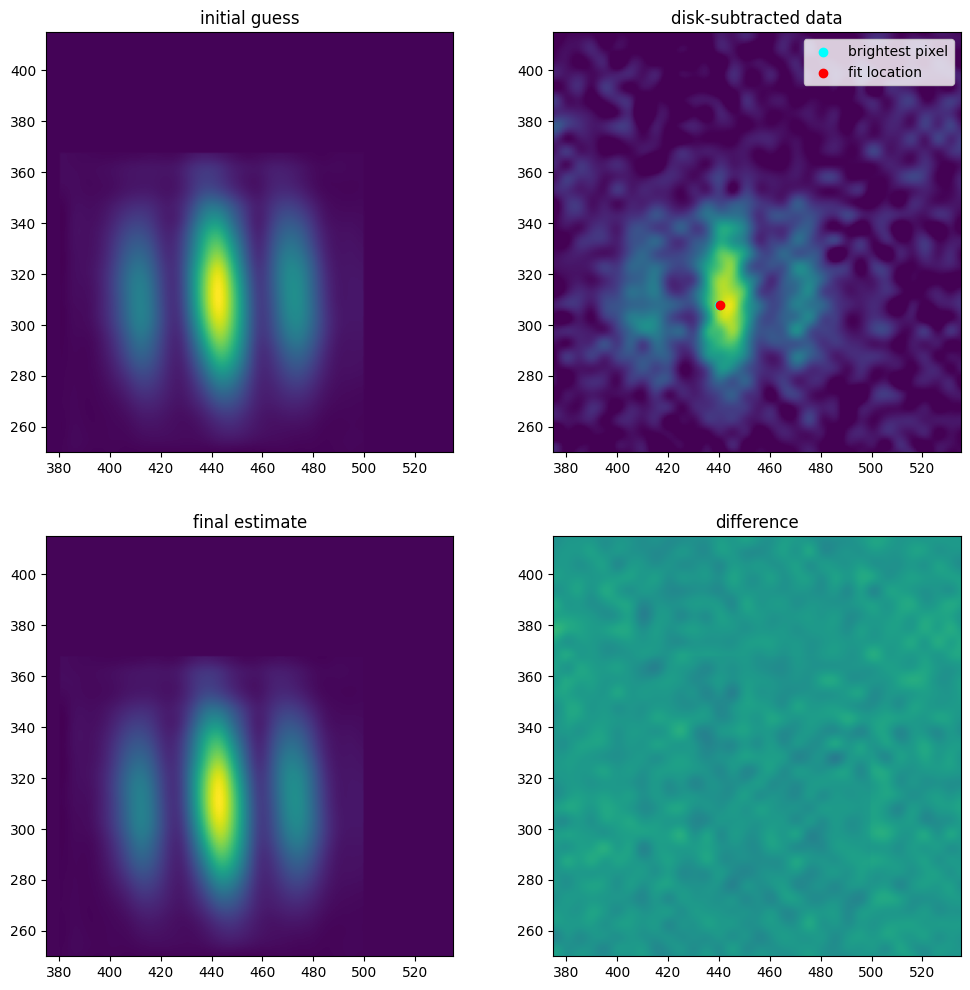

starting frame 29


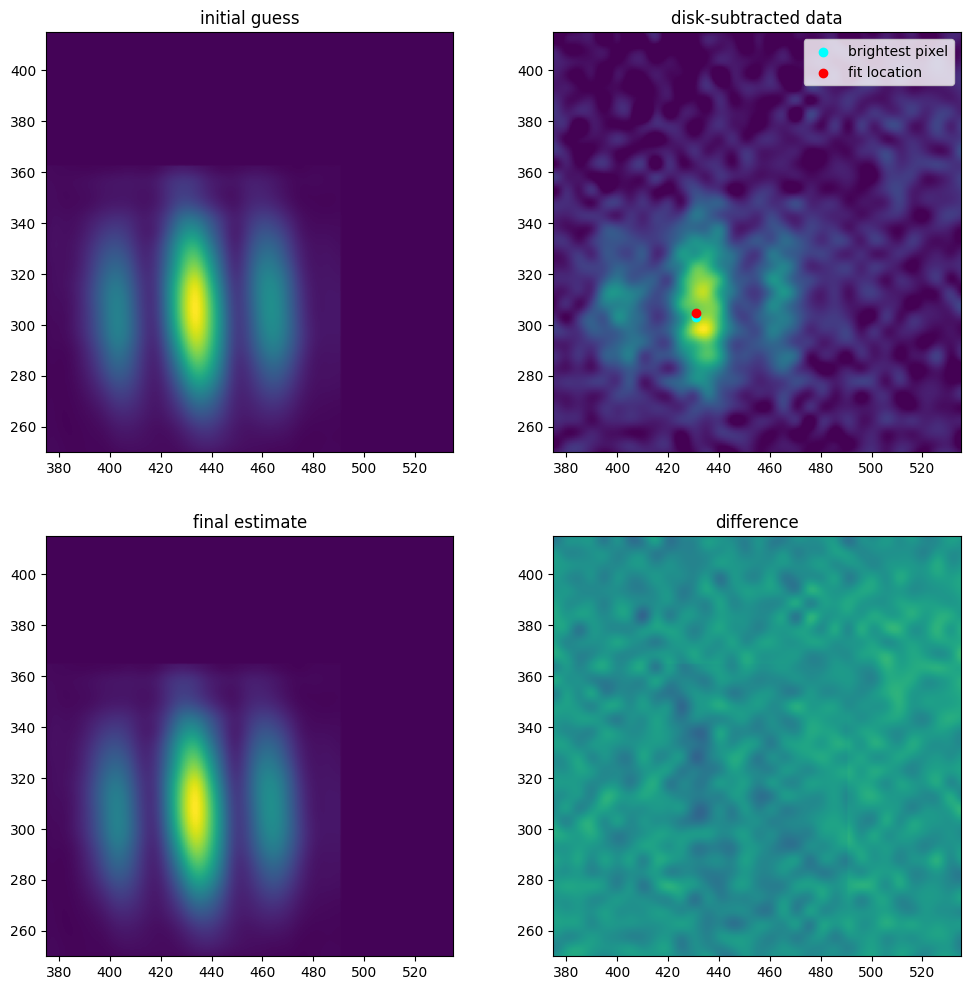

starting frame 30


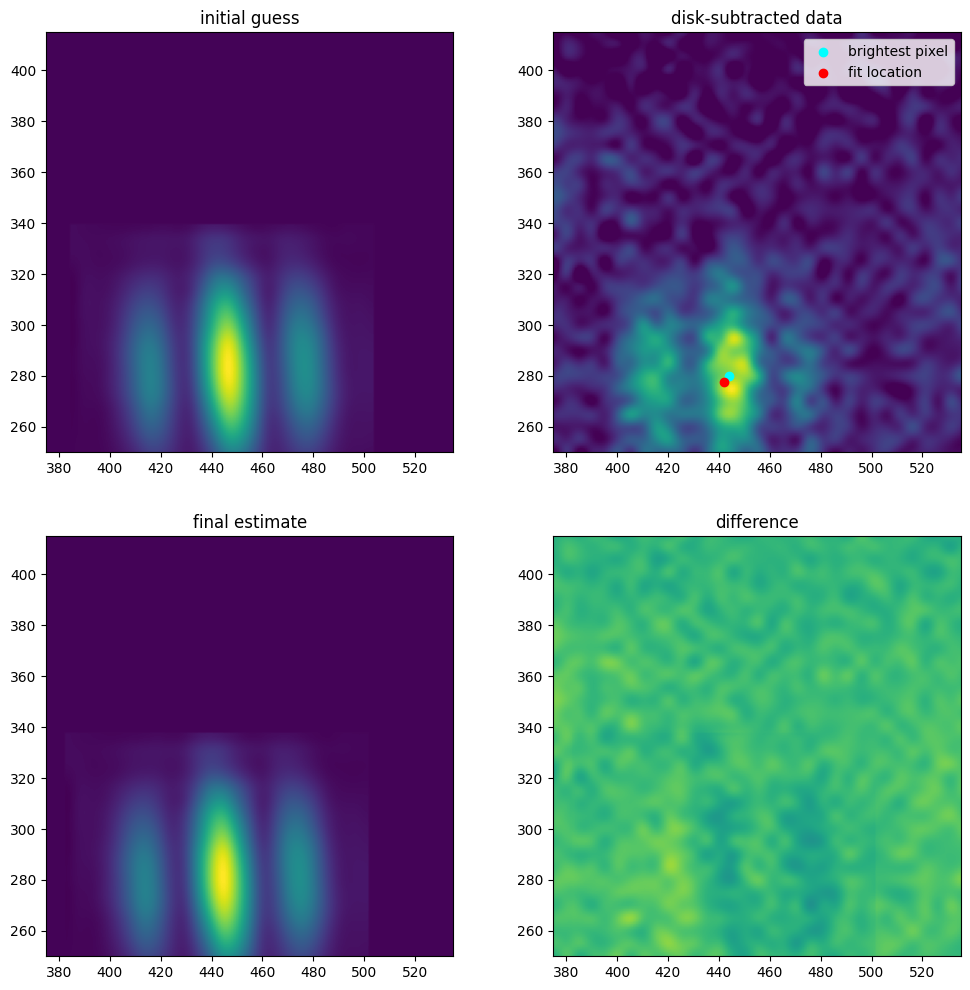

starting frame 31


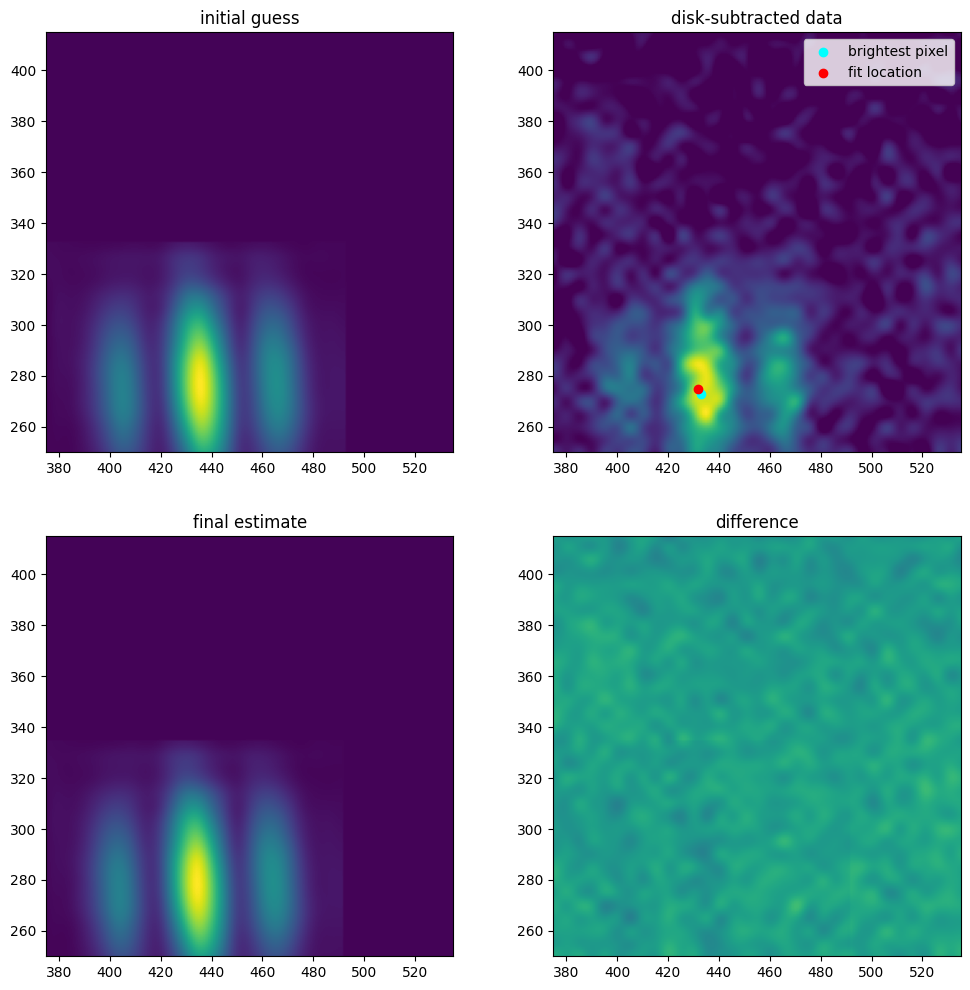

starting frame 32


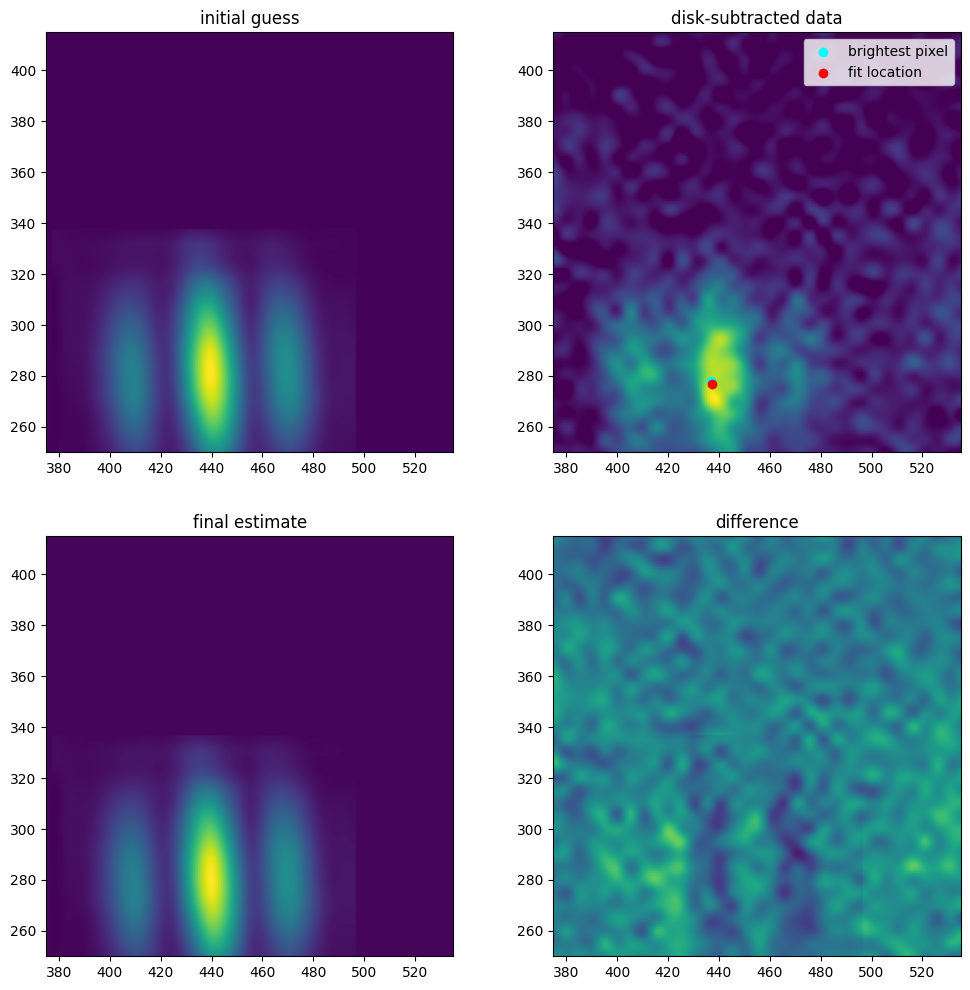

starting frame 33


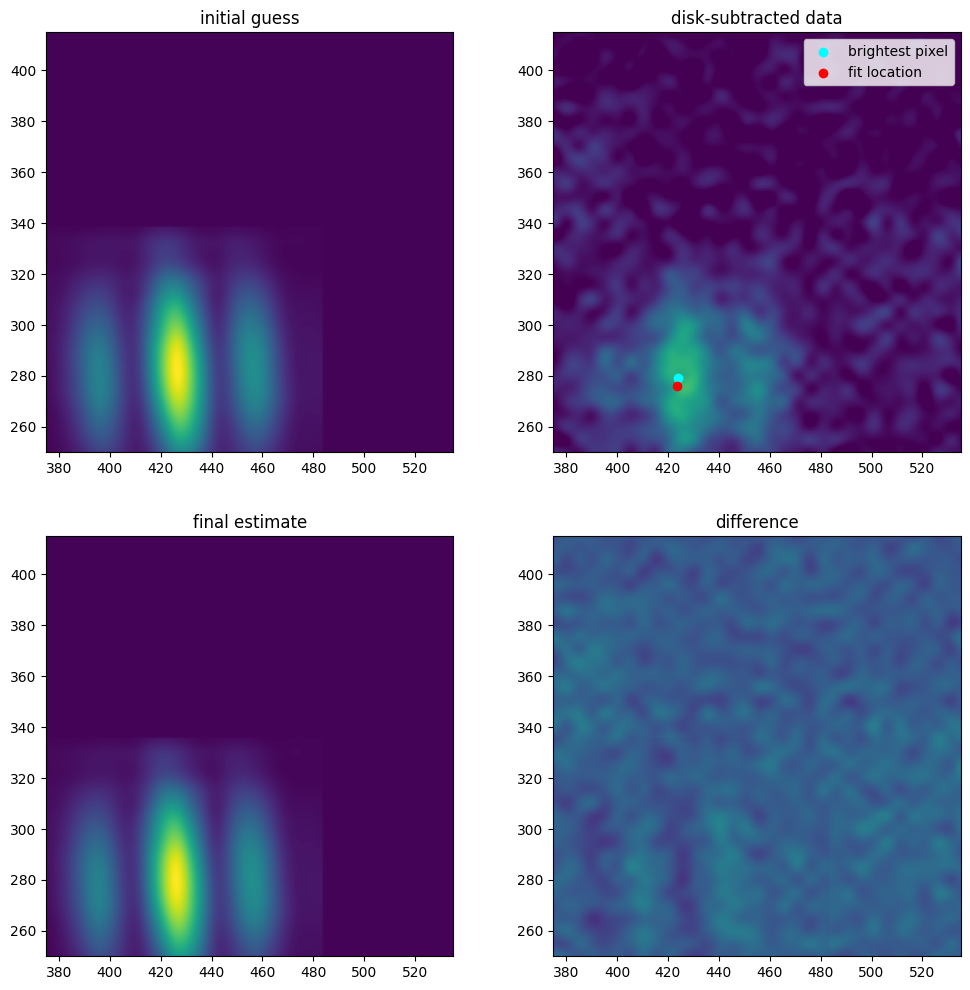

starting frame 34


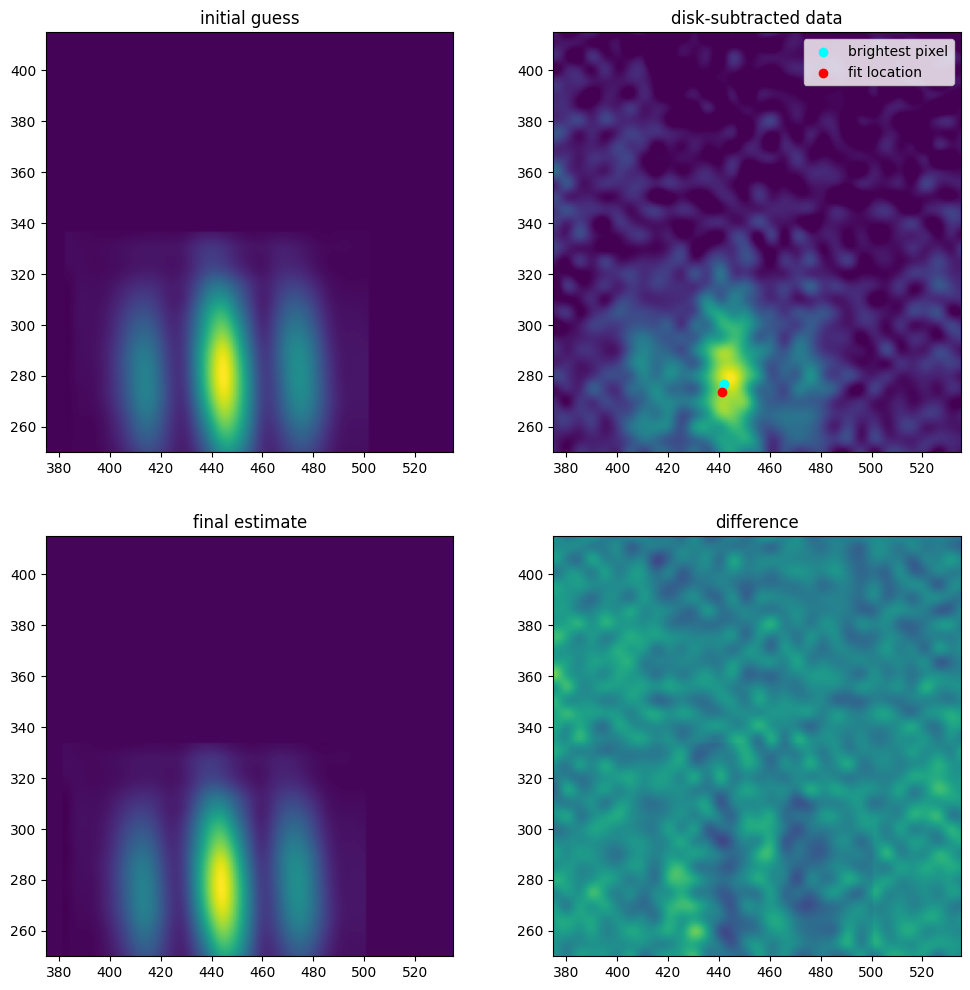

starting frame 35


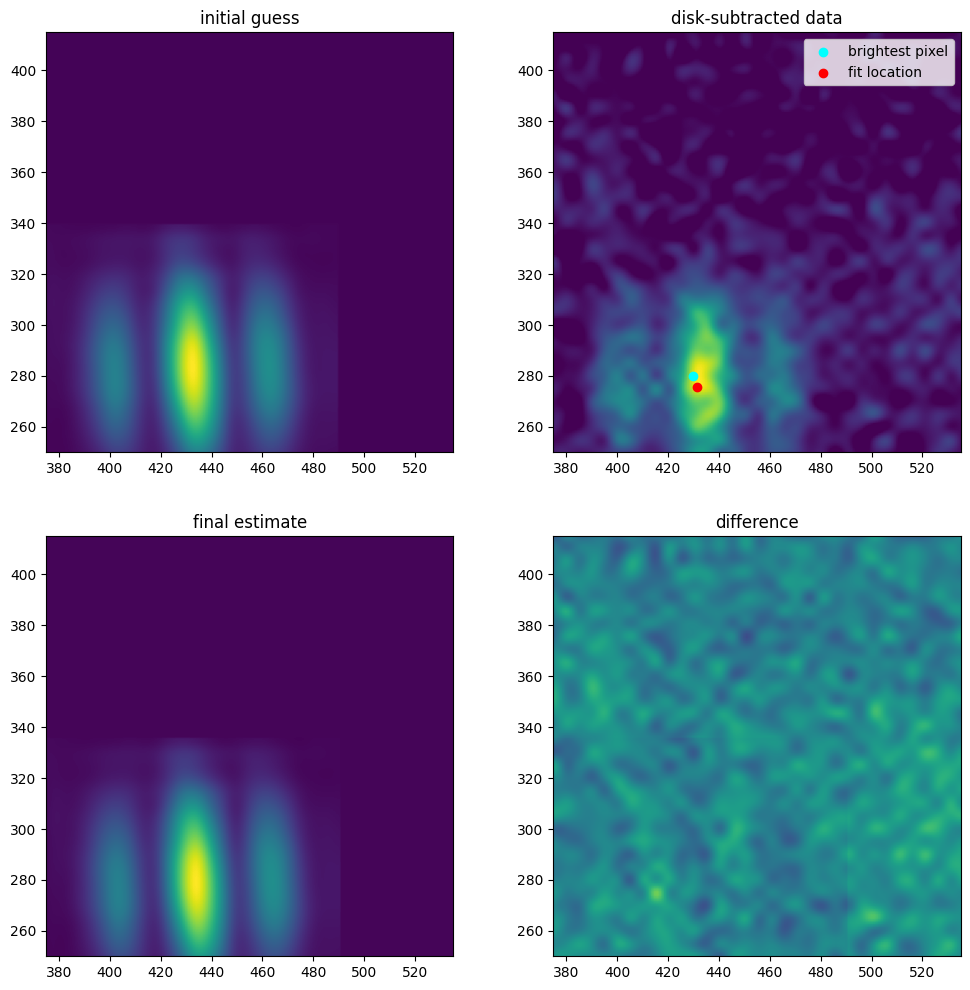

starting frame 36


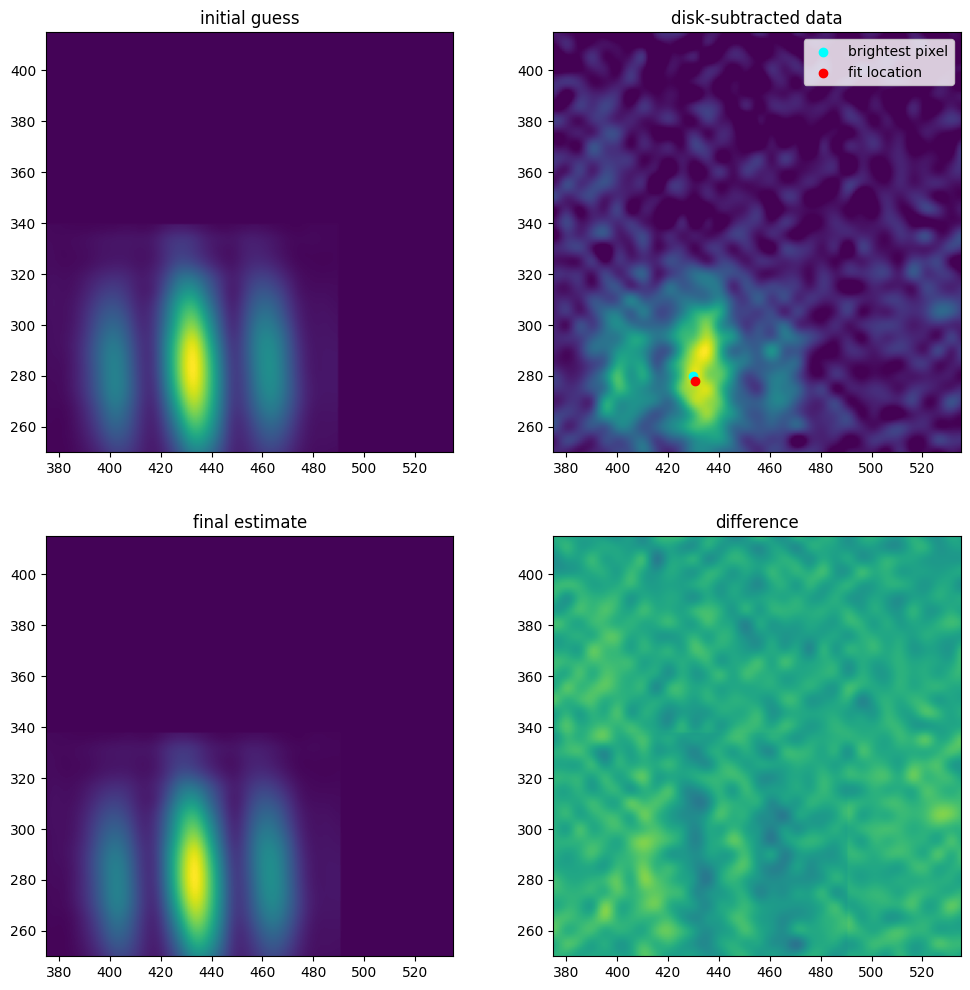

starting frame 37


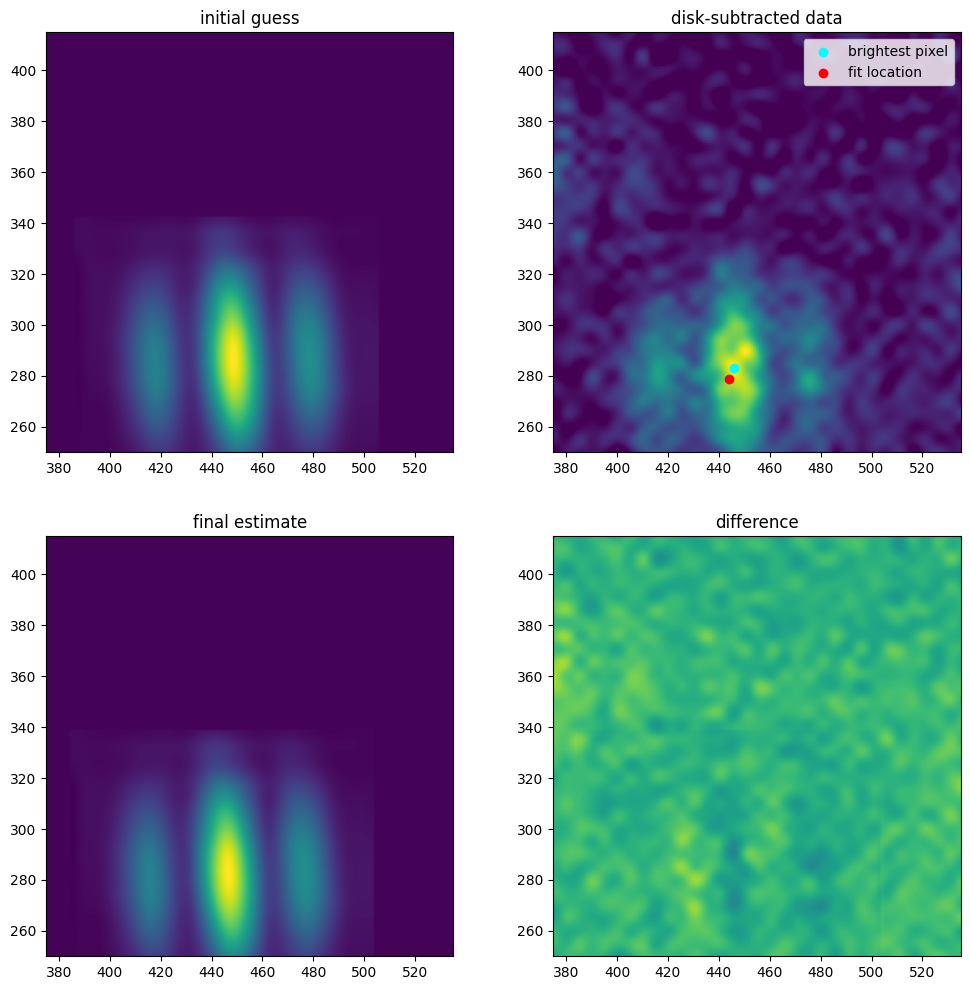

In [110]:
rmsvals = []
emakong_x = []
emakong_y = []
emakong_xsig = []
emakong_ysig = []
emakong_fluxsig = []
emakong_flux = []
emakong_lat = []
emakong_lon = []
disksub_data = []
for i, obstime in enumerate(lucky_times):
    
    print(f'starting frame {i}')
    frame = io_data[i]
    angle = lucky_angles[i]
    output_model = output_models[i]

    ## new planetnav workflow
    io = Body('Io', epoch=obstime, location='G83') #Keck
    # adjust north pole angle according to parallactic angle
    npang = io.ephem['NPole_ang']
    io.ephem['NPole_ang'] = (npang - angle)%360
    frame_z = zoom(frame, z)
    nav = Nav(frame_z, io, pixscale_arcsec/z)
    
    # shift data to the center
    nav.xy_shift_data(-dx[i], -dy[i])
    if i == 0:
        nav2 = copy.deepcopy(nav)
    if i == 20:
        nav3 = copy.deepcopy(nav)
    # find per-frame rms noise
    n = 20
    err_region = np.concatenate([frame[:n, :n].flatten(),
                           frame[-n:, :n].flatten(),
                           frame[:n, -n:].flatten(),
                           frame[-n:, -n:].flatten(),])
    rms_noise = np.std(err_region)
    rmsvals.append(rms_noise)
    
    ## instead of taking it from the old model, find Emakong again.
    disk_to_sub = copy.deepcopy(lddisk_model)
    disk_to_sub.flux = flux0[i]
    diff = nav.data - zoom(disk_to_sub(xx, yy), z)
    b, a = np.mgrid[:diff.shape[0], :diff.shape[1]]
    
    disksub_data.append(diff)
    
    # instantiate psf model at location of Emakong
    diff_outlierreject = signal.medfilt2d(diff, kernel_size=z*3)
    maxpx = np.unravel_index(np.argmax(diff_outlierreject), diff.shape)
    epsf_z.x_0 = maxpx[1]
    epsf_z.y_0 = maxpx[0]
    epsf_z.flux = 50000
    epsf_z.flux.min = 0.0
    
    # do the fit
    output_emak = fitter(epsf_z, a, b, diff, maxiter=2000)
    dxe = output_emak.x_0.value
    dye = output_emak.y_0.value
    cov = fitter.fit_info['param_cov'] 
    param_stds = np.sqrt(np.diag(cov)) #flux, x_0, y_0
    emakong_fluxsig.append(param_stds[0])
    emakong_xsig.append(param_stds[1])
    emakong_ysig.append(param_stds[2])
    
    # diagnostic plot
    fig, ((ax0, ax1), (ax2, ax3)) = plt.subplots(2,2, figsize = (12, 12))
    ax0.imshow(epsf_z(a, b), origin = 'lower')
    ax0.set_title('initial guess')
    
    ax1.imshow(diff, origin = 'lower', vmin = 0)
    ax1.set_title('disk-subtracted data')
    ax1.scatter(maxpx[1], maxpx[0], color = 'cyan', marker='o', label='brightest pixel')
    ax1.scatter(dxe, dye, color = 'red', marker = 'o', label='fit location')
    ax1.legend()
    
    ax2.imshow(output_emak(a, b), origin='lower')
    ax2.set_title('final estimate')
    ax3.imshow(diff - output_emak(a, b), origin='lower')
    ax3.set_title('difference')
    
    for ax in [ax0, ax1, ax2, ax3]:
        ax.set_ylim([50*z, 83*z])
        ax.set_xlim([75*z, 107*z])
    
    if i < 3:
        plt.savefig(f'diagnostic_plots/update_061523/fit_to_emakong_{i}.png', dpi=300)
    plt.show()
    
   
    
    # extract lat-lon of Emakong
    emakong_x.append(dxe)
    emakong_y.append(dye)
    emakong_flux.append(output_emak.flux.value)
    emakong_lat.append(nav.lat_g[int(np.around(dye)), int(np.around(dxe))])
    emakong_lon.append(nav.lon_w[int(np.around(dye)), int(np.around(dxe))])

In [111]:
## export disk-subtracted data for use in theoretical-interferogram.ipynb
disksub_data = np.array(disksub_data)
np.save(paths.data / 'disksub_frames.npy', disksub_data)

In [112]:
## linear regression on the lat/lon to see the error in the direction of the baseline
from scipy.stats import linregress
from scipy import odr
emakong_lon = np.array(emakong_lon)
emakong_lat = np.array(emakong_lat)

# typical linear regression
slope, intercept, r, p, se = linregress(emakong_lon, emakong_lat)
lon_grid = np.linspace(131, 137, 100)
linfit = slope*lon_grid + intercept
print(f'Linear regression m, b = {slope:.2f}, {intercept:.2f}')

# orthogonal distance regression
def f(B, x):
    '''Linear function y = m*x + b'''
    # B is a vector of the parameters.
    # x is an array of the current x values.
    # x is in the same format as the x passed to Data or RealData.
    #
    # Return an array in the same format as y passed to Data or RealData.
    return B[0]*x + B[1]


def distance(point,B):
    '''
    https://en.wikipedia.org/wiki/Distance_from_a_point_to_a_line
    find shortest distance from point to line defined by mx+b
    
    Parameters
    ----------
    point: [x,y]
    B: [m, b] as above
    '''
    return -((B[0]*point[0])-point[1]+B[1])/np.sqrt(B[0]**2+1)


def intersection_x(point,B):
    '''
    https://en.wikipedia.org/wiki/Distance_from_a_point_to_a_line
    find the value of the x-coordinate at the intersection point on the line
    
    Parameters
    ----------
    point: [x,y]
    B: [m, b] as above
    '''
    numerator = point[0] + B[0]*point[1] - B[0]*B[1]
    denominator = B[0]**2+1
    return numerator / denominator


def intersection_y(point,B):
    return B[0]*intersection_x(point,B) + B[1]

linear = odr.Model(f)
mydata = odr.Data(emakong_lon, emakong_lat)
myodr = odr.ODR(mydata, linear, beta0=[slope, intercept])
myoutput = myodr.run()
#myoutput.pprint()
B = myoutput.beta
linfit_2 = B[0]*lon_grid + B[1]
print(f'ODR regression m, b = {B[0]:.2f}, {B[1]:.2f}')

Linear regression m, b = -0.65, 85.30
ODR regression m, b = -0.84, 110.83


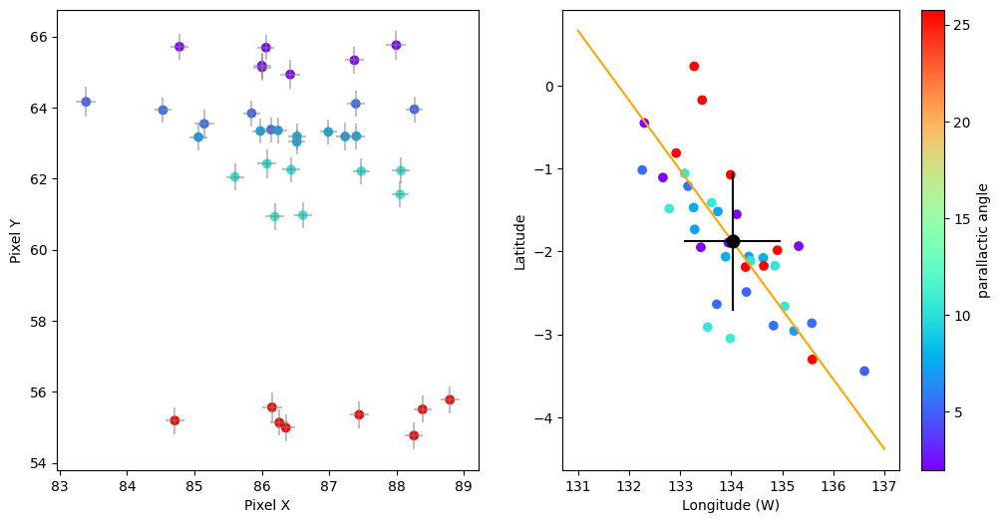

Longitude (W): 134.0 +/- 0.9 degrees
Latitude (N): -1.9 +/- 0.8 degrees
Pixel scale: 1.03 degrees per pixel


In [113]:
colors = np.copy(lucky_angles)
#colors[lucky_angles > 10] = lucky_angles[lucky_angles > 10] - 16

fig, (ax1, ax0) = plt.subplots(1,2, figsize = (12, 6))

ax0.errorbar(np.mean(emakong_lon), np.mean(emakong_lat), xerr=np.std(emakong_lon), yerr=np.std(emakong_lat), 
             color = 'k', marker = '.', markersize=18)
sc = ax0.scatter(emakong_lon, emakong_lat, c=colors, cmap = 'rainbow')
#ax0.plot(lon_grid, linfit, color = 'yellow')
ax0.plot(lon_grid, linfit_2, color = 'orange')
ax0.set_xlabel('Longitude (W)')
ax0.set_ylabel('Latitude')

ax1.scatter(np.array(emakong_x)/z, np.array(emakong_y)/z,c=colors, cmap = 'rainbow')
ax1.errorbar(np.array(emakong_x)/z, np.array(emakong_y)/z, 
             xerr=np.array(emakong_xsig)/z, 
             yerr=np.array(emakong_ysig)/z,
            color='gray', linestyle='', alpha=0.5) 
ax1.set_xlabel('Pixel X')
ax1.set_ylabel('Pixel Y')

plt.colorbar(sc, label='parallactic angle')
fig.savefig('diagnostic_plots/update_061523/emakong_location.png', dpi=300)
plt.show()

print(f'Longitude (W): {np.nanmean(emakong_lon):.1f} +/- {np.nanstd(emakong_lon):.1f} degrees')
print(f'Latitude (N): {np.nanmean(emakong_lat):.1f} +/- {np.nanstd(emakong_lat):.1f} degrees')
deg_per_px = nav.deg_per_px*z
print(f'Pixel scale: {deg_per_px:.2f} degrees per pixel')

out = np.array([emakong_lon, emakong_lat])
np.save(paths.data / 'latlon_combined-disk-solution.npy', out)

Standard deviation in Y residual = 0.45 degrees
Average single-fit error in Y direction = 0.38 degrees
Standard deviation in X residual = 0.90 degrees
Average single-fit error in X direction = 0.14 degrees


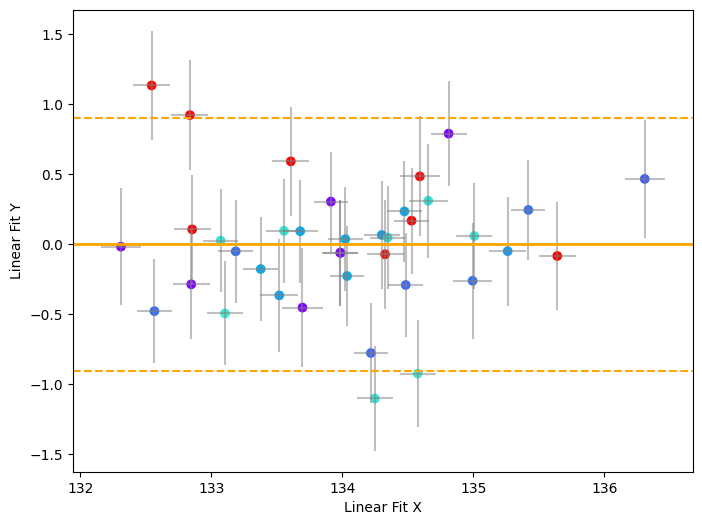

In [114]:
points = np.array([emakong_lon,emakong_lat])
resid_y = distance(points, B)
resid_x = intersection_x(points, B)
i_y = intersection_y(points, B)

resid_yerr = np.std(resid_y)
resid_xerr = np.std(resid_x)
ysig_resid = (np.array(emakong_ysig)/z)*deg_per_px
xsig_resid = (np.array(emakong_xsig)/z)*deg_per_px
print(f'Standard deviation in Y residual = {resid_yerr:.2f} degrees')
print(f'Average single-fit error in Y direction = {np.mean(ysig_resid):.2f} degrees')
print(f'Standard deviation in X residual = {resid_xerr:.2f} degrees')
print(f'Average single-fit error in X direction = {np.mean(xsig_resid):.2f} degrees')

fig, ax = plt.subplots(1,1, figsize = (8,6))
ax.scatter(resid_x, resid_y,  
            marker='o', c=colors, cmap='rainbow')
ax.errorbar(resid_x, resid_y, 
            yerr = ysig_resid, 
            xerr = xsig_resid, 
            linestyle='', color='gray', alpha=0.5)
ax.axhline(0, linestyle='-', color = 'orange', linewidth = 2)
ax.axhline(-resid_xerr, linestyle='--', color = 'orange')
ax.axhline(resid_xerr, linestyle='--', color = 'orange')
ax.set_xlabel('Linear Fit X')
ax.set_ylabel('Linear Fit Y')
fig.savefig('diagnostic_plots/update_061523/emakong_location_realigned.png', dpi=300)
plt.show()

In [115]:
proj2, mu_proj2 = nav2.reproject()
proj3, mu_proj3 = nav3.reproject()

New image will be 1755 by 877 pixels
Pixel scale 6.531921 km = 4.869854 pixels per degree
New image will be 1755 by 877 pixels
Pixel scale 6.532026 km = 4.869775 pixels per degree


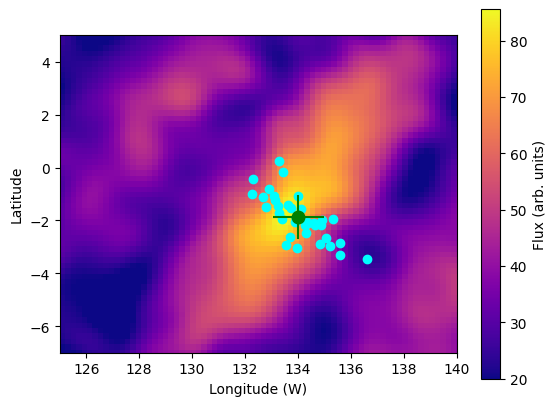

In [116]:
im = plt.imshow(proj3, origin = 'lower', extent=[0, 360, -90, 90], cmap='plasma', vmin = 20)
plt.colorbar(im, label='Flux (arb. units)')
plt.errorbar(np.mean(emakong_lon), np.mean(emakong_lat), xerr=np.std(emakong_lon), yerr=np.std(emakong_lat), 
             color = 'green', marker = '.', markersize=18)
plt.scatter(np.array(emakong_lon), np.array(emakong_lat), color = 'cyan')
plt.xlim([125, 140])
plt.ylim([-7, 5])
plt.xlabel('Longitude (W)')
plt.ylabel('Latitude')
plt.show()

Notes:

- The location of the centroid does not look far from the dead center in any of the individual frames
- Nevertheless, there is a few-pixel spread in x, y positions before translating to lon-lat space, even within a single nod
- There is no correlation of this spread with observation time within a single nod
- Therefore, the interferogram is itself shifting on the detector

# Fourier transforms 

Fourier transform the PSF and the images of Emakong to see if they are similar.  This might tell us if Emakong is point-source-like or not.

How do you find the uv distance?  We want to look at amp vs uvdist

/var/folders/g0/r491pzqx4kx0tfmpx8970ntm0000gn/T/ipykernel_98926/3173903464.py:51: RuntimeWarning: invalid value encountered in sqrt
  ax1.scatter(uvdist.flatten(), np.sqrt(amp2.flatten()), marker = '.', color = 'k')


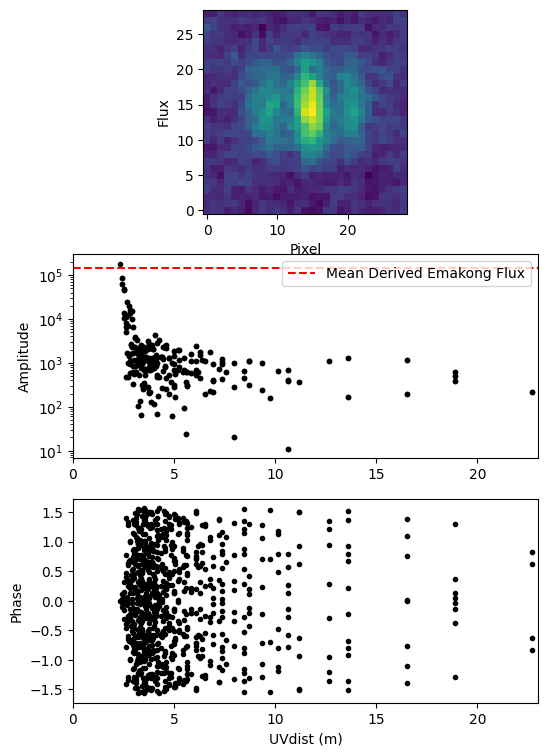

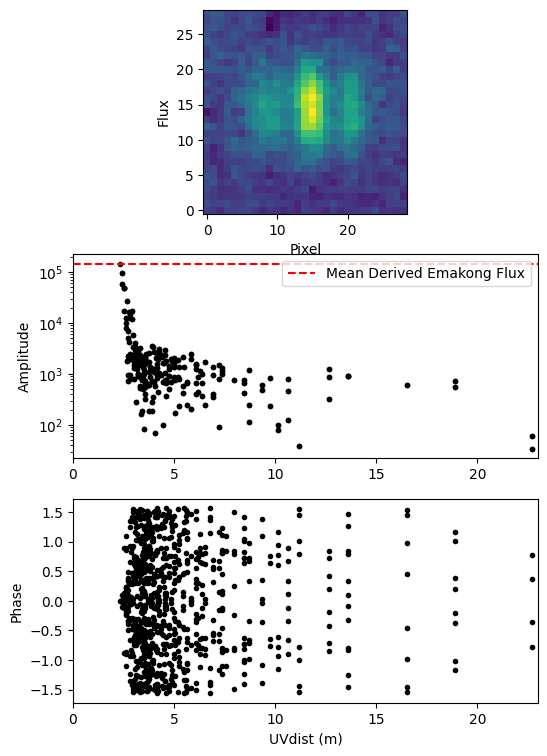

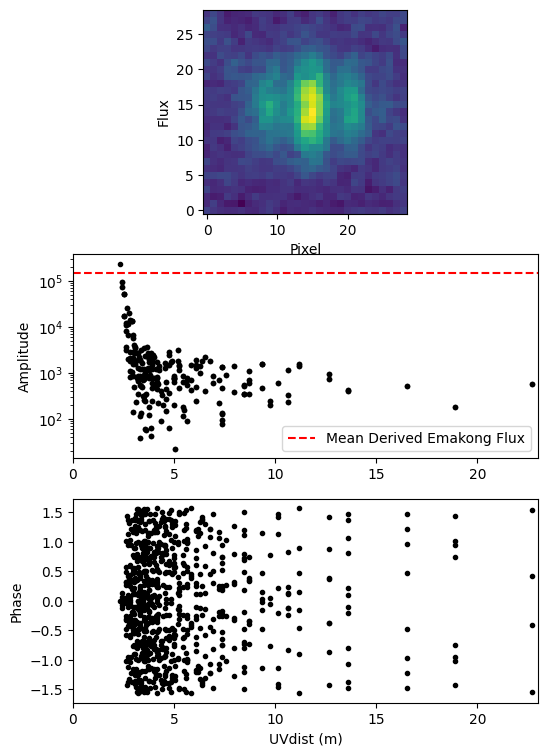

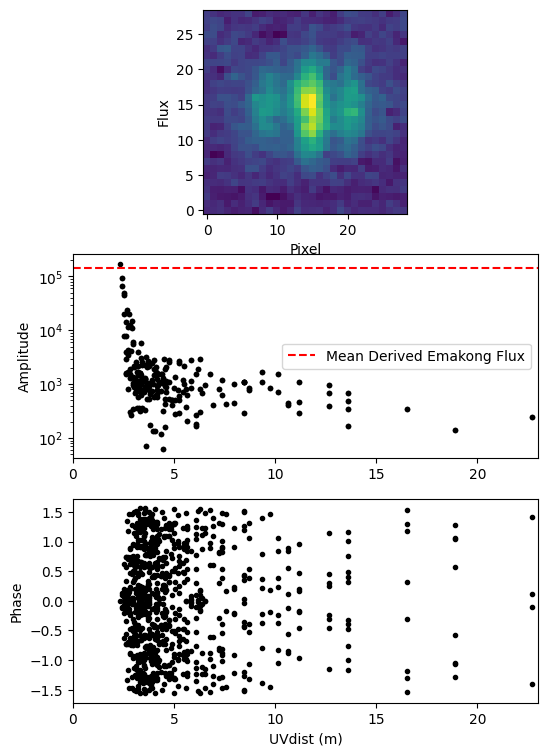

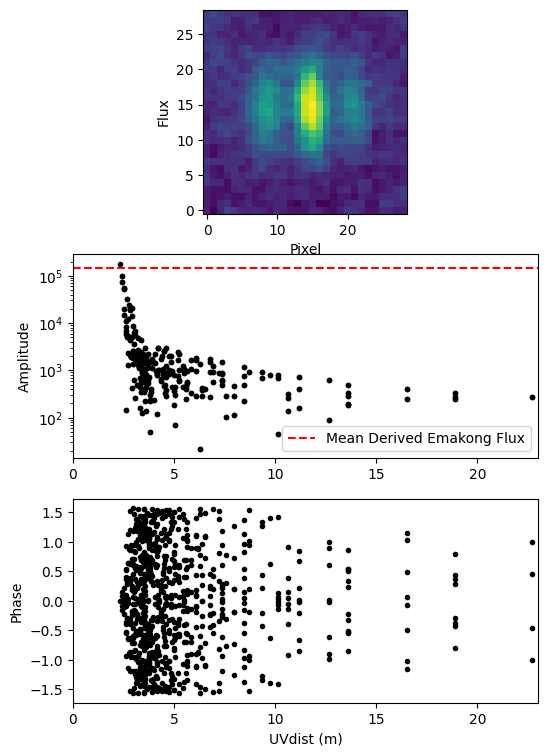

...

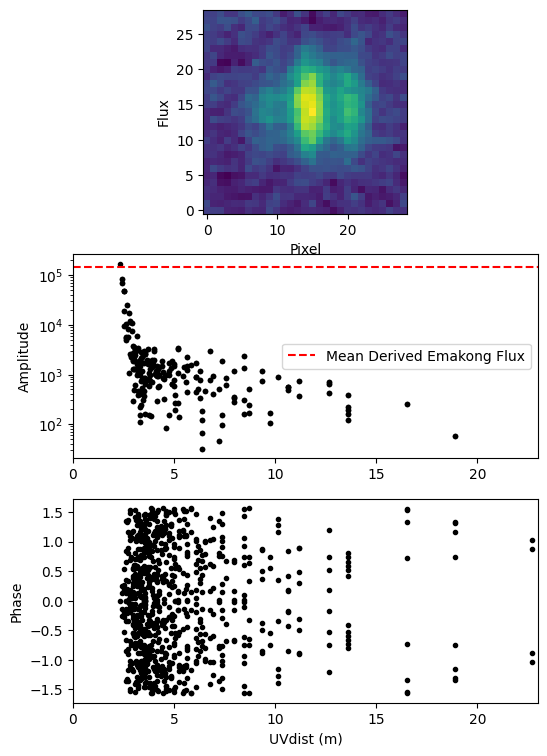

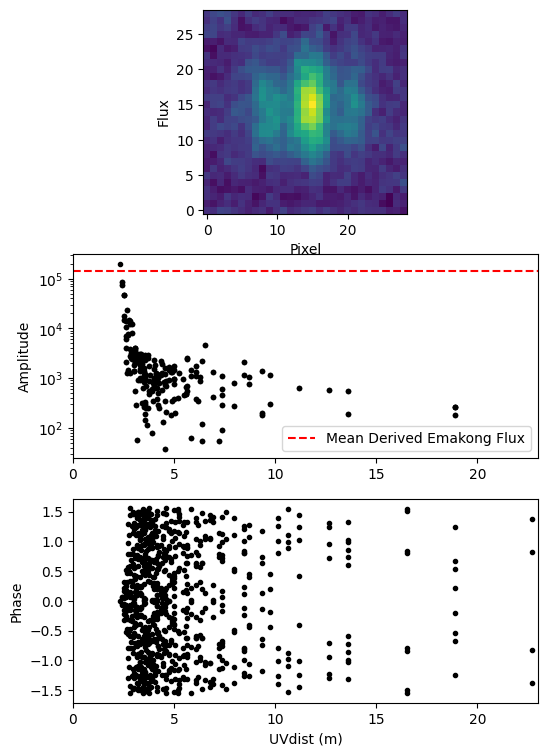

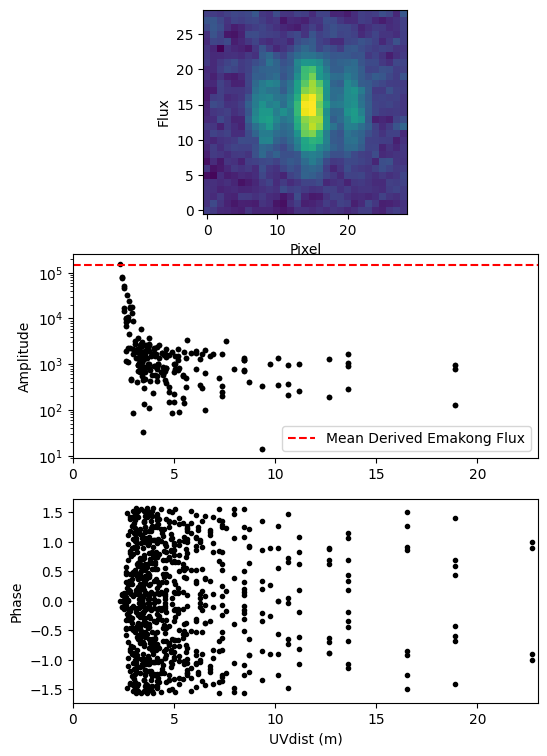

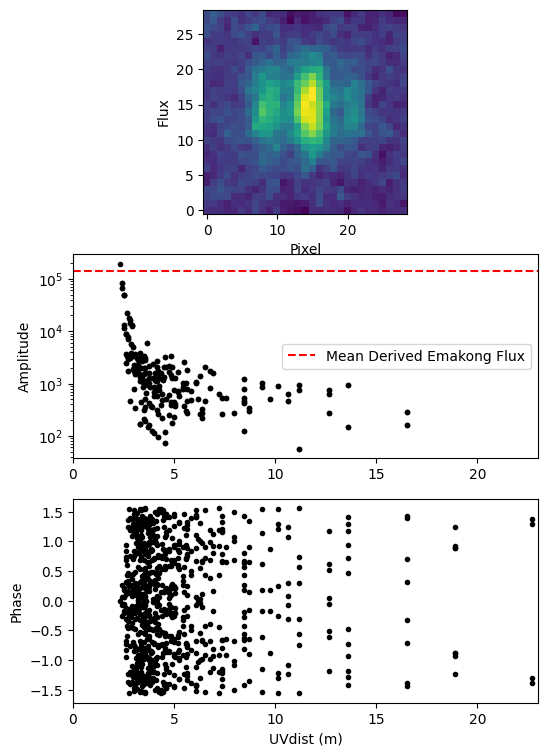

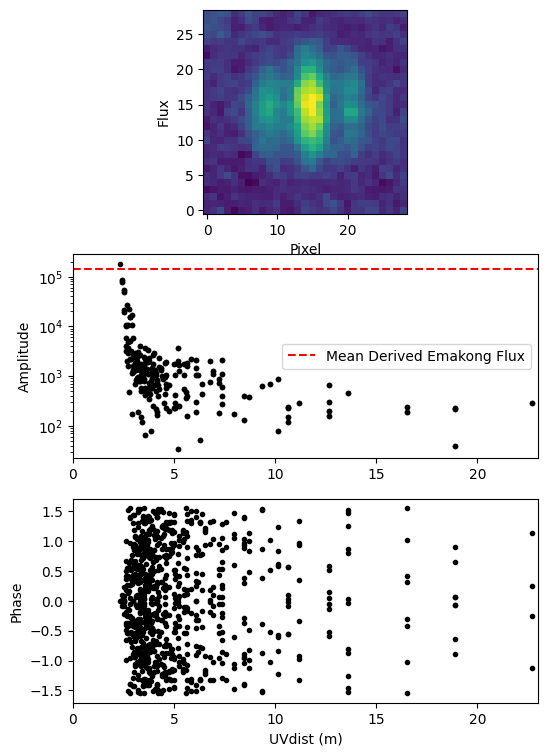

In [117]:
from scipy import fft
from matplotlib.colors import LogNorm

def to_visibilities(data):
    
    transform = fft.fftn(data)
    amp2 = transform.real**2 - transform.imag**2
    phase = np.arctan(transform.imag / transform.real)
    return amp2, phase


def calc_uvdist(data, pixscale_arcsec, wl_obs):
    '''
    wl_obs in meters to get uvdist in meters
    '''
    
    x,y = (data.shape[0]/2, data.shape[1]/2)
    xx, yy = np.mgrid[-x:x, -y:y]
    r = np.sqrt(xx**2 + yy**2)
    theta = np.deg2rad(pixscale_arcsec/3600)
    
    uvdist = (0.5 * wl_obs) / (r*theta)
    return uvdist
    

meanflux = np.mean(np.array(emakong_flux))
stdflux = np.std(np.array(emakong_flux))
sz = 29*z
cutouts = []
for i, frame in enumerate(disksub_data):
    
    # excise the region around the max-likelihood x, y position for each frame
    ctr = (emakong_y[i], emakong_x[i])
    cutout = frame[int(ctr[0]-sz/2):int(ctr[0]+sz/2), int(ctr[1]-sz/2):int(ctr[1]+sz/2)]
    cutout = rebin(cutout, 1/z)
    cutouts.append(cutout)
    
    amp2, phase = to_visibilities(cutout)
    uvdist = calc_uvdist(cutout, pixscale_arcsec, 5.0e-6)
    #print(np.sort(uvdist.flatten())[:-10])
    #plt.imshow(uvdist, origin='lower')
    #plt.show()

    fig, (ax0, ax1, ax2) = plt.subplots(3,1, figsize = (6, 9))
    
    ax0.imshow(cutout, origin = 'lower')
    #ax0.axvline(sz/2 + 1, linestyle=':', color = 'k')
    ax0.set_xlabel('Pixel')
    ax0.set_ylabel('Flux')
    
    ax1.scatter(uvdist.flatten(), np.sqrt(amp2.flatten()), marker = '.', color = 'k')
    ax1.axhline(meanflux, color = 'red', linestyle = '--', label = 'Mean Derived Emakong Flux')
    ax1.set_ylabel('Amplitude')
    ax1.set_yscale('log')
    ax1.legend()
    
    ax2.scatter(uvdist.flatten(), phase.flatten(), marker = '.', color = 'k')
    ax2.set_ylabel('Phase')
    ax2.set_xlabel('UVdist (m)')
    
    for ax in [ax1, ax2]:
        ax.set_xlim([0,23])

    if i < 3:
        fig.savefig(f'diagnostic_plots/update_061523/emakong_ft_{i}.png', dpi=300)
    plt.show()

## Average shape of Emakong

Using the Astropy PSF maker tool with a workflow similar to what we did to construct a PSF, we can make an average Emakong feature despite the fact that it moves across the frame. This will give us higher SNR to see if it is resolved or not

In [118]:
from photutils.detection import find_peaks
from photutils.psf import EPSFBuilder
from photutils.psf import extract_stars
from astropy.nddata import NDData
from astropy.table import Table

In [119]:
cutouts_nddata = [NDData(frame) for frame in cutouts]
thresh = np.nanmax(np.array(cutouts)) / 1.7
peak_pix = [find_peaks(frame, threshold=thresh)[0] for frame in cutouts]
test_peak = peak_pix[0]
stars_tbl = [Table([[peaktab['x_peak']], [peaktab['y_peak']]], names=('x', 'y')) for peaktab in peak_pix]
stars = extract_stars(cutouts_nddata, stars_tbl, size=(23, 23))

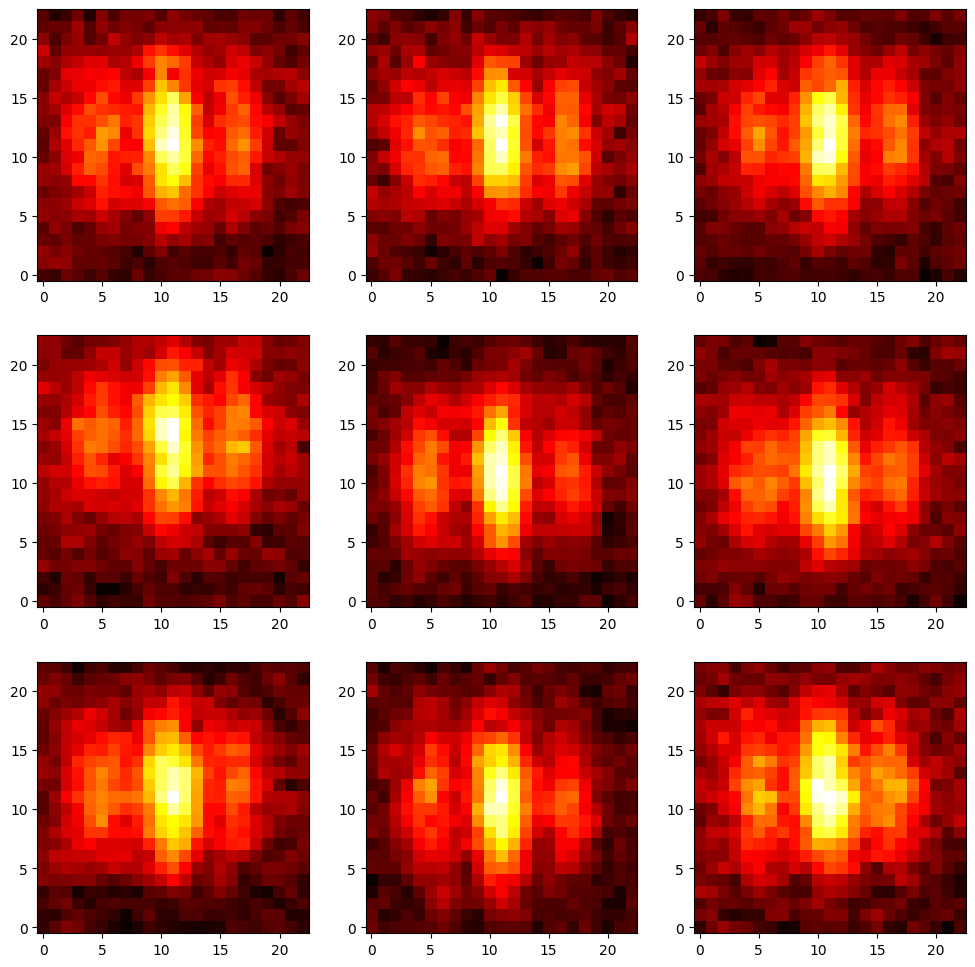

In [120]:
fig, ax = plt.subplots(3,3, figsize=(12, 12), squeeze=True)
ax = ax.ravel()
for i in range(9): #range(psf_frames.shape[0]):
    ax[i].imshow(stars[i], origin='lower', cmap='hot')
plt.savefig('diagnostic_plots/update_061523/emakong_frames.png', dpi=300)
plt.show()

In [121]:
epsf_builder = EPSFBuilder(oversampling=1, maxiters=5, progress_bar=False)  
emakong_epsf, fitted_stars = epsf_builder(stars)

In [122]:
#print(fitted_stars.center_flat)
#print(fitted_stars.cutout_center_flat)
## find uncertainty via the standard deviation of fitted_stars
## the centers are not the same for all of the cutouts!
## need to shift them relative to one another for this to work
## this is achieved using an FFTshift like what is done in shift_stack_moons

# center all the frames relative to one another
from image_registration.fft_tools.shift import shift2d
from scipy.ndimage import center_of_mass
ctr_new = (11.5, 11.5)
fitted_shifted = np.empty(np.array(fitted_stars.data).shape)
for i, frame in enumerate(fitted_stars.data):
    ctr_old = fitted_stars.cutout_center_flat[i]
    (dx, dy) = ctr_new - ctr_old
    shifted = shift2d(frame, dx, dy)
    fitted_shifted[i] = shifted

#re-normalize so they all sum to unity. this way, they contribute equally to sigma    
fitted_stars_renorm = fitted_shifted / (np.sum(np.sum(fitted_shifted, axis = 1), axis=1))[:,np.newaxis,np.newaxis]
#print(np.sum(fitted_stars_renorm)/fitted_stars_renorm.shape[0])

#compute fractional error
sigma_map = np.std(fitted_stars_renorm, axis=0) / np.mean(fitted_stars_renorm, axis=0)
sigma_map = np.pad(sigma_map, 1)
sigma_map_plot = np.copy(sigma_map)
sigma_map *= emakong_epsf.data #re-normalize to the Emakong psf for later
sigma_map_plot[sigma_map_plot > 0.5] = 0.0 #shaving off noise spikes near zero mean flux

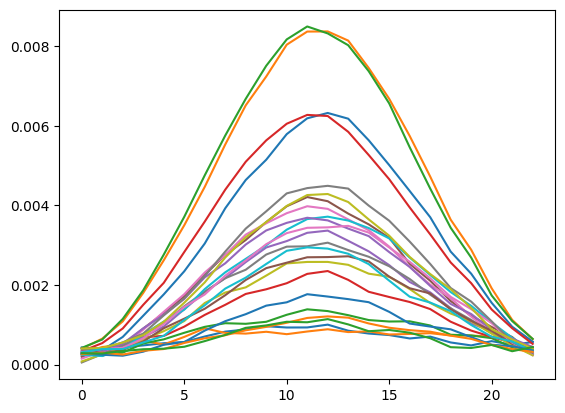

In [123]:
i0, i1 = 10, 13
emak_cut = np.mean(emakong_epsf.data[i0:i1,:], axis = 0)
emak_cut_std = np.mean(sigma_map[i0:i1,:], axis = 0)
psf_cut = np.mean(epsf.data[i0:i1,:], axis = 0)

plt.plot(np.mean(fitted_stars_renorm, axis=0))
plt.show()

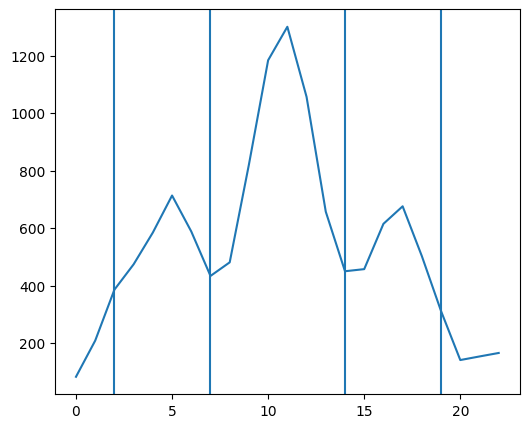

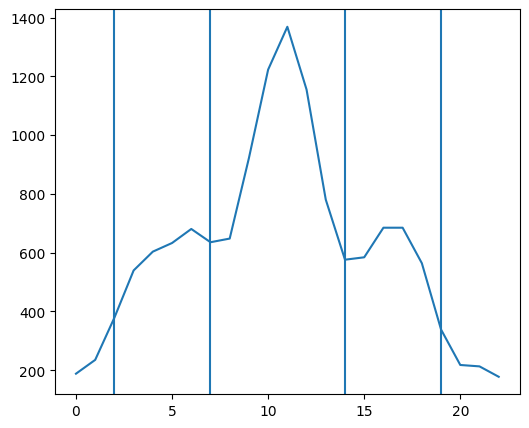

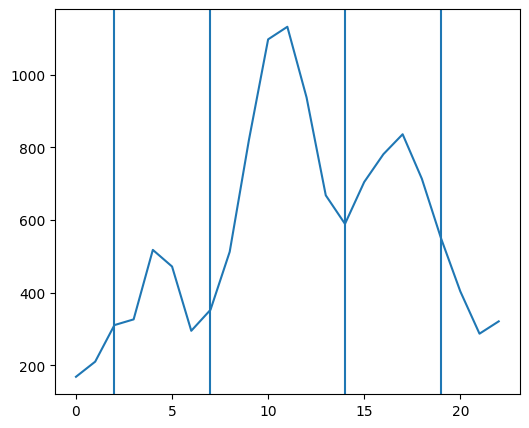

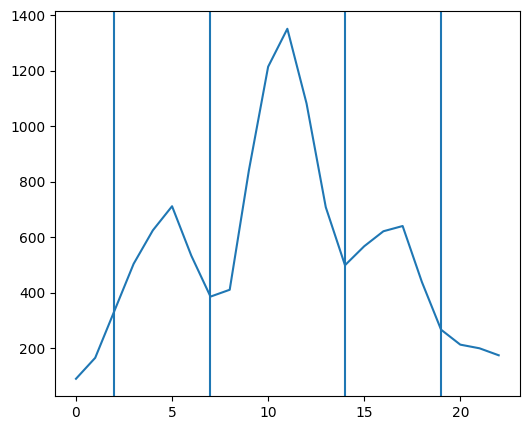

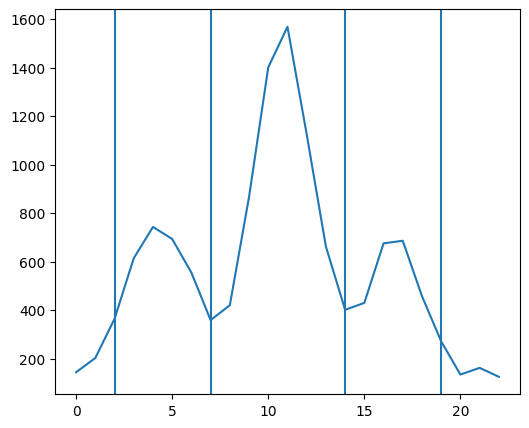

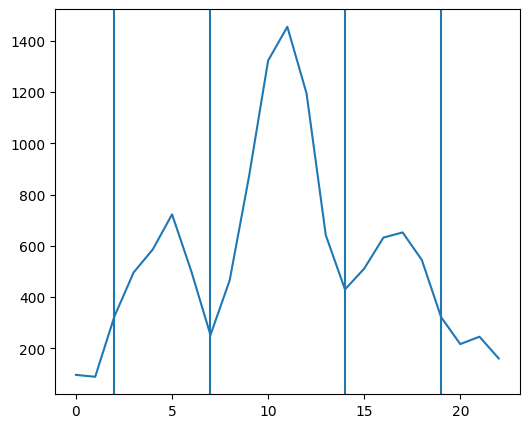

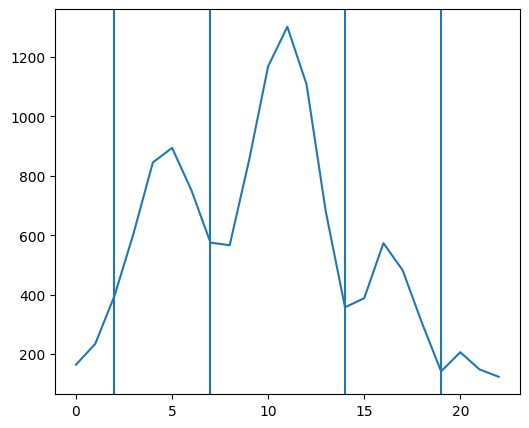

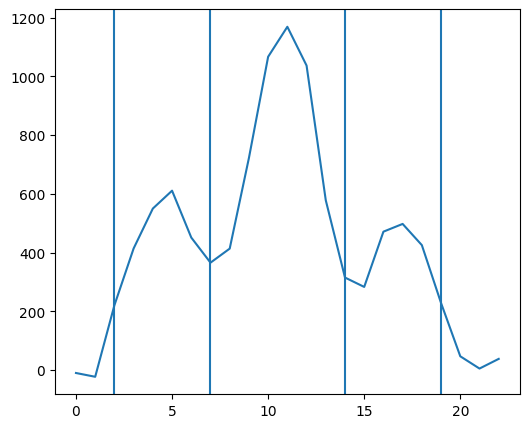

In [124]:
# extract the relative brightness of the left and right fringe
fringe_ratios = []
for i, frame in enumerate(fitted_stars.data):
    
    cut = np.mean(frame[i0:i1, :], axis = 0)
    if i % 5 == 0:
        fig, ax = plt.subplots(1,1, figsize = (6,5))
        ax.plot(cut)
        ax.axvline(2)
        ax.axvline(7)
        ax.axvline(14)
        ax.axvline(19)
        plt.show()
    left = np.sum(cut[2:8])
    right = np.sum(cut[14:20])
    fringe_ratios.append(right/left)

(38,) (38,)
Linear regression m, b = 0.17, -21.03
Linear regression p = 0.00095
Null hypothesis rejected; there is definitely a correlation


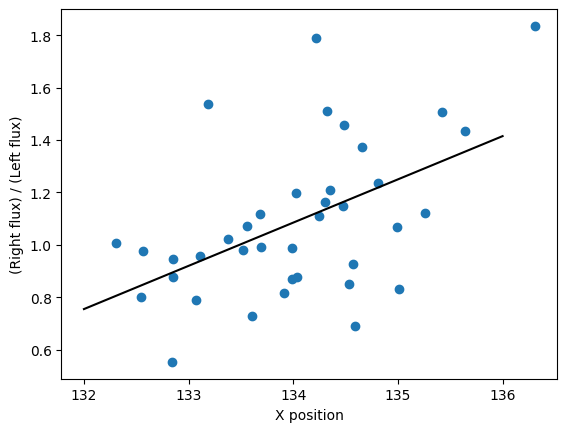

In [125]:
# typical linear regression
print(np.array(resid_x).shape, np.array(fringe_ratios).shape)
slope, intercept, r, p, se = linregress(resid_x, fringe_ratios)
lon_grid = np.linspace(132, 136, 100)
linfit = slope*lon_grid + intercept
print(f'Linear regression m, b = {slope:.2f}, {intercept:.2f}')
print(f'Linear regression p = {p:.5f}')
print('Null hypothesis rejected; there is definitely a correlation')

plt.scatter(resid_x, fringe_ratios)
plt.plot(lon_grid, linfit, color = 'k', label='linear regression')
plt.ylabel('(Right flux) / (Left flux)')
plt.xlabel('X position')
plt.show()

/var/folders/g0/r491pzqx4kx0tfmpx8970ntm0000gn/T/ipykernel_98926/3716988455.py:3: RuntimeWarning: invalid value encountered in divide
  relative_err = emak_cut_std / emak_cut


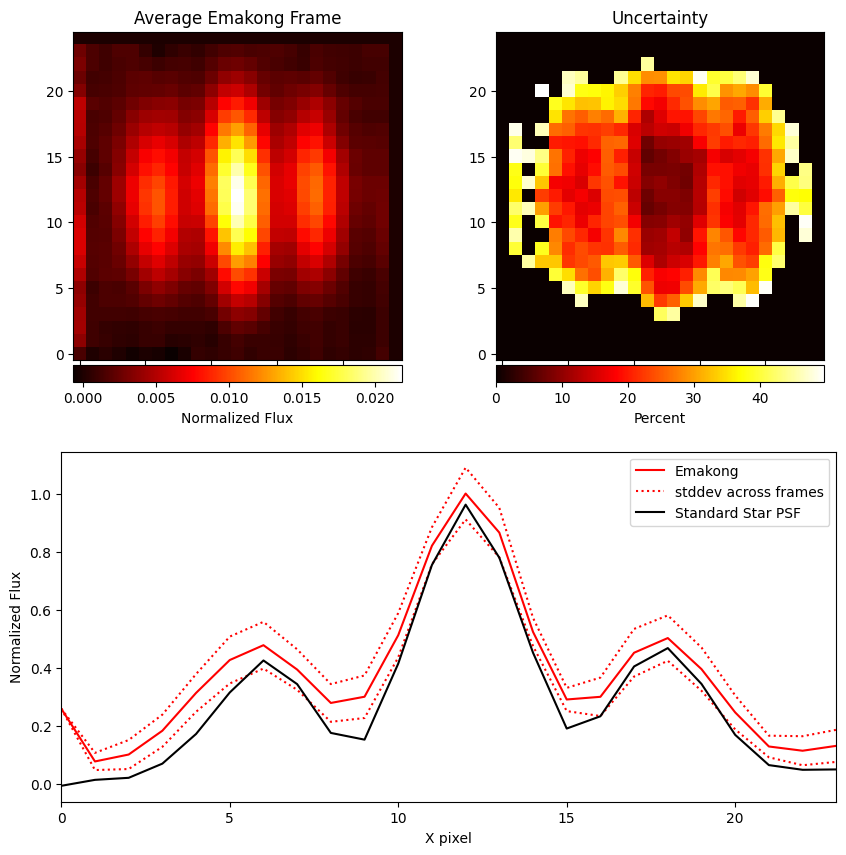

In [126]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

relative_err = emak_cut_std / emak_cut
emak_cut /= np.max(emak_cut)
emak_cut_std = relative_err * emak_cut 

fig, axd = plt.subplot_mosaic([['upper left', 'upper right'],
                               ['lower', 'lower']],
                              figsize=(10, 10))

[ax0, ax1, ax2] = [axd[k] for k in axd]

plotdata = [emakong_epsf.data, sigma_map_plot*100]
labels = ['Normalized Flux', 'Percent']
for i, ax in enumerate([ax0, ax1]):
    cim = ax.imshow(plotdata[i], origin='lower', cmap='hot')
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('bottom', size='5%', pad=0.05)

    fig.colorbar(cim, cax=cax, orientation='horizontal', label=labels[i])

ax0.set_title('Average Emakong Frame')
ax1.set_title('Uncertainty')

ax2.plot(emak_cut, color = 'red', label = 'Emakong')
ax2.plot(emak_cut - emak_cut_std, color = 'red', linestyle = ':', label='stddev across frames')
ax2.plot(emak_cut + emak_cut_std, color = 'red', linestyle = ':')
ax2.plot(psf_cut, color = 'k', label = 'Standard Star PSF')
ax2.set_xlim([0,23])
ax2.set_xlabel('X pixel')
ax2.set_ylabel('Normalized Flux')
ax2.legend()

fig.savefig('diagnostic_plots/update_061523/emakong_psf_cut_compare.png', dpi=300)
plt.show()

# save the important data for figure lbti-psf-compare-figure.py
np.save(paths.data / 'lbti' / 'emakong_1d_cut.npy', np.array(emak_cut))
np.save(paths.data / 'lbti' / 'emakong_1d_cut_std.npy', np.array(emak_cut_std))
np.save(paths.data / 'lbti' / 'psf_1d_cut.npy', np.array(psf_cut))

The uncertainties are simply the standard deviation of fitted_stars. fitted_stars are the input stars with updated centers and fluxes derived from fitting the output epsf using EPSFBuilder.